<a href="https://colab.research.google.com/github/Ka275578/Netflix-Movies-and-TV-Shows-Clustering/blob/main/NETFLIX_MOVIES_AND_TV_SHOWS_CLUSTERING_final_commit.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Project Name**    - Netflix Movies and TV Shows Clustering

##### **Project Type**    - Unsupervised ML - Clustering
##### **Contribution**    - Individual
##### **Name** - Kumar Anand
##### **email** - ka275578@gmail.com 

# **Project Summary -**

The dataset consists of TV Shows and Movies available on Netflix as of 2019.

The dataset consists of 7787 rows and 12 columns.

In this project we have implemented Unsupervised ML - Clustering technique to group the data into several clusters through K Means clustering and Hierarchical Clustering. 
Through K Means Clustering using Silhoette method we got the number of clusters as 9 and through Hierarchical clustering we got the number of clusters as 11 by visualizing the dendogram.

Below figure shows the clusters made - 

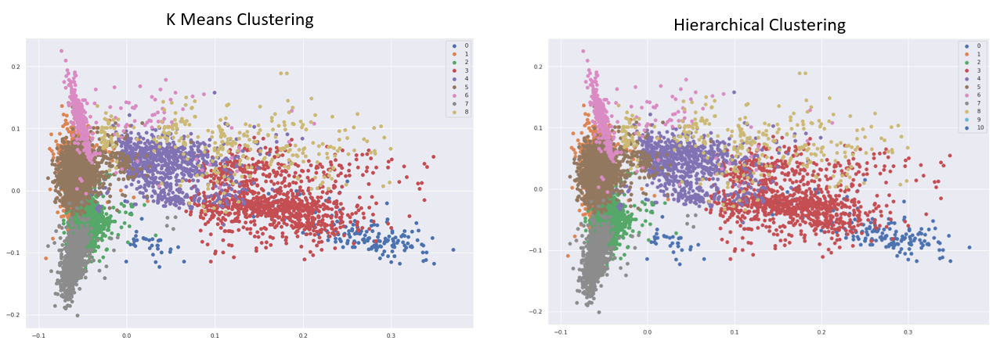



# **GitHub Link -**

https://github.com/Ka275578/Netflix-Movies-and-TV-Shows-Clustering

# **Problem Statement**

Netflix is the world's largest online streaming service provider. Being such a huge company it is crucial that they effectively cluster the shows that are hosted on their platform in order to enhance the user experience.

The goal of this project is to classify/group the Netflix shows into certain clusters such that the shows within a cluster are similar to each other and the shows in different clusters are dissimilar to each other.

This dataset consists of tv shows and movies available on Netflix as of 2019. The dataset is collected from Flixable which is a third-party Netflix search engine.

In 2018, they released an interesting report which shows that the number of TV shows on Netflix has nearly tripled since 2010. The streaming service’s number of movies has decreased by more than 2,000 titles since 2010, while its number of TV shows has nearly tripled. It will be interesting to explore what all other insights can be obtained from the same dataset.

Integrating this dataset with other external datasets such as IMDB ratings, rotten tomatoes can also provide many interesting findings.

## <b>In this  project, you are required to do </b>
1. Exploratory Data Analysis 

2. Understanding what type content is available in different countries

3. Is Netflix has increasingly focusing on TV rather than movies in recent years?
4. Clustering similar content by matching text-based features

# **General Guidelines** : -  

1.   Well-structured, formatted, and commented code is required. 
2.   Exception Handling, Production Grade Code & Deployment Ready Code will be a plus. Those students will be awarded some additional credits. 
     
     The additional credits will have advantages over other students during Star Student selection.
       
             [ Note: - Deployment Ready Code is defined as, the whole .ipynb notebook should be executable in one go
                       without a single error logged. ]

3.   Each and every logic should have proper comments.
4. You may add as many number of charts you want. Make Sure for each and every chart the following format should be answered.
        

```
# Chart visualization code
```
            

*   Why did you pick the specific chart?
*   What is/are the insight(s) found from the chart?
* Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

5. You have to create at least 15 logical & meaningful charts having important insights.


[ Hints : - Do the Vizualization in  a structured way while following "UBM" Rule. 

U - Univariate Analysis,

B - Bivariate Analysis (Numerical - Categorical, Numerical - Numerical, Categorical - Categorical)

M - Multivariate Analysis
 ]





6. You may add more ml algorithms for model creation. Make sure for each and every algorithm, the following format should be answered.


*   Explain the ML Model used and it's performance using Evaluation metric Score Chart.


*   Cross- Validation & Hyperparameter Tuning

*   Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

*   Explain each evaluation metric's indication towards business and the business impact pf the ML model used.

# ***Let's Begin !***

## ***1. Know Your Data***

### Import Libraries

In [ ]:
import numpy as np
import pandas as pd
from numpy import math
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import drive
from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import plotly.graph_objects as map
import re, string, unicodedata
import nltk
from nltk import word_tokenize, sent_tokenize
from nltk.stem import LancasterStemmer, WordNetLemmatizer
nltk.download('wordnet')
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
import string
string.punctuation
nltk.download('omw-1.4')
from nltk.tokenize import TweetTokenizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as shc
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


### Dataset Loading

In [ ]:
drive.mount('/content/mydrive')

Drive already mounted at /content/mydrive; to attempt to forcibly remount, call drive.mount("/content/mydrive", force_remount=True).


In [ ]:
nf_path = '/content/mydrive/MyDrive/NETFLIX_MOVIES AND_TV SHOWS_CLUSTERING/NETFLIX MOVIES AND TV SHOWS CLUSTERING.csv'
nf_df_org = pd.read_csv(nf_path)

### Dataset First View

In [ ]:
#Copying the original data into a seperate dataset for processing.
nf_df = nf_df_org.copy()

#Let's look at the dataset
nf_df.head()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
0,s1,TV Show,3%,NaN,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,"August 14, 2020",2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...
1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,"December 23, 2016",2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...
2,s3,Movie,23:59,Gilbert Chan,"Tedd Chan, Stella Chung, Henley Hii, Lawrence ...",Singapore,"December 20, 2018",2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow..."
3,s4,Movie,9,Shane Acker,"Elijah Wood, John C. Reilly, Jennifer Connelly...",United States,"November 16, 2017",2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi..."
4,s5,Movie,21,Robert Luketic,"Jim Sturgess, Kevin Spacey, Kate Bosworth, Aar...",United States,"January 1, 2020",2008,PG-13,123 min,Dramas,A brilliant group of students become card-coun...


### Dataset Rows & Columns count

In [ ]:
nf_df.shape

(7787, 12)

There are 7787 rows and 12 features/columns in the dataset. Let's explore information of dataset.

### Dataset Information

In [ ]:
#Checking the info of the dataset
nf_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7787 entries, 0 to 7786
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   show_id       7787 non-null   object
 1   type          7787 non-null   object
 2   title         7787 non-null   object
 3   director      5398 non-null   object
 4   cast          7069 non-null   object
 5   country       7280 non-null   object
 6   date_added    7777 non-null   object
 7   release_year  7787 non-null   int64 
 8   rating        7780 non-null   object
 9   duration      7787 non-null   object
 10  listed_in     7787 non-null   object
 11  description   7787 non-null   object
dtypes: int64(1), object(11)
memory usage: 730.2+ KB


#### Duplicate Values

In [ ]:
#Checking the unique values in the dataset
nf_df.nunique()

show_id         7787
type               2
title           7787
director        4049
cast            6831
country          681
date_added      1565
release_year      73
rating            14
duration         216
listed_in        492
description     7769
dtype: int64

There are 7787 unique entries in the show_id which is same as the number of rows of the dataset. So, we can infer that there are no duplicate entries in the dataset. The below code also confirms this.

In [ ]:
#Confirming if any duplicate value present
nf_df.duplicated().value_counts()

False    7787
dtype: int64

#### Missing Values/Null Values

In [ ]:
#checking for null values
nf_df.isnull().sum()

show_id            0
type               0
title              0
director        2389
cast             718
country          507
date_added        10
release_year       0
rating             7
duration           0
listed_in          0
description        0
dtype: int64

There are some null values in director, cast, country, date_added & rating. Let's visuallize these in percentage.

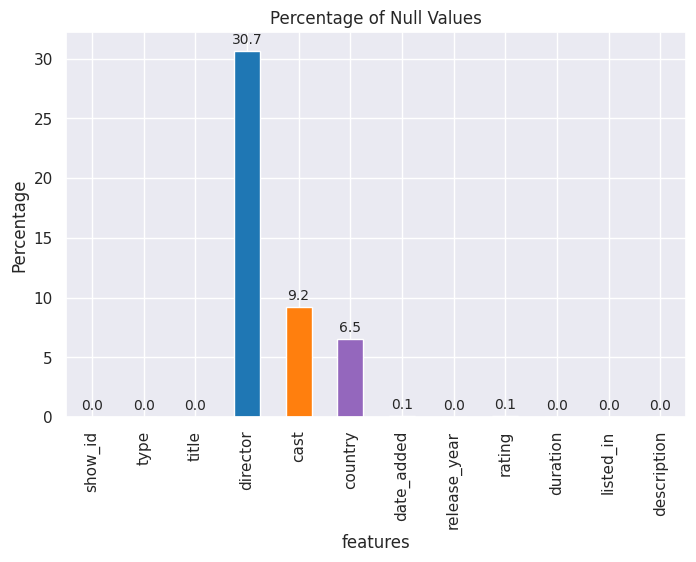

In [ ]:
# Visualizing the missing values
plt.figure(figsize = (8,5))
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#1f77b4', '#ff7f0e', '#9467bd','#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']
plots = (nf_df.isnull().sum()/len(nf_df)*100).plot(kind = "bar", title = "Percentage of Null Values", color = colors) 
for bar in plots.patches:
    plots.annotate(format(bar.get_height(), '.1f'), (bar.get_x() + bar.get_width() / 2,
                    bar.get_height()), ha='center', va='center',
                   size=10, xytext=(0, 8),
                   textcoords='offset points')
plt.xlabel("features")
plt.ylabel("Percentage")
plt.show()

### Initial insights on the dataset -

This dataset consists of tv shows and movies available on Netflix as of 2019.

The dataset contains 7787 rows/observations and 12 columns/features.
There are no duplicate values in the dataset. 

director has 2389 null values, cast has 718 null values, country has 507 null values, date_added has 10 null values and rating has 7 null values.

release_year is of int dtype and other features are of object dtype.

We will be dealing with null values and dtypes in later sections of the project.

## ***2. Understanding Your Variables***

In [ ]:
#Columns in the dataset
nf_df.columns

Index(['show_id', 'type', 'title', 'director', 'cast', 'country', 'date_added',
       'release_year', 'rating', 'duration', 'listed_in', 'description'],
      dtype='object')

Here all are independent variable. There is no target or dependent variable which makes this a problem of Unsupervised Machine Learning. 

### Variables Description 

1. show_id : Unique ID for every Movie / Tv Show

2. type : Identifier - A Movie or TV Show

3. title : Title of the Movie / Tv Show

4. director : Director of the Movie

5. cast : Actors involved in the movie / show

6. country : Country where the movie / show was produced

7. date_added : Date it was added on Netflix

8. release_year : Actual Releaseyear of the movie / show

9. rating : TV Rating of the movie / show

10. duration : Total Duration - in minutes or number of seasons

11. listed_in : Genere

12. description: The Summary description

In [ ]:
#datatypes of each features
nf_df.dtypes

show_id         object
type            object
title           object
director        object
cast            object
country         object
date_added      object
release_year     int64
rating          object
duration        object
listed_in       object
description     object
dtype: object

In [ ]:
#description of the dataset
nf_df.describe(include='all')

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
count,7787,7787,7787,5398,7069,7280,7777,7787.000000,7780,7787,7787,7787
unique,7787,2,7787,4049,6831,681,1565,NaN,14,216,492,7769
top,s1,Movie,3%,"Raúl Campos, Jan Suter",David Attenborough,United States,"January 1, 2020",NaN,TV-MA,1 Season,Documentaries,Multiple women report their husbands as missin...
freq,1,5377,1,18,18,2555,118,NaN,2863,1608,334,3
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2013.932580,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.757395,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1925.000000,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2013.000000,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017.000000,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2018.000000,NaN,NaN,NaN,NaN


## 3. ***Data Wrangling***

### Handling Missing Values

* We are replacing the missing values in the director, cast, and country attributes with 'Unknown'
* 10 records with missing values in the date_added column can be dropped.
* The missing values in rating can be imputed with its mode, since this attribute is discrete.

In [ ]:
#handling null values
nf_df[['director','cast','country']] = nf_df[['director','cast','country']].fillna('Unknown')
nf_df['rating'] = nf_df['rating'].fillna(nf_df['rating'].mode()[0])
nf_df.dropna(axis=0, inplace = True)

In [ ]:
#Resetting the index
nf_df.reset_index(inplace = True)

In [ ]:
nf_df.isnull().sum()

index           0
show_id         0
type            0
title           0
director        0
cast            0
country         0
date_added      0
release_year    0
rating          0
duration        0
listed_in       0
description     0
dtype: int64

All the null data have been handled successfully.

### Typecasting "date_added" from object to datetime

In [ ]:
#Changing the dtype of date added from object to datetime
nf_df['date_added'] = pd.to_datetime(nf_df['date_added'])

In [ ]:
#Checking when the first show/movie was added in Netflix
nf_df['date_added'].min()

Timestamp('2008-01-01 00:00:00')

In [ ]:
#Checking when last show/movie was added in Netflix
nf_df['date_added'].max()

Timestamp('2021-01-16 00:00:00')

First show/movie was added on "1st Jan 2008" and last show/movie was added on "16 Jan 2021".

In [ ]:
# Adding new attributes month and year of date added
nf_df['month_added'] = nf_df['date_added'].dt.month
nf_df['year_added'] = nf_df['date_added'].dt.year

#Dropping date_added column
nf_df.drop('date_added', axis = 1, inplace = True)

### Typecasting "duration" from object to datetime

In [ ]:
# Changing the duration columnn from object to int dtype. 
# Note - Here duration for Movies will be in mins and duration for TV Shows will be in seasons. While visualizing we will be visuallizing these two separately.

nf_df['duration'] = nf_df['duration'].apply(lambda x: int(x.split()[0]))

In [ ]:
#Head of the dataset after handling all the data
nf_df.head(10)

,index,show_id,type,title,director,cast,country,release_year,rating,duration,listed_in,description,month_added,year_added
0,0,s1,TV Show,3%,Unknown,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,2020,TV-MA,4,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...,8,2020
1,1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,2016,TV-MA,93,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...,12,2016
2,2,s3,Movie,23:59,Gilbert Chan,"Tedd Chan, Stella Chung, Henley Hii, Lawrence ...",Singapore,2011,R,78,"Horror Movies, International Movies","When an army recruit is found dead, his fellow...",12,2018
3,3,s4,Movie,9,Shane Acker,"Elijah Wood, John C. Reilly, Jennifer Connelly...",United States,2009,PG-13,80,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi...",11,2017
4,4,s5,Movie,21,Robert Luketic,"Jim Sturgess, Kevin Spacey, Kate Bosworth, Aar...",United States,2008,PG-13,123,Dramas,A brilliant group of students become card-coun...,1,2020
5,5,s6,TV Show,46,Serdar Akar,"Erdal Beşikçioğlu, Yasemin Allen, Melis Birkan...",Turkey,2016,TV-MA,1,"International TV Shows, TV Dramas, TV Mysteries",A genetics professor experiments with a treatm...,7,2017
6,6,s7,Movie,122,Yasir Al Yasiri,"Amina Khalil, Ahmed Dawood, Tarek Lotfy, Ahmed...",Egypt,2019,TV-MA,95,"Horror Movies, International Movies","After an awful accident, a couple admitted to ...",6,2020
7,7,s8,Movie,187,Kevin Reynolds,"Samuel L. Jackson, John Heard, Kelly Rowan, Cl...",United States,1997,R,119,Dramas,After one of his high school students attacks ...,11,2019
8,8,s9,Movie,706,Shravan Kumar,"Divya Dutta, Atul Kulkarni, Mohan Agashe, Anup...",India,2019,TV-14,118,"Horror Movies, International Movies","When a doctor goes missing, his psychiatrist w...",4,2019
9,9,s10,Movie,1920,Vikram Bhatt,"Rajneesh Duggal, Adah Sharma, Indraneil Sengup...",India,2008,TV-MA,143,"Horror Movies, International Movies, Thrillers",An architect and his wife move into a castle t...,12,2017


### Following are the insights of Data Wrangling section -

* All the null values have been filled and we have deleted 10 rows where date_added has null values.
* date_added has been changed from object dtype to datetime dtype. Then we extracted month and year from date_added and then we dropped date_added.
* In the dataset duration for Movies are in mins whereas duration for TV Shows are in terms of number of seasons.
* Feature duration also changed from object dtype to int. Here the units for Movies will be in mins whereas for TV Shows it will be in terms of number of seasons. 

## ***4. Data Vizualization, Storytelling & Experimenting with charts : Understand the relationships between variables***

#### Function to plot some basic graphs

In [ ]:
#Function to plot countplot
def count_plot(col, df, Order = None):
  '''This function plots the count plot for the passed feature
     Pass column name (str), Pandas DataFrame, Order (list of indexes) to plot the graph.'''
  plt.figure(figsize = (20,7))
  plt.title(f'count plot of {col}')
  sns.countplot(x = col, data = df, order = Order )
  plt.xticks(rotation = 90)
  plt.show()

countplot will be used for the better visuallization of the observational counts of the categorical variable. As it puts observational counts in different category-based bins using bars.

In [ ]:
#Function to plot Pie chart
def pie_chart(col):
  '''This function plot the pie chart for the given data.
  Pass the feature name in str to plot the pie chart.'''
  plt.rcParams['font.size'] = 12
  plt.figure(figsize = (20,7))
  exp = (0.05,)*len(nf_df[col].value_counts())
  nf_df[col].value_counts().plot.pie(autopct = '%1.2f%%' , explode = exp)
  plt.title(f'percentage distribution of {col}')
  plt.axis('off')
  plt.show()

Pie charts are very much useful in displaying relative proportions of multiple classes of data. 

In [ ]:
def col_word_cloud(col,w_df):
  ''' This function will show the WordCloud for the passed feature'''
  plt.figure(figsize = (12,7))
  text = " ".join(word for word in w_df[col])
  #Creating a list of stopwords
  stopwords = set(STOPWORDS)
  #Generating a word cloud image
  wordcloud = WordCloud(stopwords = stopwords, background_color = 'white').generate(text)
  #Display the generated image
  plt.imshow(wordcloud, interpolation = 'bilinear')
  plt.axis('off')
  plt.show()


WordClouds offer a visible picture of text data. 

### Univariate Analysis

We will explore each feature one by one and will try to explore some useful insights.

#### 1. 'type' Feature

In [ ]:
nf_df.type.value_counts()

Movie      5377
TV Show    2400
Name: type, dtype: int64

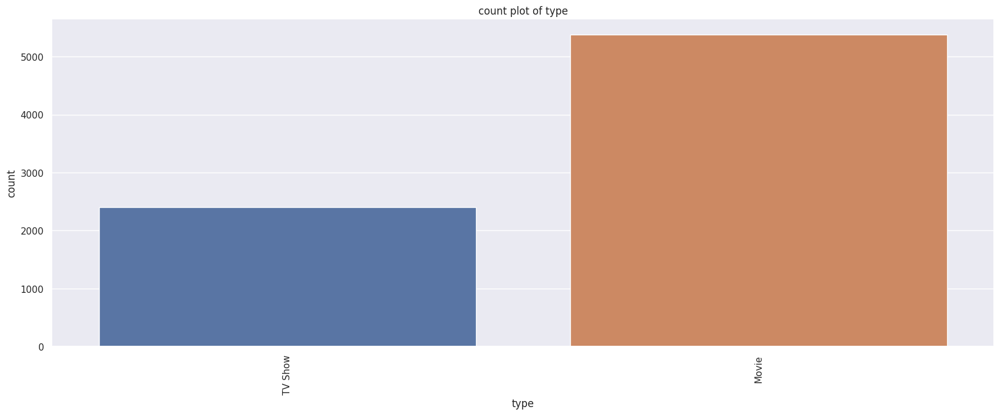

In [ ]:
#Plotting the countplot for 'type'
count_plot('type', nf_df)

In the dataset count of Movie is more than TV Shows

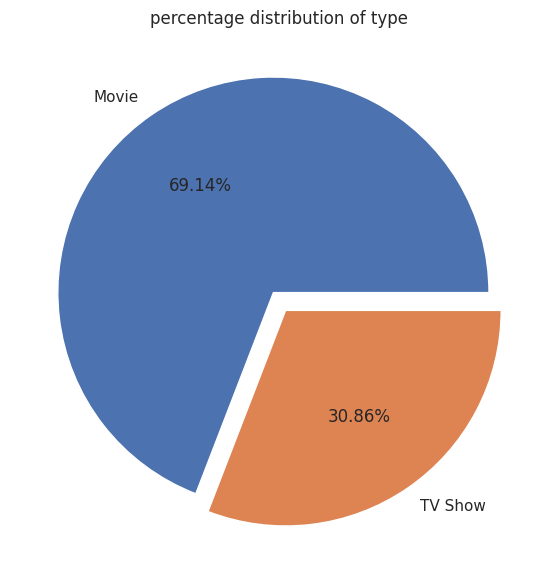

In [ ]:
#Plotting Pie-chart for type
pie_chart('type')

In the dataset around 69% of Movie is present and 31% of TV Show is present.

#### 2. title

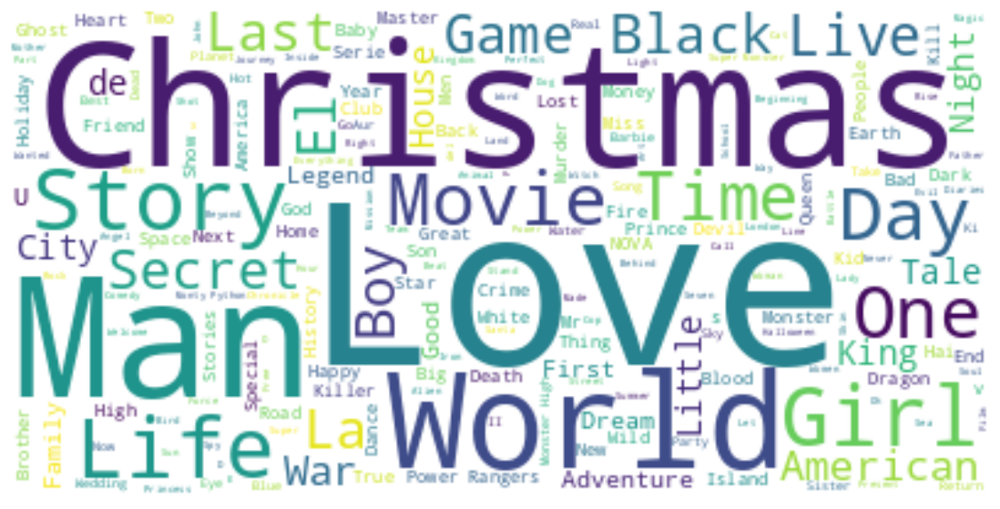

In [ ]:
#Checking the WordCloud for words present in the title
col_word_cloud('title', nf_df)

Christmas, World, Love, Man are some of the most words in the title.

Seems like most of the shows/movies are released during Christmas.

#### 3. director

In [ ]:
#Directors having most counts of movies
nf_df[nf_df['director']!= 'Unknown']['director'].value_counts().head(20)

Raúl Campos, Jan Suter    18
Marcus Raboy              16
Jay Karas                 14
Cathy Garcia-Molina       13
Youssef Chahine           12
Martin Scorsese           12
Jay Chapman               12
Steven Spielberg          10
David Dhawan               9
Ryan Polito                8
Robert Rodriguez           8
Kunle Afolayan             8
Hakan Algül                8
Shannon Hartman            8
Johnnie To                 8
Quentin Tarantino          8
Lance Bangs                8
Don Michael Paul           7
McG                        7
Justin G. Dyck             7
Name: director, dtype: int64

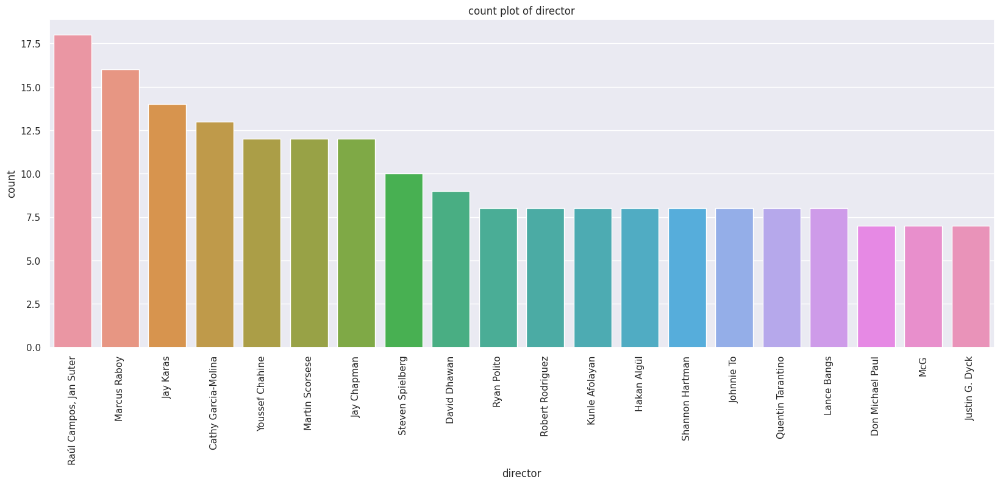

In [ ]:
#Plotting the bar graph for top 20 directors for whose has most number of movies or tv series in the dataset
count_plot('director',nf_df, nf_df[nf_df['director']!= 'Unknown']['director'].value_counts().head(20).index)

Raúl Campos, Jan Suter has directed most of the movies for Netflix.

#### 4. cast

In [ ]:
#Making a dictionary with cast name as key and number of movies/shows done by them as values.
casts = {}
cast_name = []
for row in nf_df['cast']:
  if row!= 'Unknown':
    cast_name.extend(row.split(','))

for c_name in cast_name:
  if c_name not in list(casts.keys()):
    casts[c_name] = cast_name.count(c_name)


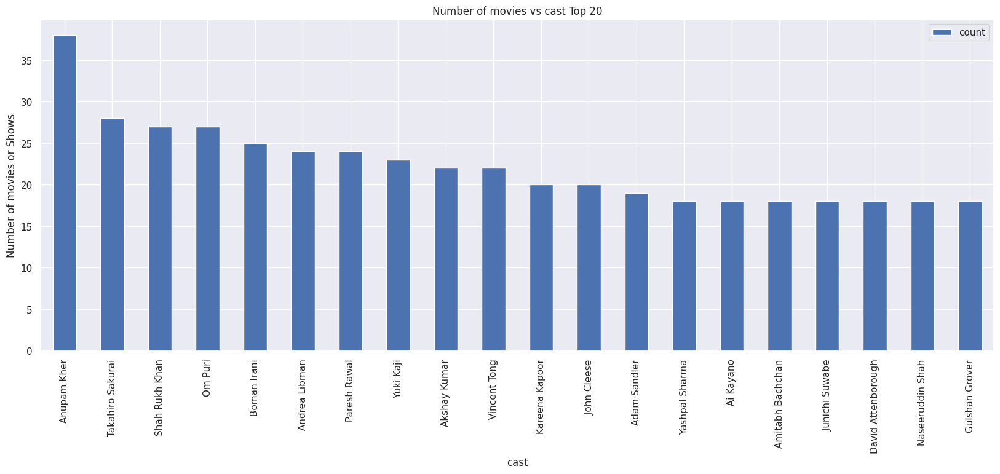

In [ ]:
# Creating a DataFrame for cast for plotting & plotting the top 20 cast who are in max number of movies or shows.
cast_df = pd.DataFrame.from_dict(casts, orient = 'index', columns = ['count'])
cast_df.sort_values('count', ascending = False).head(20).plot(kind ='bar', figsize = (20,7))
plt.xlabel('cast')
plt.ylabel('Number of movies or Shows')
plt.title('Number of movies vs cast Top 20')
plt.show()

Anupam Kher has acted in most of the Movies/TV shows.

#### 5. country

In [ ]:
#Extracting the country names from the dataset foor plotting countplot.
countries = {}
tv_count = []
movie_count = []
row_list = []
for m in range(0, len(nf_df)):
  split = nf_df['country'][m].split(",")
  for k in split:
    if k.strip()!= 'Unknown':
      row_list.append(k.strip())
      if nf_df['type'][m] == 'TV Show':
        tv_count.append(k.strip())
      if nf_df['type'][m] == 'Movie':
        movie_count.append(k.strip())
country_df1 = pd.DataFrame(data = row_list, columns = ['country']) #For plotting countplot for country
countries['country'] = []
countries['Total Production'] = []
countries['TV Show'] = []
countries['Movie'] = []

for i in row_list:
  if i not in list(countries['country']):
    countries['country'].append(i)
    countries['Total Production'].append(row_list.count(i))
    countries['TV Show'].append(tv_count.count(i))
    countries['Movie'].append(movie_count.count(i))

country_df = pd.DataFrame(data = countries)                # For plotting the country wise split of Movie & TV Show
country_df.sort_values('Total Production', ascending=False, inplace = True)
country_df


,country,Total Production,TV Show,Movie
3,United States,3291,860,2431
6,India,990,75,915
12,United Kingdom,722,255,467
16,Canada,412,126,286
21,France,349,84,265
...,...,...,...,...
92,Samoa,1,0,1
93,Azerbaijan,1,1,0
94,Bermuda,1,0,1
95,Ecuador,1,0,1


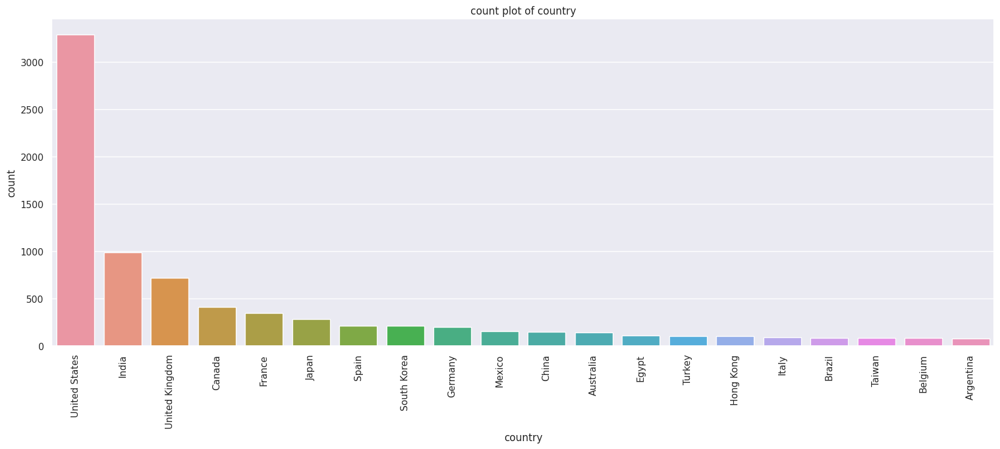

In [ ]:
#Count plot for country
count_plot('country', country_df1, country_df1['country'].value_counts().head(20).index)

Above plot shows the top 20 prodcution countries. 

US, India & UK are having the most production.

In [ ]:
#Plotting world map for visualizing the total content produced by each country.
sns.set_theme()
country_list_for_plot = list(country_df['country'])
country_list_for_plot.remove("")
tot_production_each_country = list(country_df[country_df['country'] != ""]['Total Production'])

trace = map.Choropleth(
            locations = country_list_for_plot,
            locationmode='country names',
            z = tot_production_each_country,
            text = country_df['country'],
            reversescale = False,
            zauto = True,
            colorscale = 'magenta',
            marker = dict(
                line = dict(
                    color = 'rgb(90,90,90)',
                    width = 0.5)
            ),
            colorbar = dict(
                title = 'Total Content',
                tickprefix = '')
        )
data = [trace]
layout = map.Layout(
    title = 'Total content per country',
    geo = dict(
        showframe = True,
        showlakes = False,
        showcoastlines = True,
    )
)

fig = map.Figure(data=data, layout=layout)
fig.show()

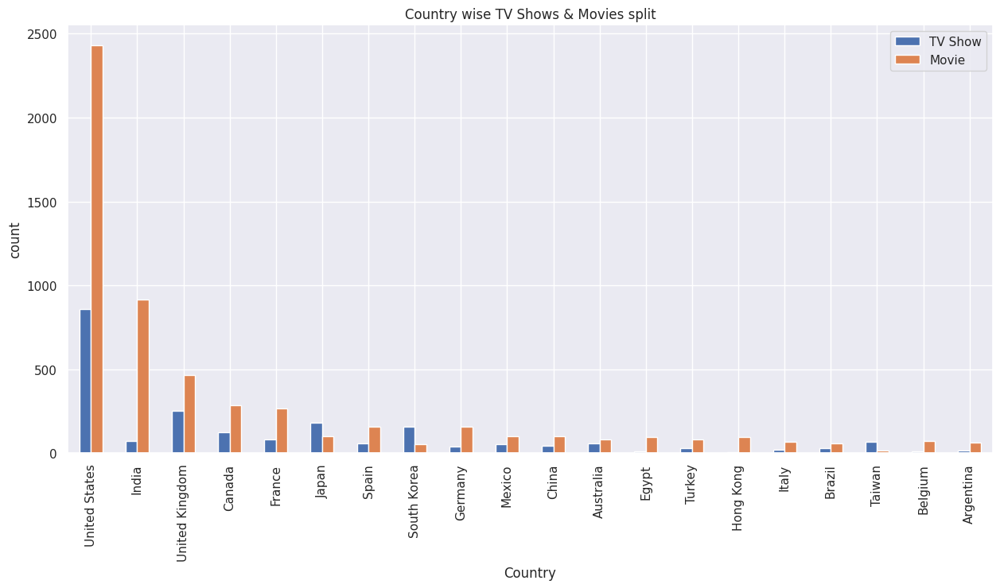

In [ ]:
#Plotting country wise split of Movie & TV Show
country_df.head(20).plot(x = 'country', y = ['TV Show', 'Movie'], kind = 'bar', figsize= (15,7))
plt.xlabel('Country')
plt.ylabel('count')
plt.title('Country wise TV Shows & Movies split')
plt.show()

* For most of the countries TV Show production are lesser than Movies. 
* But we can see in Japan, South Korea, Taiwan TV Shows are more produced as compared to Movies. Animes are very famous in those countries.

#### 6.release_year

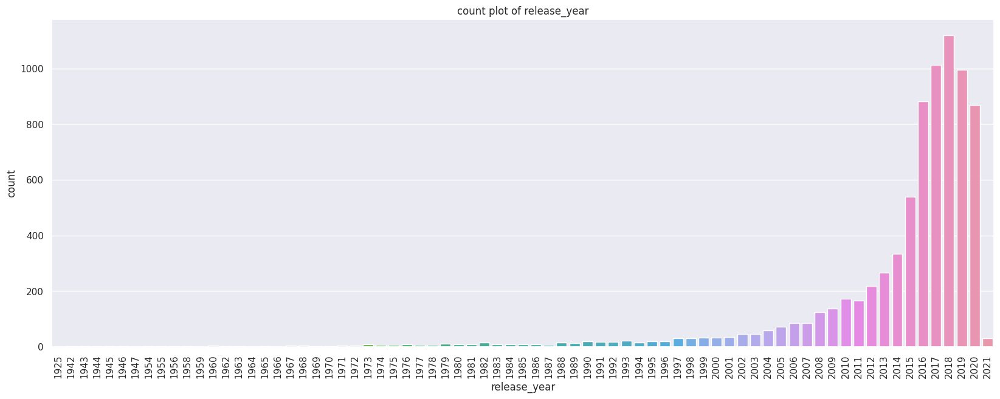

In [ ]:
#Countplot for release year
count_plot('release_year', nf_df)

We can see that there is a exponenetial rise in the number of TV shows and Movies from year 2010.

In [ ]:
#Code to plot the release year wise split of Movies and TV shows
release_yr = {}
tv_count = []
movie_count = []
row_list = []
for m in range(0,len(nf_df)):
  row_list.append(nf_df['release_year'][m])
  if nf_df['type'][m] == 'Movie':
    movie_count.append(nf_df['release_year'][m])
  if nf_df['type'][m] == 'TV Show':
    tv_count.append(nf_df['release_year'][m])
  
release_yr['release_yr'] = []
release_yr['Total Released'] = []
release_yr['TV Show'] = []
release_yr['Movie'] = []

for i in row_list:
  if i not in release_yr['release_yr']:
    release_yr['release_yr'].append(i)
    release_yr['Total Released'].append(row_list.count(i))
    release_yr['TV Show'].append(tv_count.count(i))
    release_yr['Movie'].append(movie_count.count(i))

released_yr = pd.DataFrame(data = release_yr)
released_yr.sort_values('release_yr', inplace = True)
released_yr



,release_yr,Total Released,TV Show,Movie
61,1925,1,1,0
62,1942,2,0,2
72,1943,3,0,3
69,1944,3,0,3
58,1945,3,0,3
...,...,...,...,...
7,2017,1012,268,744
8,2018,1120,386,734
5,2019,996,414,582
0,2020,868,457,411


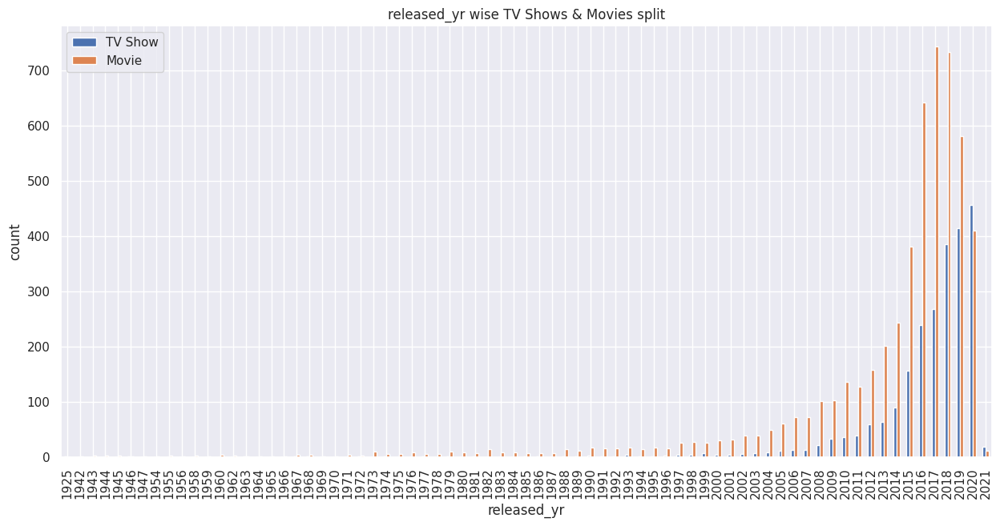

In [ ]:
#Plotting release year wise split of Movie & TV Show
released_yr.plot(x = 'release_yr', y = ['TV Show', 'Movie'], kind = 'bar', figsize = (15,7))
plt.xlabel('released_yr')
plt.ylabel('count')
plt.title('released_yr wise TV Shows & Movies split')
plt.show()

There is an increase in both number of TV Shows and Movies.

In 2020 number of TV Shows were more than number of Movies.

Netflix dataset contains data only up to 16th January 2021, that's why we can see less number of movies and TV shows in year 2021.

#### 7. rating

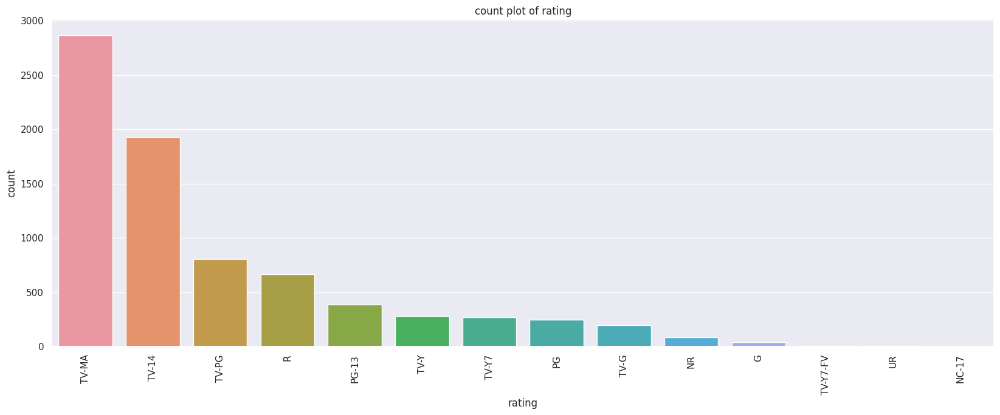

In [ ]:
#Count plot for rating
count_plot('rating', nf_df, nf_df['rating'].value_counts().sort_values(ascending = False).index)

The majority of the shows on Netflix are for adults and for children above age 14.

We are using Kernel Density Estimate (KDE) plot to plot the distribution of duration for TV Show and Movie. 

Relative to a histogram, KDE can produce a plot that is less cluttered and more interpretable, especially when drawing multiple distributions.

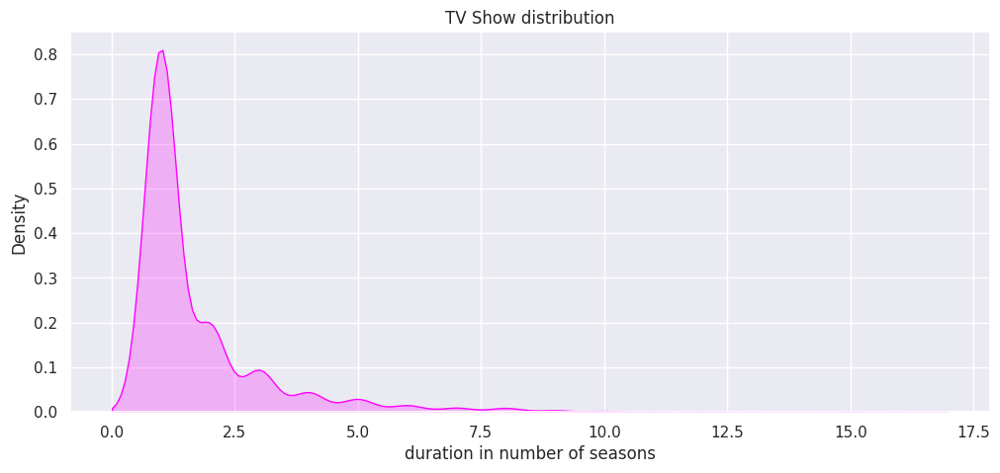

In [ ]:
#Plotting distribution for TV Show duration
plt.figure(figsize = (12,5))
plt.title("TV Show distribution")
sns.kdeplot(data=nf_df[nf_df['type'] == 'TV Show']['duration'], fill = 'on', color = 'magenta')
plt.xlabel("duration in number of seasons")
plt.show()

* From the above graph we can infer that most of the TV Shows contains 1 - 2 seasons.
* There are some TV shows with 16 seasons.
* There are very few TV Show with more than 7 seasons.

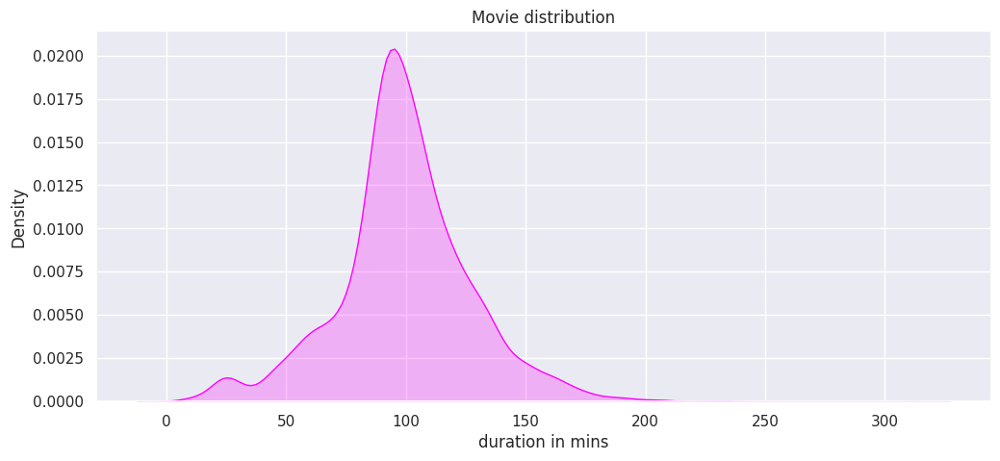

In [ ]:
#Plotting distribution for Movies duration
plt.figure(figsize = (12,5))
plt.title("Movie distribution")
sns.kdeplot(data=nf_df[nf_df['type'] == 'Movie']['duration'], fill = 'on', color = 'magenta')
plt.xlabel("duration in mins")
plt.show()

From the above graph we can infer that most of the movies are around 100mins duration.

#### 9. listed_in / Genre

In [ ]:
#Making a dictionary with genre as key and number of movies/shows in each genre as values.
genres = {}
genre_name = []
for rowg in nf_df['listed_in']:
  genre_name.extend(rowg.split(','))
for g in genre_name:
  if g not in list(genres.keys()):
    genres[g.strip()] = genre_name.count(g)


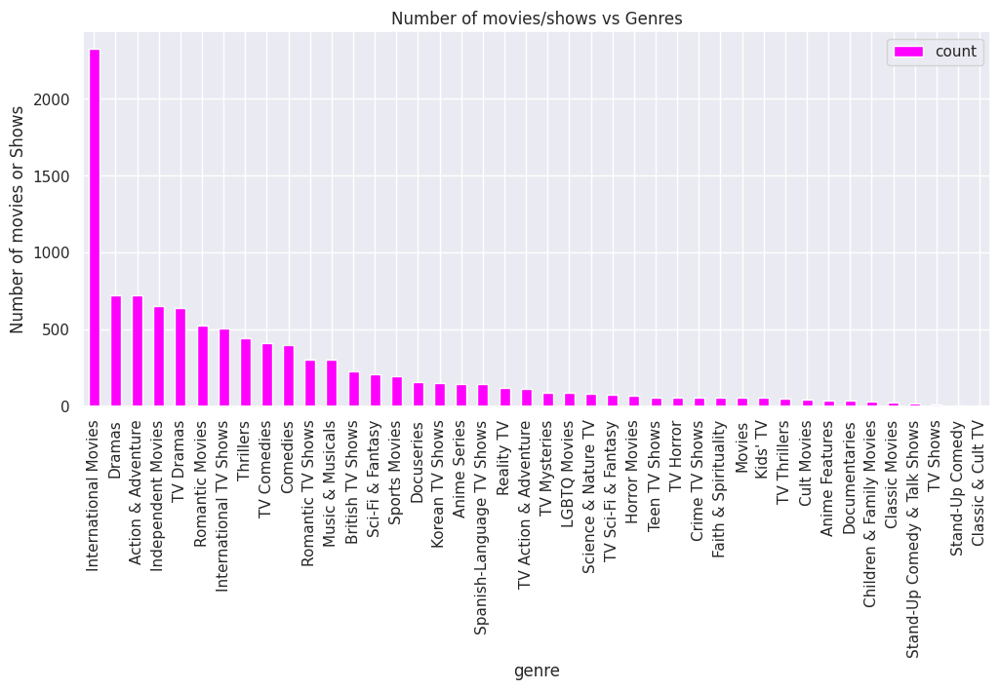

In [ ]:
# Creating a DataFrame for cast for plotting & plotting the top 20 cast who are in max number of movies or shows.
genre_df = pd.DataFrame.from_dict(genres, orient = 'index', columns = ['count'])
genre_df.sort_values('count', ascending = False).plot(kind = 'bar', figsize = (12,5), color = 'magenta')
plt.xlabel("genre")
plt.ylabel("Number of movies or Shows")
plt.title("Number of movies/shows vs Genres")
plt.show()

Most of the TV Shows and Movies are from genre International Movies.

#### 10. description

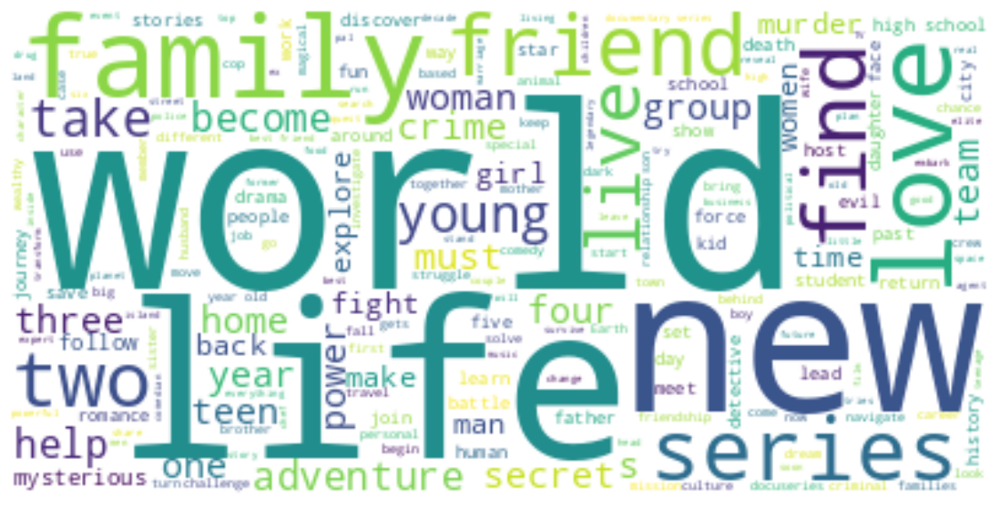

In [ ]:
# Visuallizing the wordcloud for description for TV Show
col_word_cloud('description', nf_df[nf_df['type']=='TV Show'])

description of TV Shows contains more words like world, life, family, new, find, love etc. 

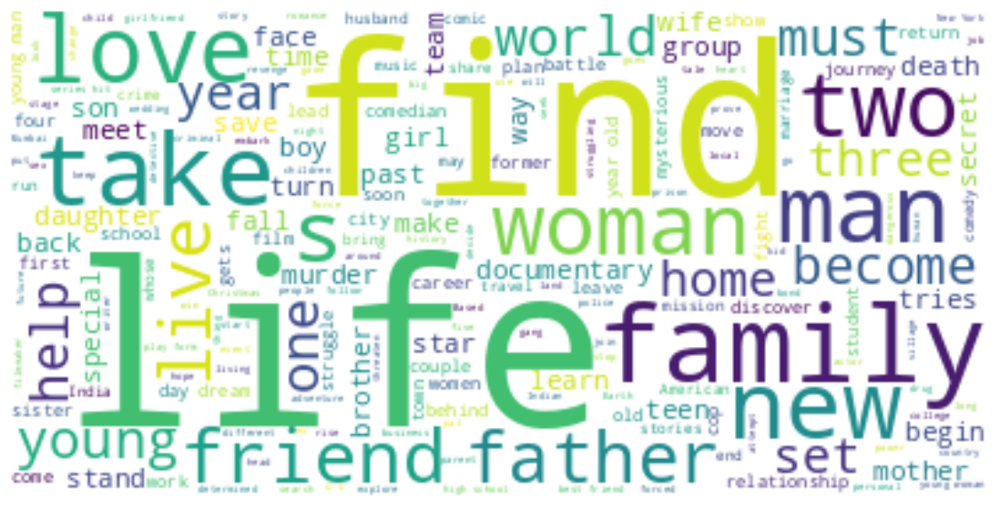

In [ ]:
# Visuallizing the wordcloud for description for Movies
col_word_cloud('description', nf_df[nf_df['type']=='Movie'])

description of Movies contains more words like life, find, woman, family

### Bivariate Analysis

#### 1. country wise genre/listed_in distribution

In [ ]:
#Extracting data for contry wise genre/listed_in
cg_df = nf_df.copy()
cg_df['country_list'] = cg_df.apply(lambda x: x['country'].split(", "),axis=1)
cg_df = cg_df.explode('country_list')
cg_df['genre_list'] = cg_df.apply(lambda x: x['listed_in'].split(", "),axis=1)
cg_df = cg_df.explode('genre_list')

distinct_country = [ ]

#Extracting distinct country name from country feature.
for cont in cg_df['country_list']:
  if cont.replace(",","") not in distinct_country:
    distinct_country.append(cont)

In [ ]:
cg_df.head()

,index,show_id,type,title,director,cast,country,release_year,rating,duration,listed_in,description,month_added,year_added,country_list,genre_list
0,0,s1,TV Show,3%,Unknown,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,2020,TV-MA,4,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...,8,2020,Brazil,International TV Shows
0,0,s1,TV Show,3%,Unknown,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,2020,TV-MA,4,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...,8,2020,Brazil,TV Dramas
0,0,s1,TV Show,3%,Unknown,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,2020,TV-MA,4,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...,8,2020,Brazil,TV Sci-Fi & Fantasy
1,1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,2016,TV-MA,93,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...,12,2016,Mexico,Dramas
1,1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,2016,TV-MA,93,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...,12,2016,Mexico,International Movies


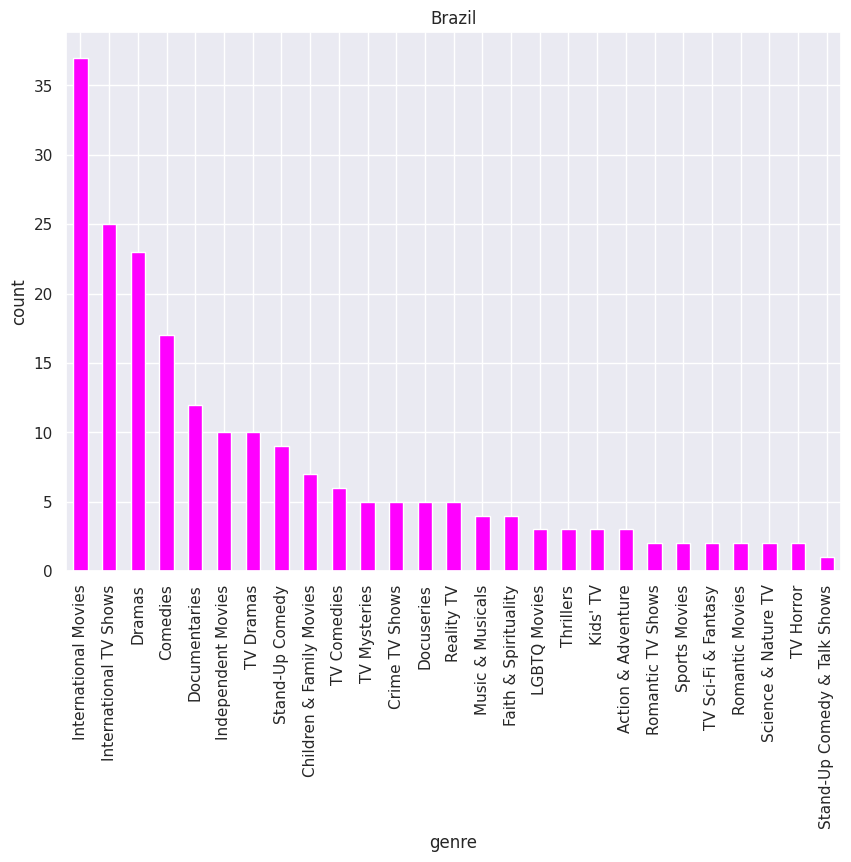

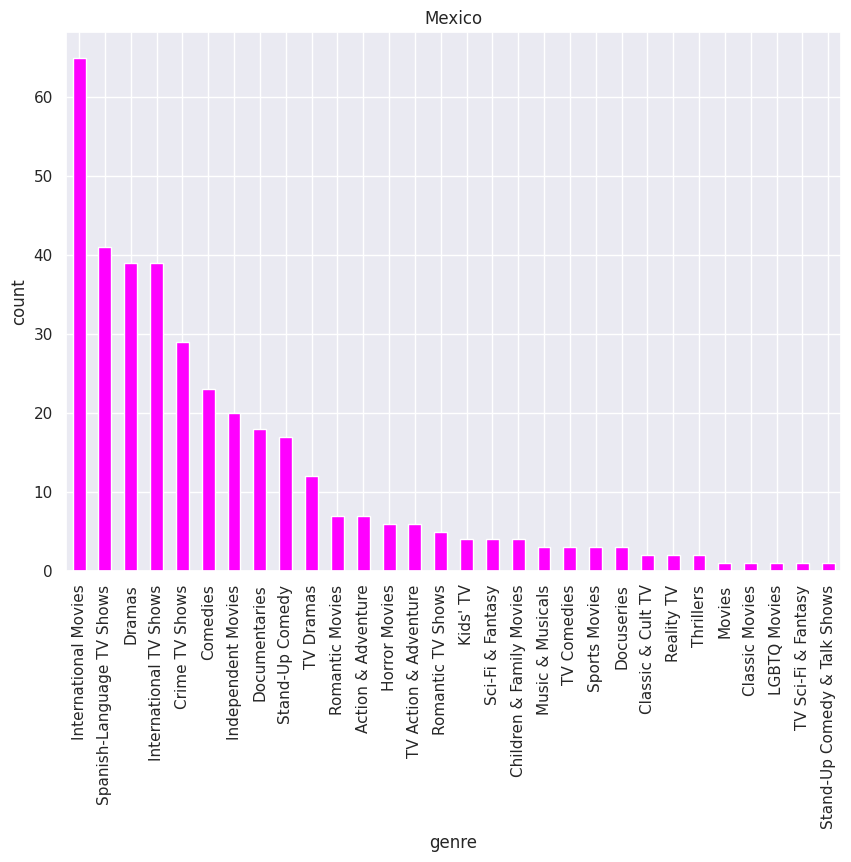

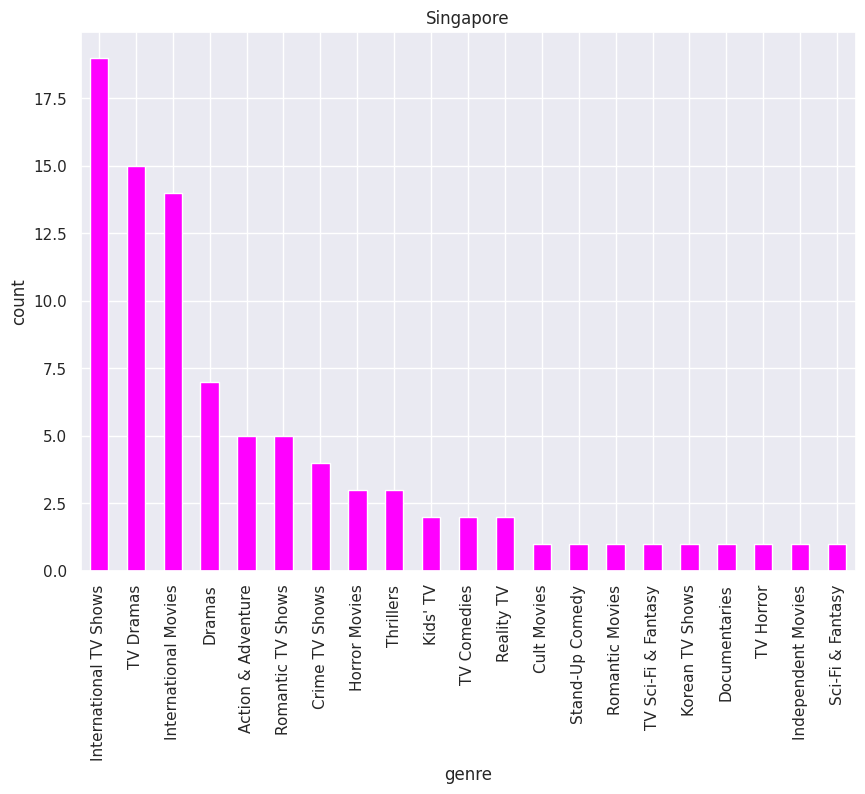

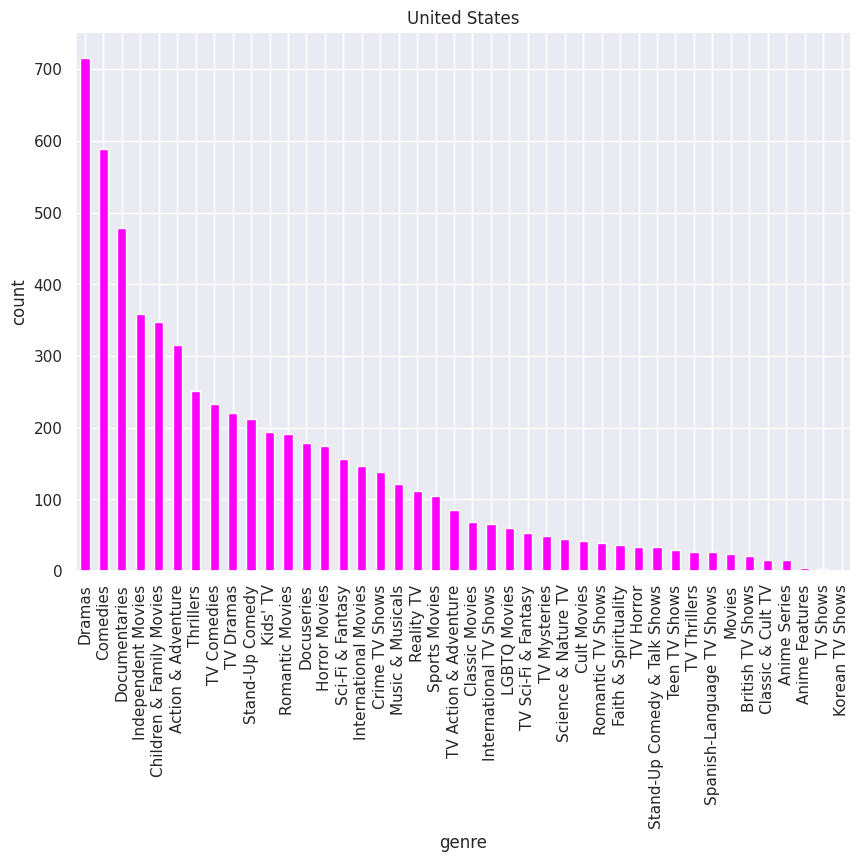

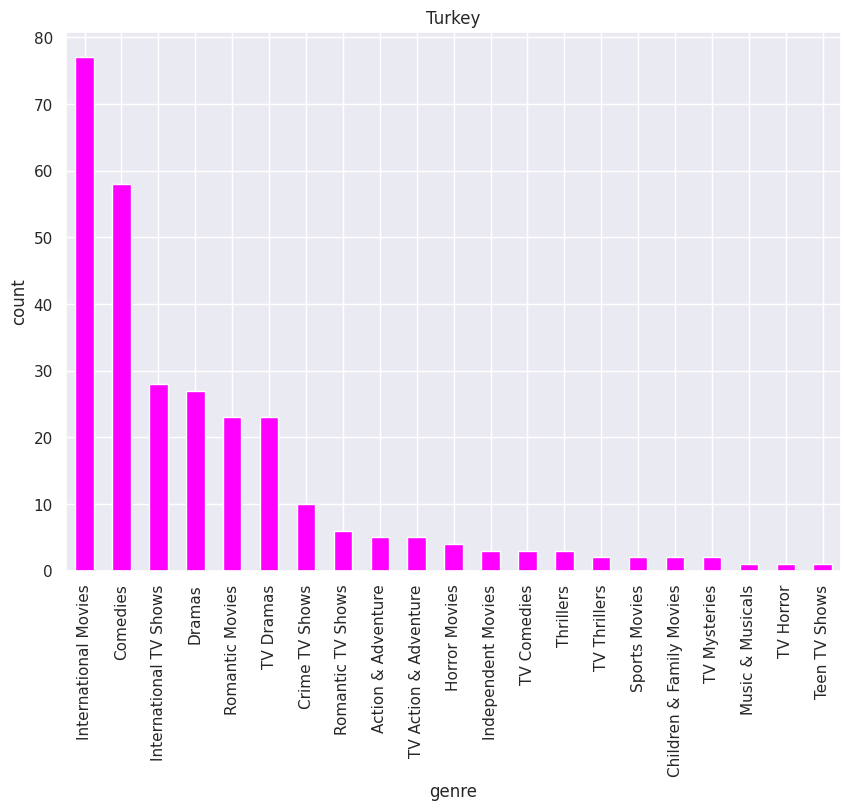

...

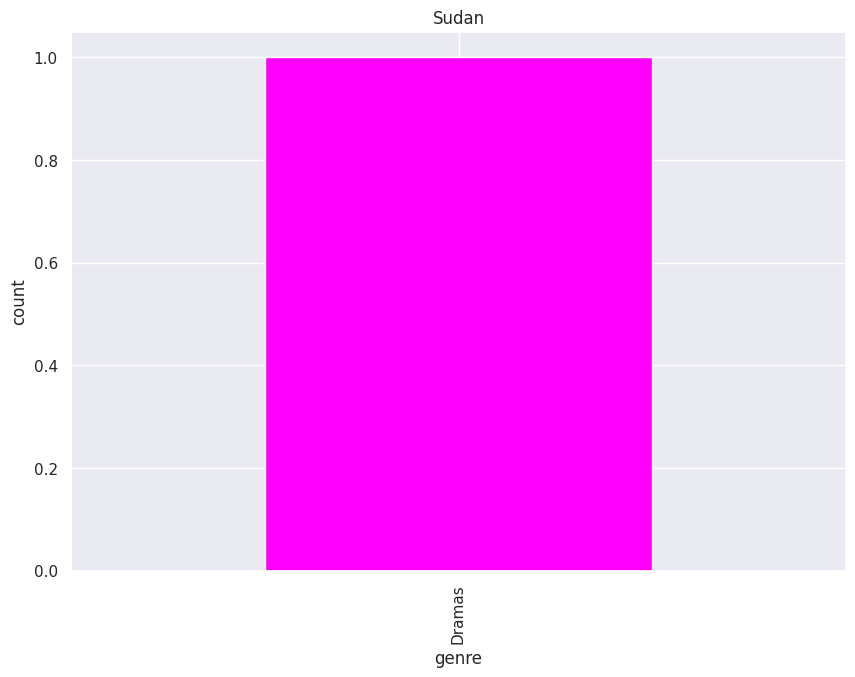

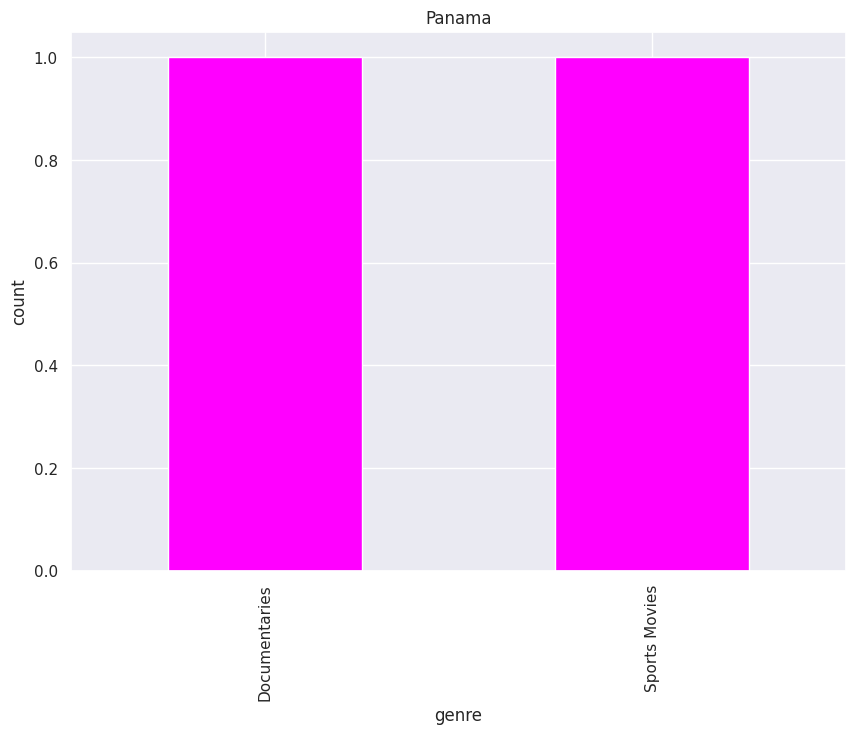

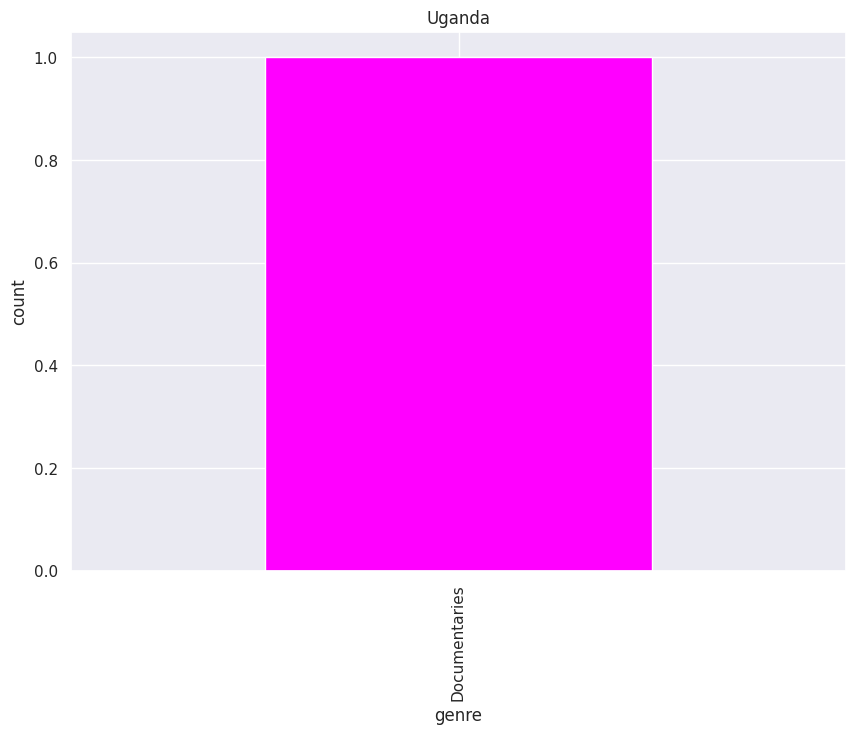

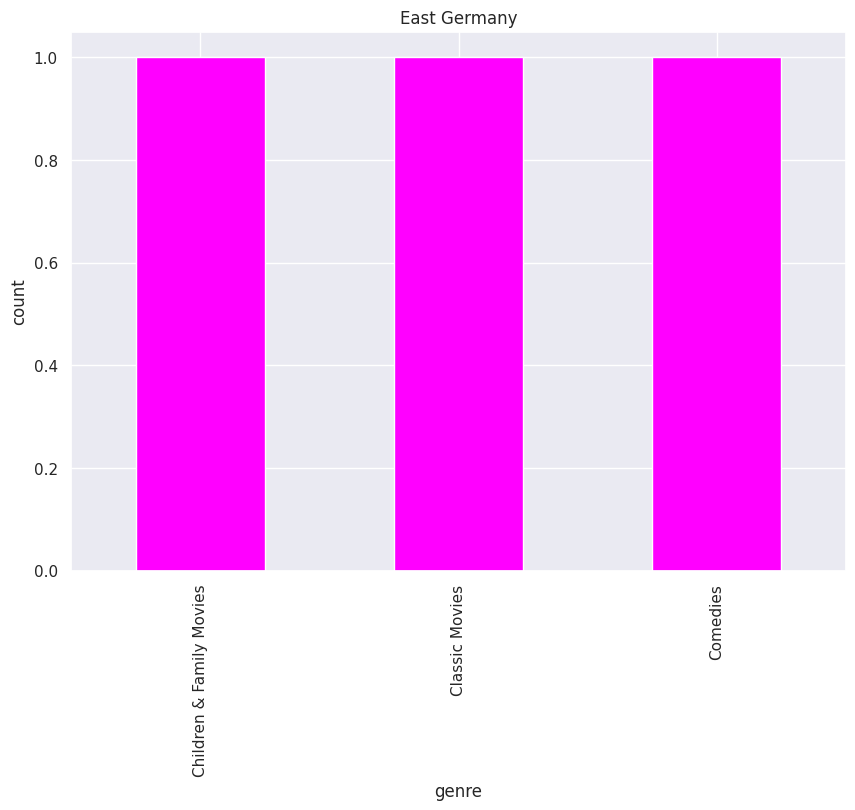

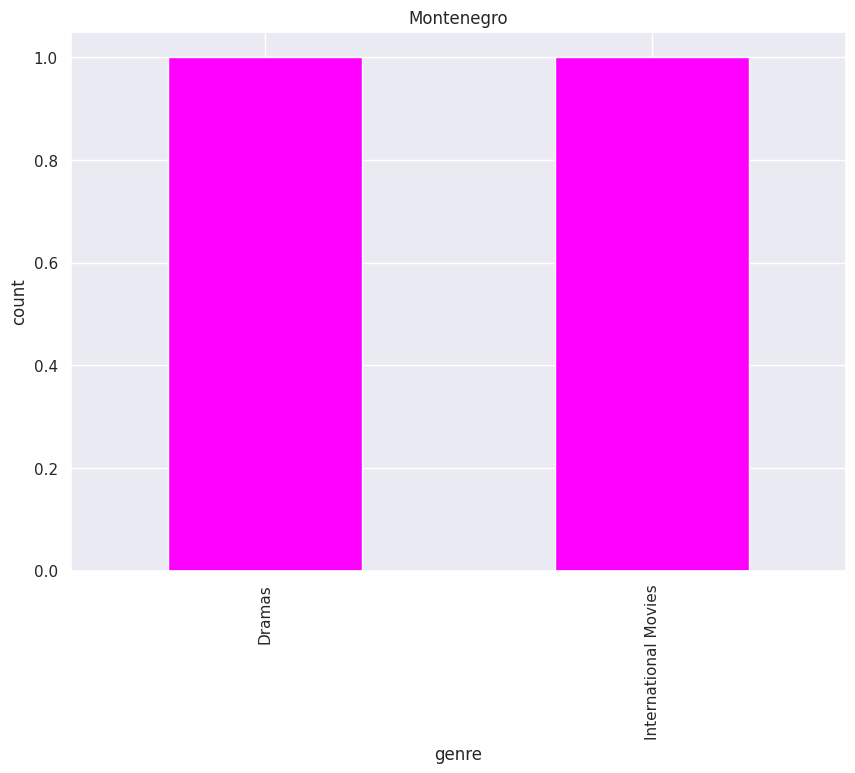

In [ ]:
#Plotting each contrywise genre listings.
for cont in distinct_country:
  cg_df[cg_df['country_list'].str.replace(",","") == cont]['genre_list'].value_counts().plot(kind = "bar", figsize = (10,7), color = 'magenta')
  plt.title(cont)
  plt.xlabel('genre')
  plt.ylabel('count')
  plt.show()
  print("\n")

Above list of graphs clearly shows the country wise listing for each country.
We can draw lots of useful insights from the above graphs -



*   Most of the countries like Brazil, Mexico, Turkey, Egypt, India etc have produced more International Movies.
*   Countries like Singapore, Japan, South Korea etc have produced more International TV Shows as compared to other genres.
* Contries like US, Poland, iceland Dramas are most produced genre.
* UK is producing more British TV shows.
* Canada have produced most comedies genre shows/movies.

#### 2. country wise content rating distribution

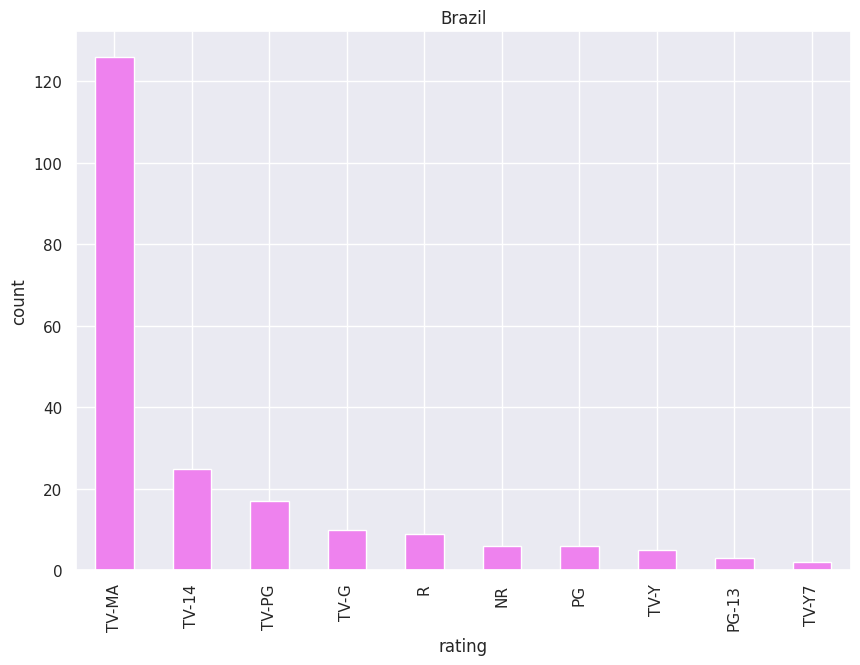

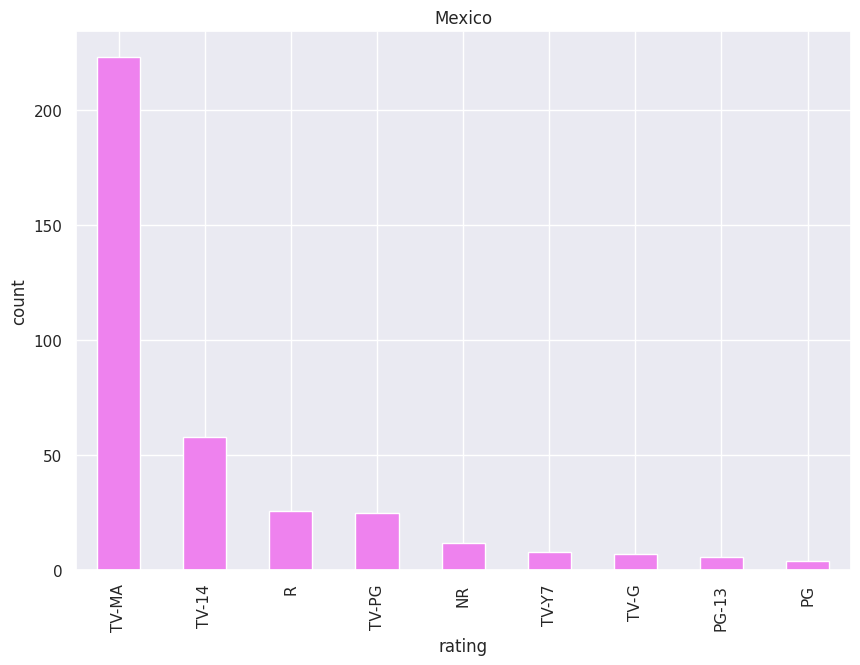

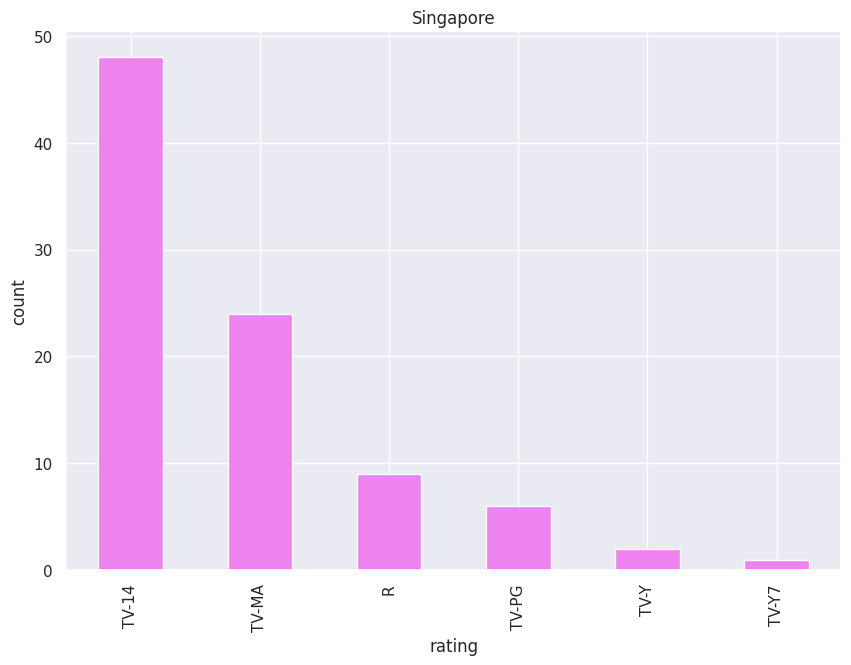

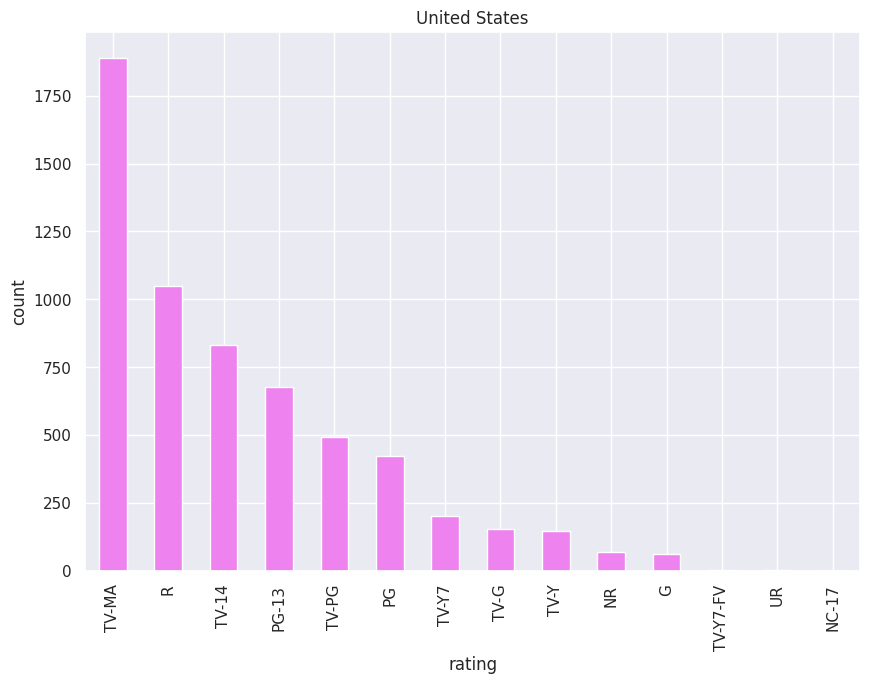

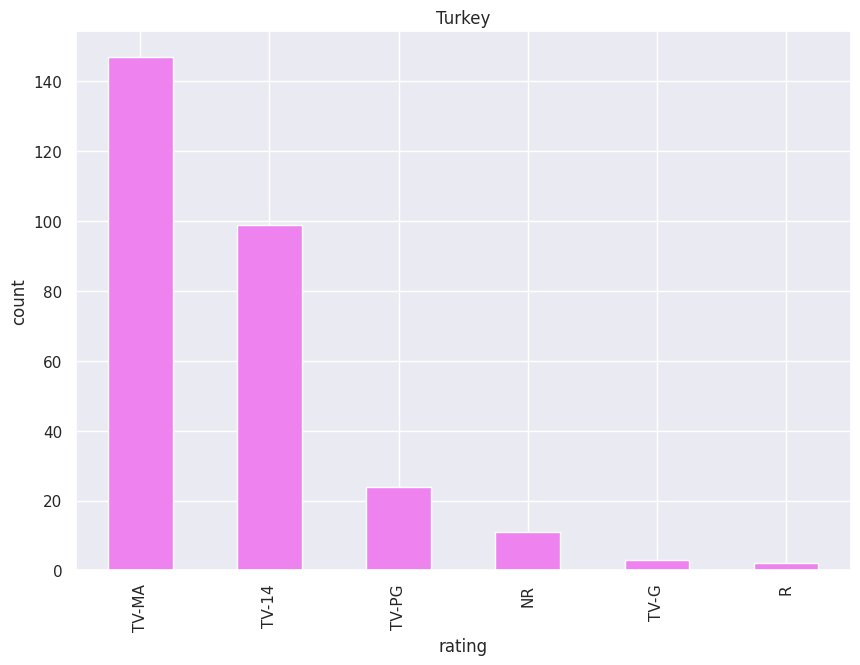

...

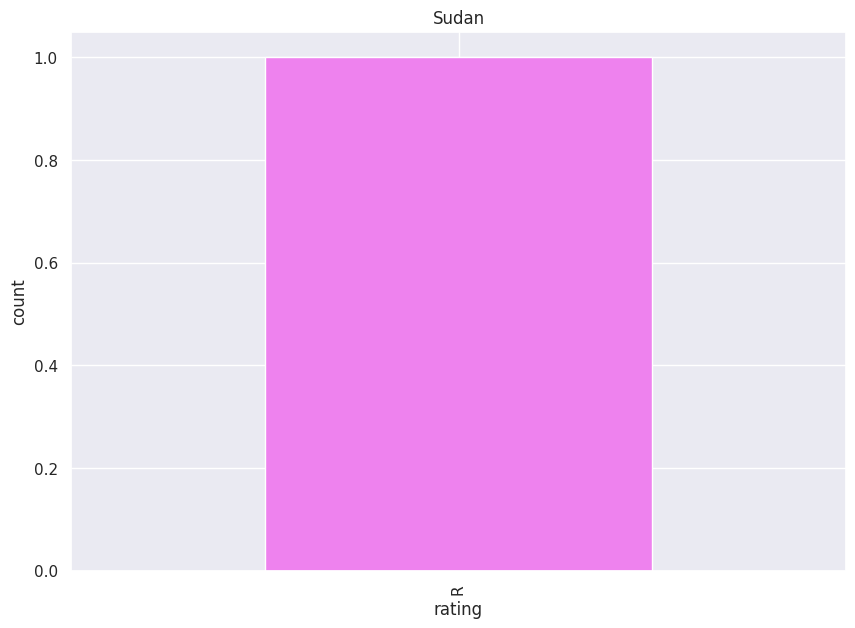

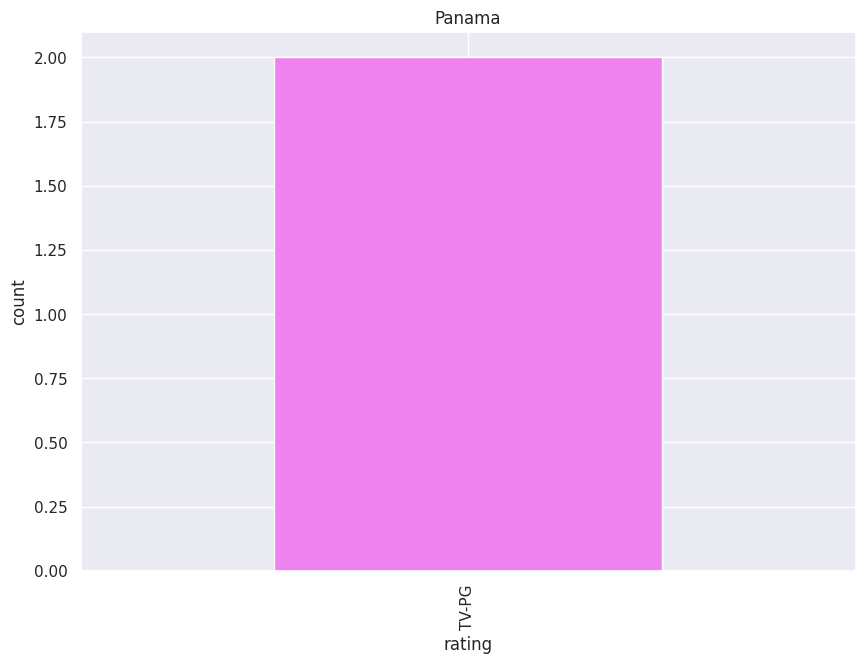

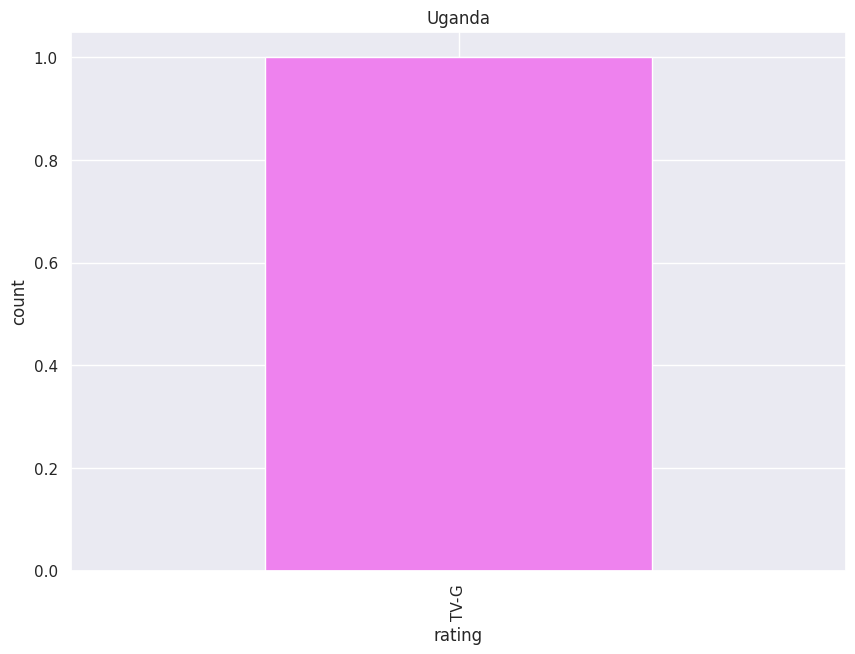

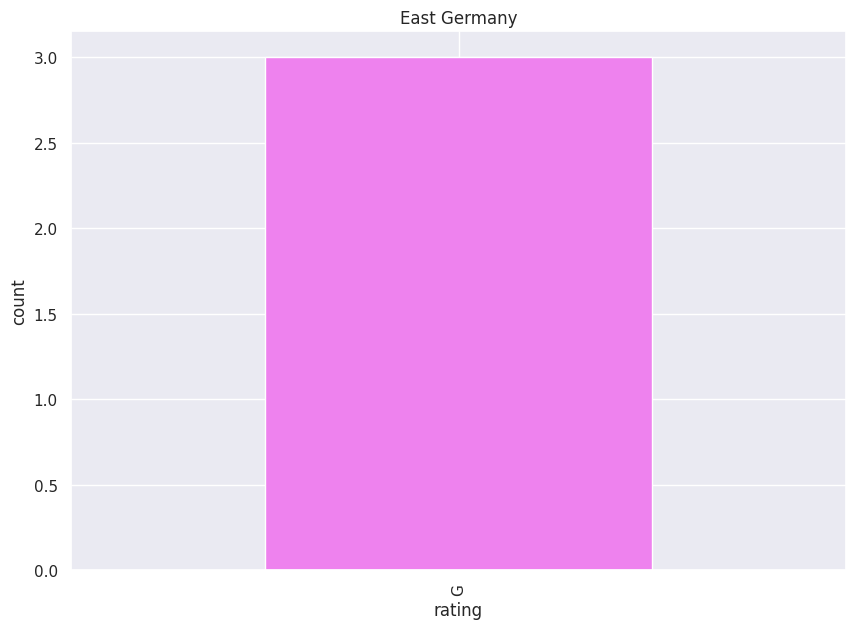

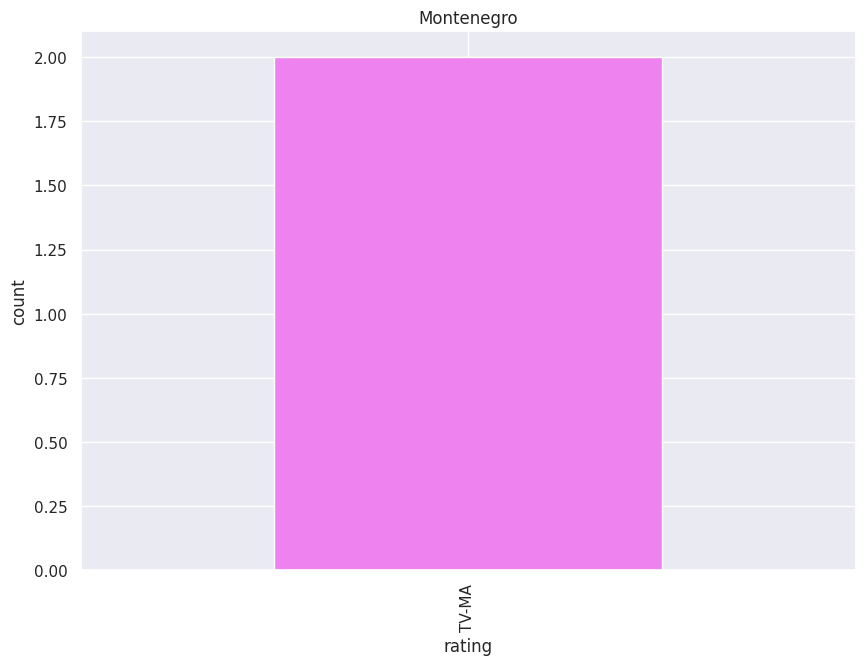

In [ ]:
#Plotting each contriwise content rating distribution.
for cont in distinct_country:
  cg_df[cg_df['country_list'].str.replace(",","") == cont]['rating'].value_counts().plot(kind = "bar", figsize = (10,7), color = 'violet')
  plt.title(cont)
  plt.xlabel('rating')
  plt.ylabel('count')
  plt.show()
  print("\n")

Above list of graphs clearly shows the country wise listing in each content rating.
We can draw lots of useful insights from the above graphs -
*  Countries like Brazil, Mexico, United States, Turkey, Egypt, Poland, United Kingdom, Canada etc have produced more number of adult content movie/shows.
*   Countries like India, Singapore, Egypt, Nigeria, Indonesia, Hong Kong etc. are producing more contents which can be consumed by children above 14yrs age.

#### 3. country wise the type of content available

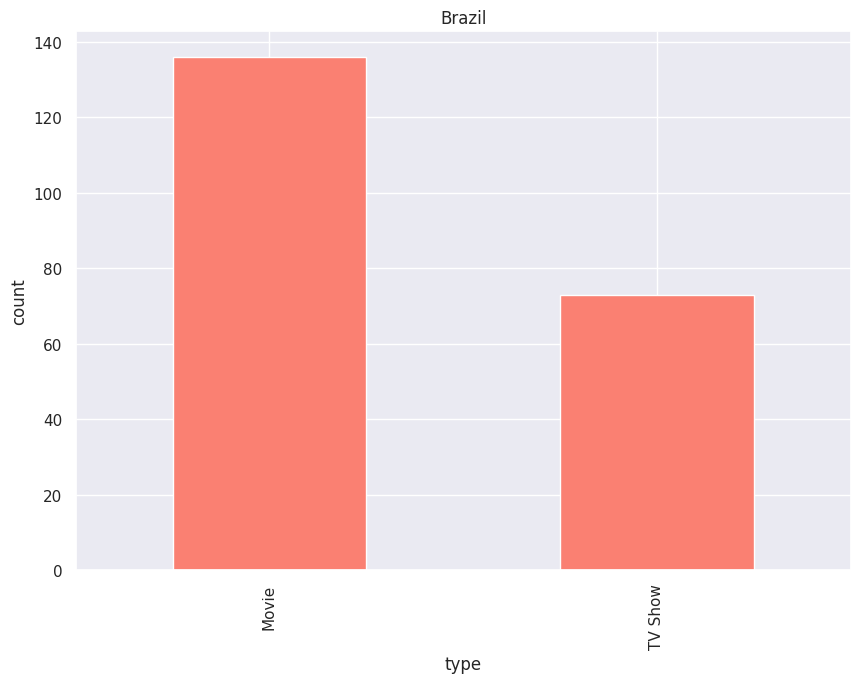

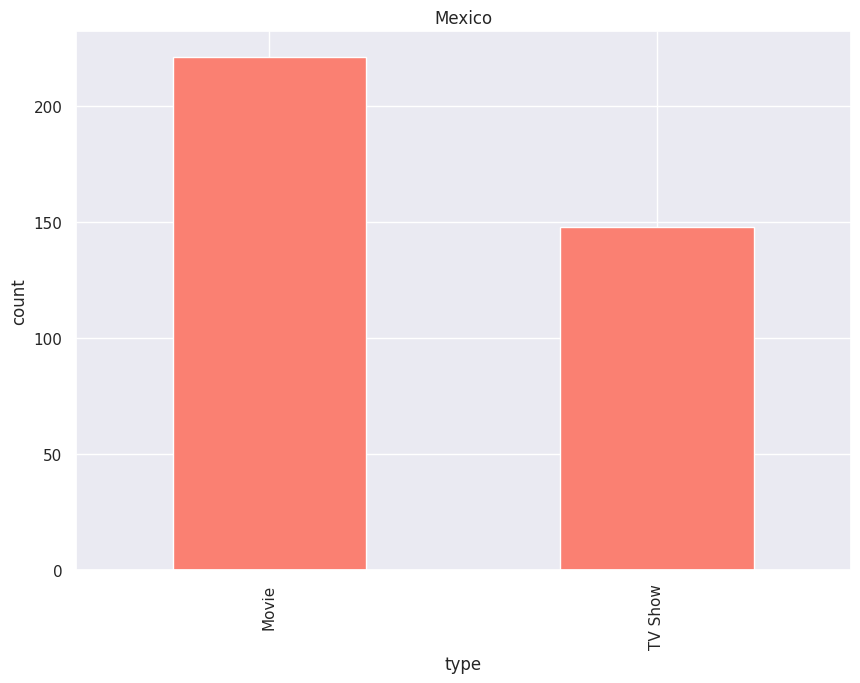

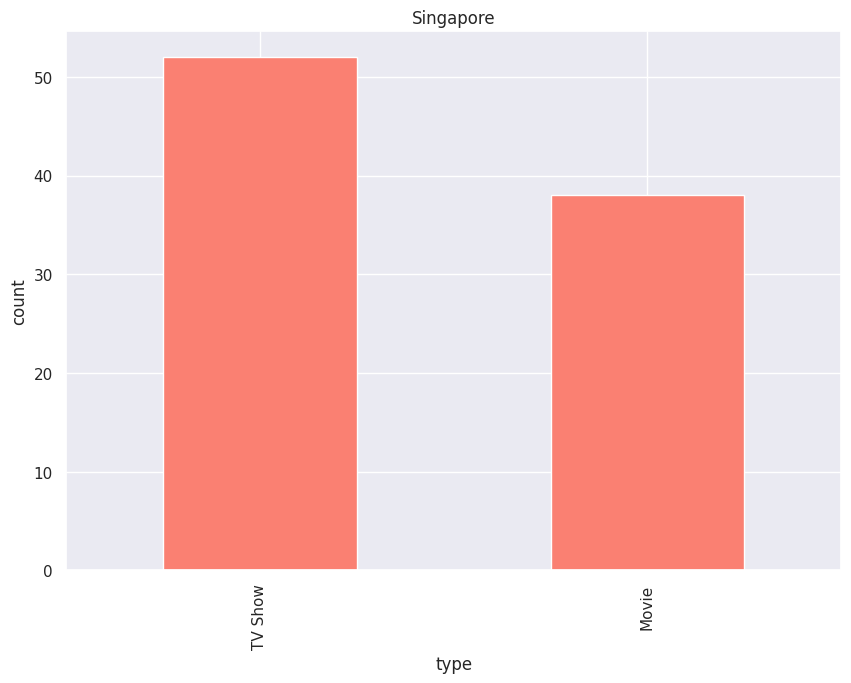

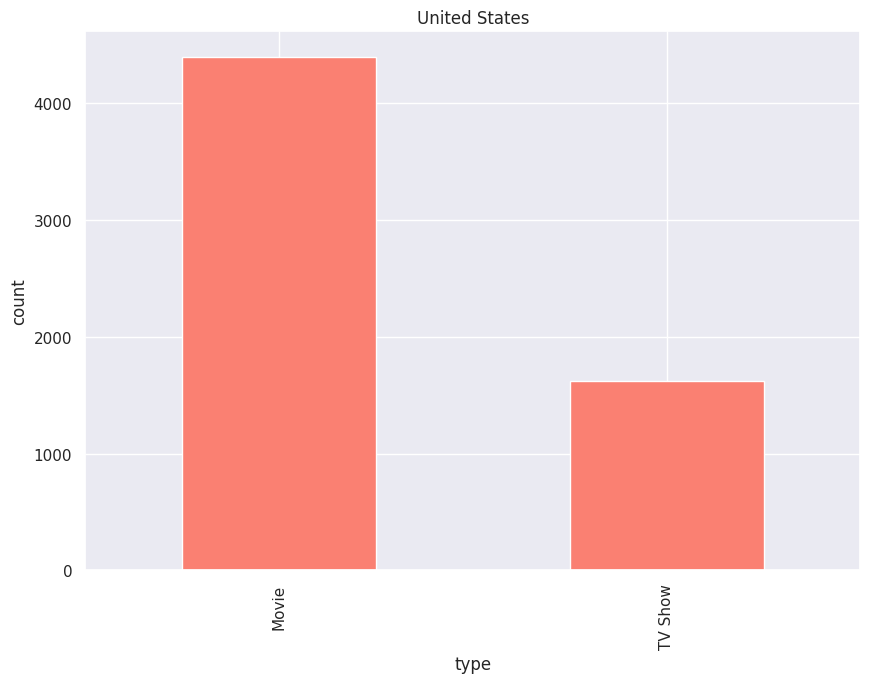

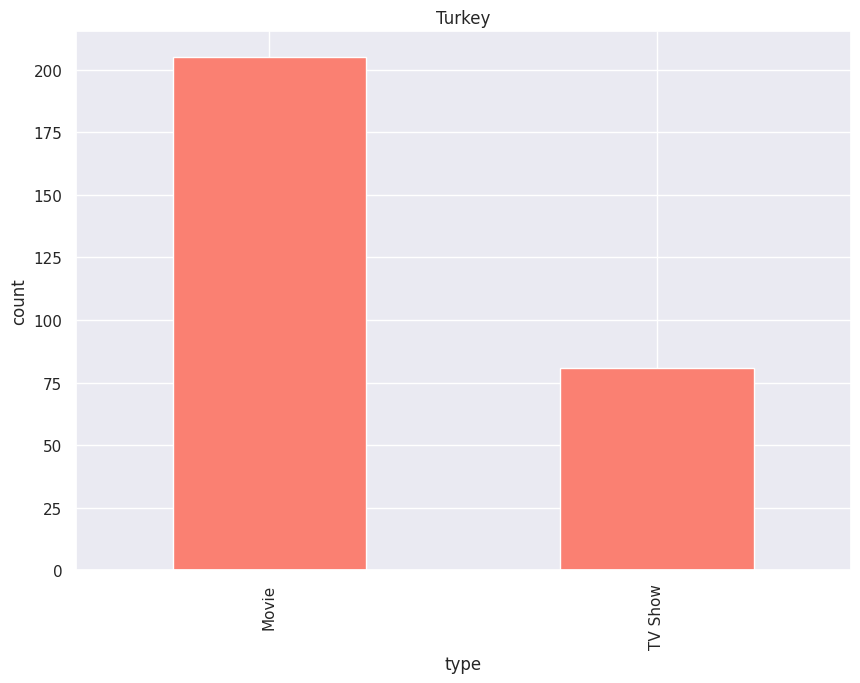

...

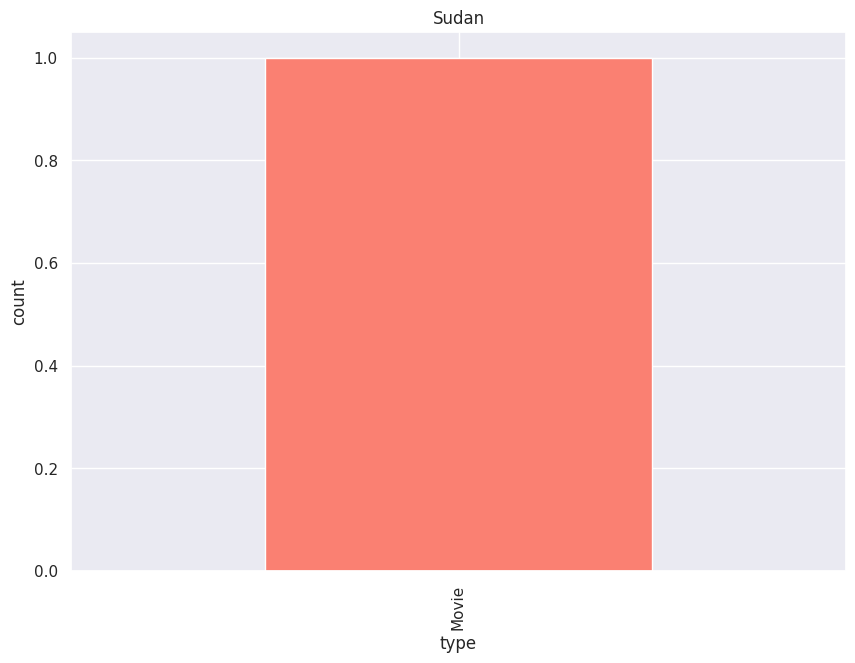

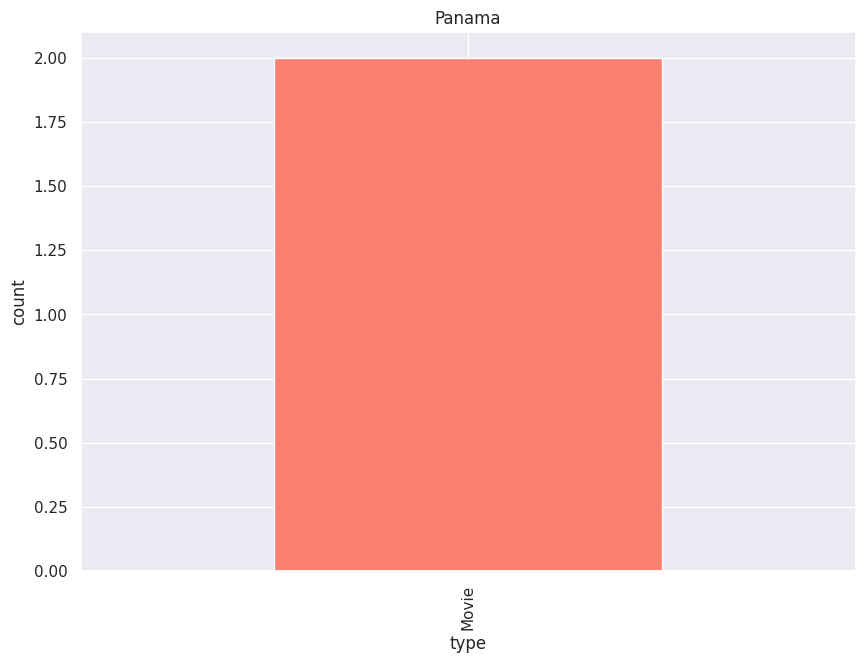

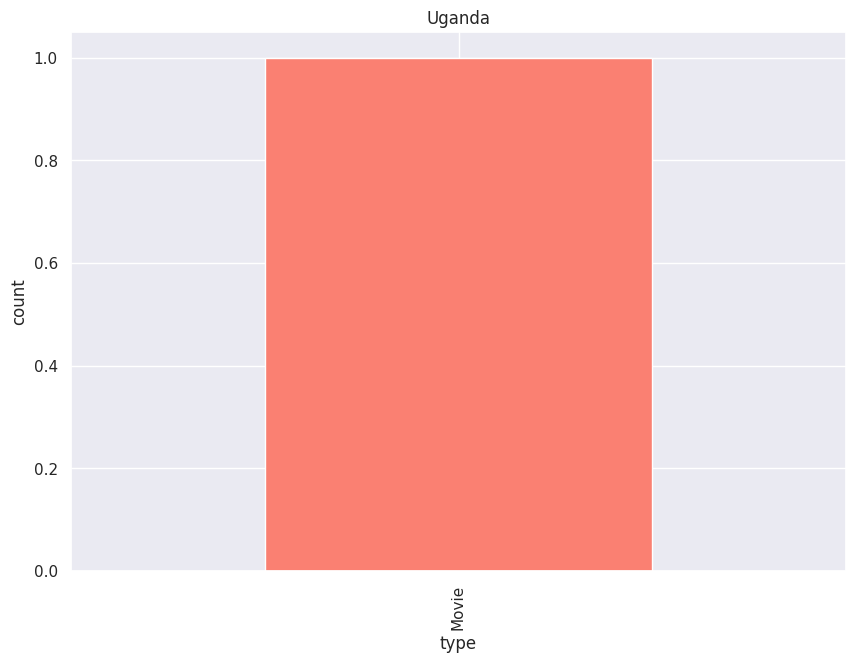

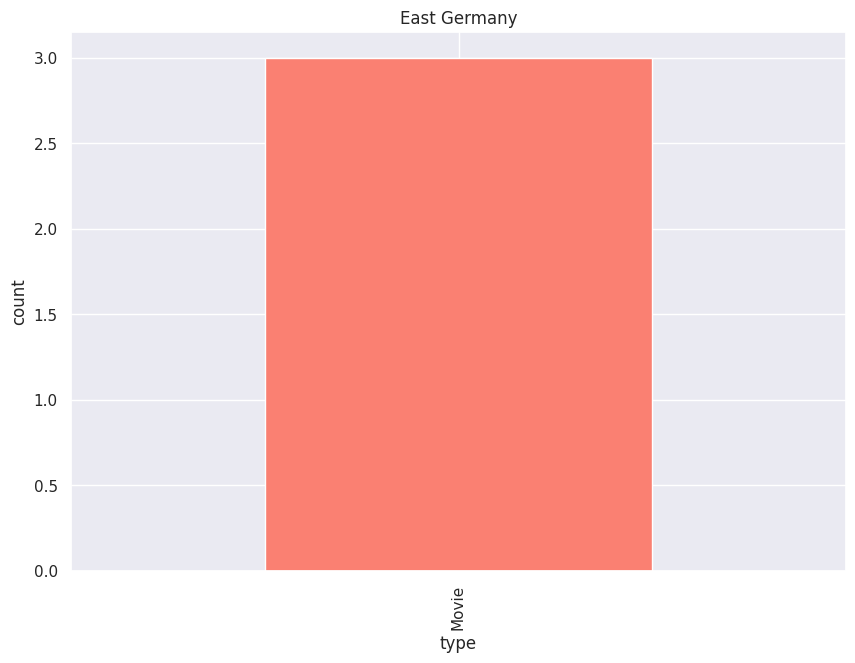

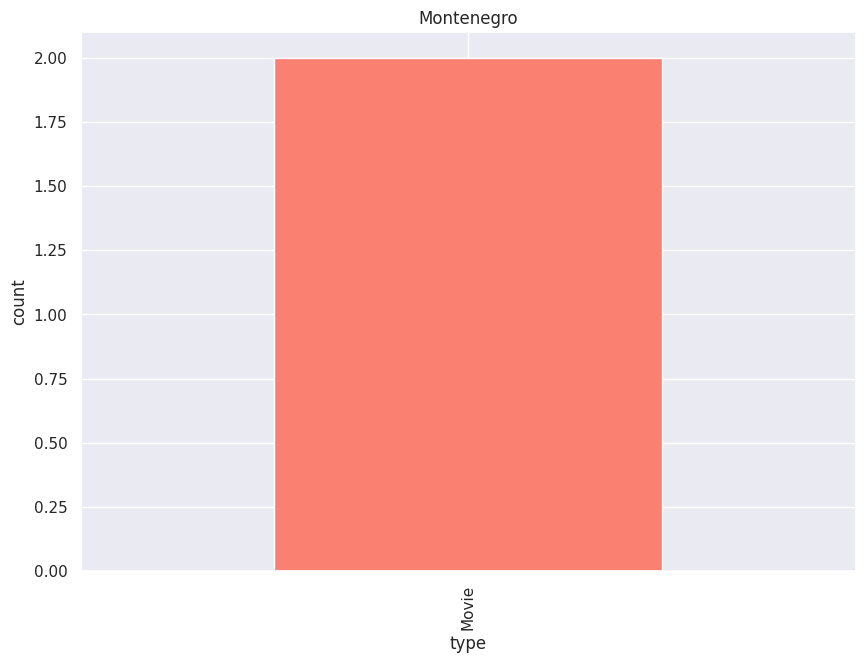

In [ ]:
#Plotting each contriwise content type.
for cont in distinct_country:
  cg_df[cg_df['country_list'].str.replace(",","") == cont]['type'].value_counts().plot(kind = "bar", figsize = (10,7), color = 'salmon')
  plt.title(cont)
  plt.xlabel('type')
  plt.ylabel('count')
  plt.show()
  print("\n")

Above list of graphs clearly shows the country wise content type listings.
We can draw lots of useful insights from the above graphs -
*   Most of the countries have produced more movies than TV Shows.
*   Countries like Singapore, Japan, South Korea, Taiwan, Russia, Mauritius etc. have produced more TV shows than movies.
* Mauritius, Syria, Cuba have produced only TV Shows.

#### 4. Is Netflix has increasingly focusing on TV rather than movies in recent years.

Plot showing number of movies and TV Shows added over the years.

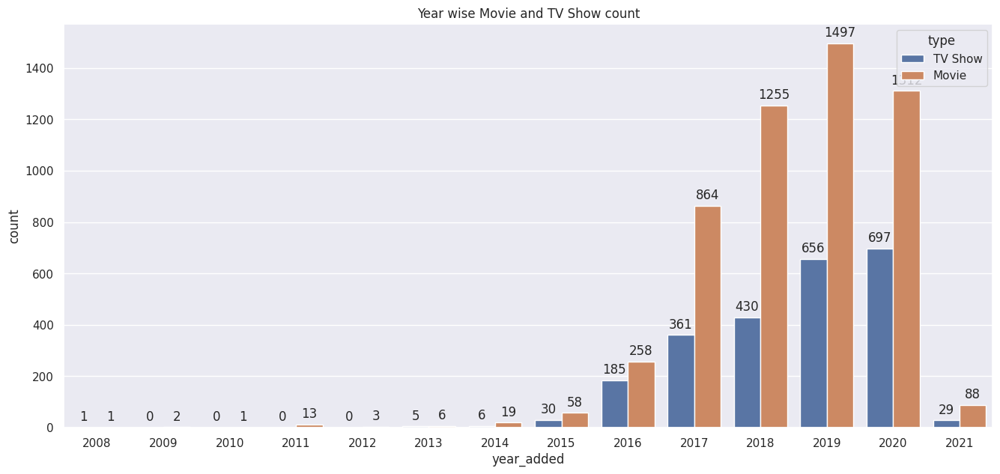

In [ ]:
#Plotting code
plt.figure(figsize = (16,7))
p = sns.countplot(x = 'year_added', data = nf_df, hue = 'type')
plt.title('Year wise Movie and TV Show count')
for i in p.patches:
  p.annotate(format(i.get_height(), '.0f'), (i.get_x() + i.get_width() / 2., i.get_height()), ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')
plt.show()

* Over the years, Netflix has consistently focused on adding more shows in its platform.
* There is a decrease in number of movies added in the year 2020 as compared to year 2019 whereas the number of TV Shows have increased from 656 to 697 from year 2019 to year 2020. 
* This might signal that Netflix is increasingly concentrating on introducing more TV series to its platform rather than movies.

In [ ]:
#Extracting year wise TV Show & Movie added
yr_added_movie = nf_df[nf_df['type'] == 'Movie']['year_added'].value_counts().reset_index().sort_values(by = 'index')
yr_added_tv = nf_df[nf_df['type']== 'TV Show']['year_added'].value_counts().reset_index().sort_values(by = 'index')

<function matplotlib.pyplot.show(close=None, block=None)>

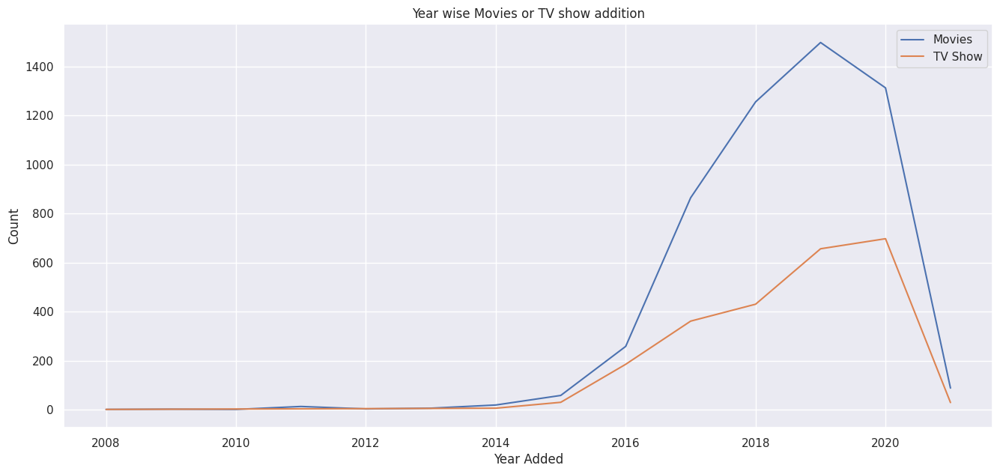

In [ ]:
#Plotting a line graph
plt.figure(figsize = (16,7))
plt.plot('index', 'year_added', data = yr_added_movie, label = 'Movies')
plt.plot('index', 'year_added', data =yr_added_tv, label = 'TV Show')
plt.title('Year wise Movies or TV show addition')
plt.xlabel('Year Added')
plt.ylabel('Count')
plt.legend()
plt.show

From the above graph also we can infer that number of movie addition has decresed after 2019 whereas number of TV Show addition has increased after 2019.

This shows that netflix is focusing more on TV shows

#### 5. Is number of movies has decreased by more than 2,000 titles since 2010, while its number of TV shows has nearly tripled?

In [ ]:
#Number of TV shows & Movies till 2010
nf_df[nf_df['year_added'] <= 2010]['type'].value_counts().reset_index()

,index,type
0,Movie,4
1,TV Show,1


There are only 4 movies & 1 TV Show till 2010.

In [ ]:
#Number of TV shows & Movies till 2017
nf_df[nf_df['year_added']< 2018]['type'].value_counts().reset_index()

,index,type
0,Movie,1225
1,TV Show,588


Till year 2017 number of movies became 1225 and number of TV Show became 588.

In [ ]:
#Now let's check the Movie and TV count from 2019 to 2021.
nf_df[nf_df['year_added'] >= 2018]['type'].value_counts().reset_index()

,index,type
0,Movie,4152
1,TV Show,1812


* *The above data shows that number of movies have increased from 1225 to 4152 from year 2017 to year 2021 number of movies has not decreased as shown in the report.*
* *The number of TV Shows have increased from 588 in 2017 to 1812 in 2021. Number of TV Shows have increased more than three times. This statement is truely mentioned in the report.*

## ***5. Data Pre-processing For Text Based Clustering***

### 1. Initial Preprocessing Steps

We will cluster the shows on Netflix based on the following attributes:

* Director
* Cast
* Country
* Listed in (genres)
* Description

In [ ]:
#Creating a new dataset for clustering
nf_df_clus = nf_df_org.copy()
nf_df_clus.fillna("", inplace = True)

#Combining all the clustering attributes into a new column
nf_df_clus['clustered_attributes'] = (nf_df_clus['director'] + ' ' + nf_df_clus['cast'] +' ' + nf_df_clus['country'] +' ' + nf_df_clus['listed_in'] +' ' + nf_df_clus['description'])

In [ ]:
#Checking any one row
nf_df_clus['clustered_attributes'][18]

"Swapnaneel Jayakar Rahul Pethe, Mrunmayee Deshpande, Adinath Kothare, Vaibhav Mangale, Jaywant Wadkar, Satish Pulekar, Naina Apte, Uday Tikekar India Comedies, Dramas, Independent Movies On India's Independence Day, a zany mishap in a Mumbai chawl disrupts a young love story while compelling the residents to unite in aid of a little boy."

In [ ]:
#Checking the head of newly created dataset for clustering
nf_df_clus.head()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description,clustered_attributes
0,s1,TV Show,3%,,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,"August 14, 2020",2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...,"João Miguel, Bianca Comparato, Michel Gomes, ..."
1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,"December 23, 2016",2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...,"Jorge Michel Grau Demián Bichir, Héctor Bonill..."
2,s3,Movie,23:59,Gilbert Chan,"Tedd Chan, Stella Chung, Henley Hii, Lawrence ...",Singapore,"December 20, 2018",2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow...","Gilbert Chan Tedd Chan, Stella Chung, Henley H..."
3,s4,Movie,9,Shane Acker,"Elijah Wood, John C. Reilly, Jennifer Connelly...",United States,"November 16, 2017",2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi...","Shane Acker Elijah Wood, John C. Reilly, Jenni..."
4,s5,Movie,21,Robert Luketic,"Jim Sturgess, Kevin Spacey, Kate Bosworth, Aar...",United States,"January 1, 2020",2008,PG-13,123 min,Dramas,A brilliant group of students become card-coun...,"Robert Luketic Jim Sturgess, Kevin Spacey, Kat..."


### 2. Removing non-ASCII characters

Since there are lot's of non ASCII characters in the dataste we will first remove the non - ASCII characters from the dataset.

In [ ]:
# Function to remove non-ASCII characters
def remove_non_ASCII(words):
    """This function removes the non-ASCII characters"""
    new_words = []
    for chars in words:
        new_word = unicodedata.normalize('NFKD', chars).encode('ascii', 'ignore').decode('utf-8', 'ignore')
        new_words.append(new_word)
    return new_words

In [ ]:
# Removing non-ascii characters
nf_df_clus['clustered_attributes'] = remove_non_ASCII(nf_df_clus['clustered_attributes'])

In [ ]:
#Checking any one row after remvoing the non-ASCII characters
nf_df_clus['clustered_attributes'][18]

"Swapnaneel Jayakar Rahul Pethe, Mrunmayee Deshpande, Adinath Kothare, Vaibhav Mangale, Jaywant Wadkar, Satish Pulekar, Naina Apte, Uday Tikekar India Comedies, Dramas, Independent Movies On India's Independence Day, a zany mishap in a Mumbai chawl disrupts a young love story while compelling the residents to unite in aid of a little boy."

###3. Removing stopwords and converting all chars to lower case

In [ ]:
# Extracting the stopwords from nltk library
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
sw = stopwords.words('english')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
# Printing stopwords
print(list(sw))

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

In [ ]:
# function to remove stopwords
def remove_stopwords(text):
    '''This function removes stopwords'''
    # Code to remove the stop words and lowercase the selected words
    text = [word.lower() for word in text.split() if word not in sw]
    return " ".join(text)

In [ ]:
# Removing stopwords
nf_df_clus['clustered_attributes'] = nf_df_clus['clustered_attributes'].apply(remove_stopwords)

In [ ]:
#Checking any one row after remvoing stopwords converting all the chars to lowercase
nf_df_clus['clustered_attributes'][18]

"swapnaneel jayakar rahul pethe, mrunmayee deshpande, adinath kothare, vaibhav mangale, jaywant wadkar, satish pulekar, naina apte, uday tikekar india comedies, dramas, independent movies on india's independence day, zany mishap mumbai chawl disrupts young love story compelling residents unite aid little boy."

### 4. Removing Punctuations

In [ ]:
# Function to remove punctuations
def punctuation_remove(text):
    '''This function will remove punctuations from the passed sentence.'''
    translator = str.maketrans('','',string.punctuation)
    return text.translate(translator)

In [ ]:
#Removing all the punctuations
nf_df_clus['clustered_attributes'] = nf_df_clus['clustered_attributes'].apply(punctuation_remove)

In [ ]:
#Checking any one row after remvoing punctuations
nf_df_clus['clustered_attributes'][18]

'swapnaneel jayakar rahul pethe mrunmayee deshpande adinath kothare vaibhav mangale jaywant wadkar satish pulekar naina apte uday tikekar india comedies dramas independent movies on indias independence day zany mishap mumbai chawl disrupts young love story compelling residents unite aid little boy'

### 5. Lemmatization

In [ ]:
#Function for implementing lemmatization
def lemmatize_verbs(words):
    """This function will lemmatize the passed sentence"""
    lemmatizer = WordNetLemmatizer()
    lemmas = []
    for word in words:
      lemma = lemmatizer.lemmatize(word , pos = 'v')
      lemmas.append(lemma)
    return lemmas

Lemmatisation is the process of grouping together the inflected forms of a word so they can be analysed as a single item.

In [ ]:
#Doing lemmatization of words
nf_df_clus['clustered_attributes'] = lemmatize_verbs(nf_df_clus['clustered_attributes'])

In [ ]:
#Checking any one row after doing lemmatization
nf_df_clus['clustered_attributes'][18]

'swapnaneel jayakar rahul pethe mrunmayee deshpande adinath kothare vaibhav mangale jaywant wadkar satish pulekar naina apte uday tikekar india comedies dramas independent movies on indias independence day zany mishap mumbai chawl disrupts young love story compelling residents unite aid little boy'

### 6. Tokenization

Tokenization is the process of tokenizing or splitting a string, text into a list of tokens.

In [ ]:
tokenizer = TweetTokenizer()

In [ ]:
#Doing tokenization of words
nf_df_clus['clustered_attributes'] = nf_df_clus['clustered_attributes'].apply(lambda x: tokenizer.tokenize(x))

In [ ]:
#Checking any one row after tokenization
nf_df_clus['clustered_attributes'][18]

['swapnaneel',
 'jayakar',
 'rahul',
 'pethe',
 'mrunmayee',
 'deshpande',
 'adinath',
 'kothare',
 'vaibhav',
 'mangale',
 'jaywant',
 'wadkar',
 'satish',
 'pulekar',
 'naina',
 'apte',
 'uday',
 'tikekar',
 'india',
 'comedies',
 'dramas',
 'independent',
 'movies',
 'on',
 'indias',
 'independence',
 'day',
 'zany',
 'mishap',
 'mumbai',
 'chawl',
 'disrupts',
 'young',
 'love',
 'story',
 'compelling',
 'residents',
 'unite',
 'aid',
 'little',
 'boy']

### 7. Vectorization

Word Embeddings or Word vectorization is a methodology in NLP to map words or phrases from vocabulary to a corresponding vector of real numbers which used to find word predictions, word similarities/semantics. 

We can vectorize the words using TFIDF (Term Frequency Inverse Document Frequency) vectorizer.

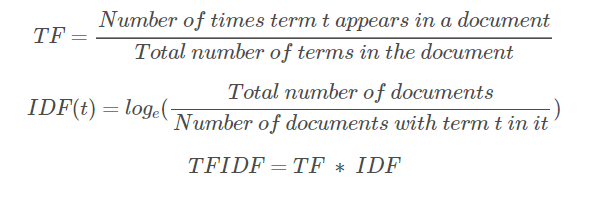

In [ ]:
#Making a variable for the clustering data
clus_data = nf_df_clus['clustered_attributes']

In [ ]:
# Tokenization
def identity_tokenizer(text):
    return text

# Using TFIDF vectorizer to vectorize the words 
# max features = 20000 to prevent system from crashing
tfidf = TfidfVectorizer(tokenizer=identity_tokenizer, stop_words='english', lowercase=False,max_features = 20000)    
X = tfidf.fit_transform(clus_data)

/usr/local/lib/python3.9/dist-packages/sklearn/feature_extraction/text.py:528: UserWarning:

The parameter 'token_pattern' will not be used since 'tokenizer' is not None'

/usr/local/lib/python3.9/dist-packages/sklearn/feature_extraction/text.py:409: UserWarning:

Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['b', 'c', 'd', 'e', 'f', 'g', 'h', 'k', 'l', 'm', 'n', 'o', 'p', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y'] not in stop_words.



In [ ]:
X

<7787x20000 sparse matrix of type '<class 'numpy.float64'>'
	with 235396 stored elements in Compressed Sparse Row format>

In [ ]:
#Checking shape of X
X.shape

(7787, 20000)

In [ ]:
# convert X into array form for clustering
X = X.toarray()

### 8. Dimensionality reduction using PCA (Principal component Analysis)

In [ ]:
#PCA to reduce dimensionality
pca = PCA(random_state = 40)
pca.fit(X)

PCA(random_state=40)

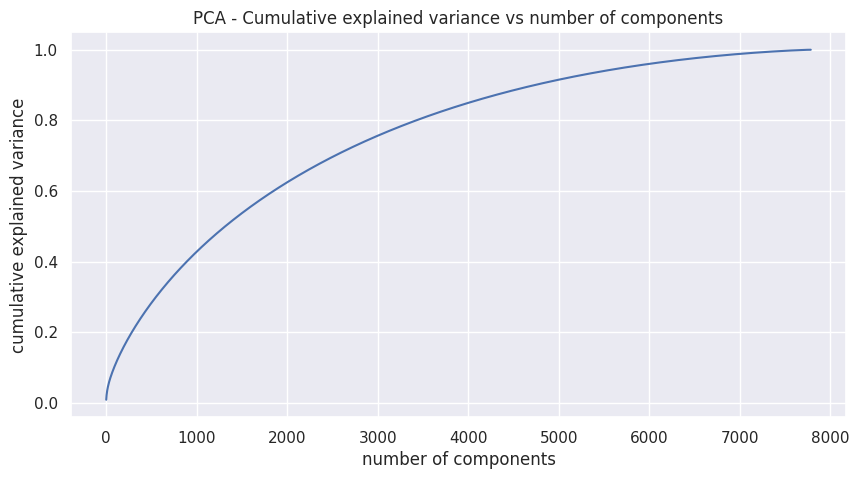

In [ ]:
#Plotting PCA curve
plt.figure(figsize=(10,5))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.title('PCA - Cumulative explained variance vs number of components')
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.show()

We can infer following information from the above graph -

* 100% of the variance is explained by about 7500 components.
* More than 80% of the variance is explained just by 4000 components.
* Hence to simplify the model, and reduce dimensionality, we can take the top 4000 components, which will still be able to capture more than 80% of variance.

In [ ]:
#Reducing the dimensions to 4000 using pca
pca = PCA(n_components=4000,random_state=40)
pca.fit(X)

PCA(n_components=4000, random_state=40)

In [ ]:
#Transformed features
x_pca = pca.transform(X)

In [ ]:
#Shape of transformed features
x_pca.shape

(7787, 4000)

## ***6. ML Model Implementation***

### 1. K-Means Clustering

#### Elbow method to find the optimal value of k

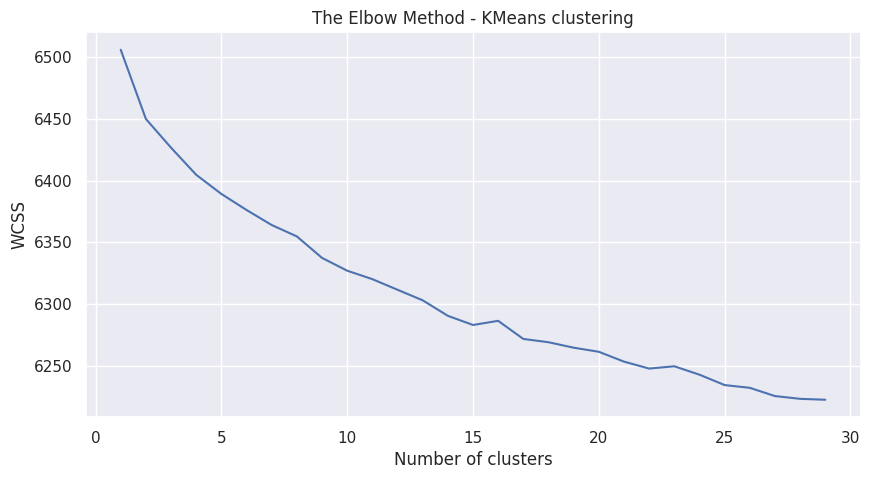

In [ ]:
# Elbow method to find the optimal value of k
wcss=[]
for i in range(1,30):
  kmeans = KMeans(n_clusters=i,init='k-means++',max_iter=300, n_init=10, random_state=33)
  kmeans.fit(x_pca)
  wcss_iter = kmeans.inertia_
  wcss.append(wcss_iter)

number_clusters = range(1,30)
plt.figure(figsize=(10,5))
plt.plot(number_clusters,wcss)
plt.title('The Elbow Method - KMeans clustering')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

The sum of squared distance between each point and the centroid in a cluster (WCSS) decreases with the increase in the number of clusters. This does'nt shows a good representation to select the optimal value of k.

#### Fitting the model & Visualizing the fit

In [ ]:
# Clustering the data into 9 clusters
kmeans = KMeans(n_clusters=9,init='k-means++',random_state=33)
kmeans.fit(x_pca)

/usr/local/lib/python3.9/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



KMeans(n_clusters=9, random_state=33)

In [ ]:
# Evaluation metrics - distortion, Silhouette score
kmeans_distortion = kmeans.inertia_
kmeans_silhouette_score = silhouette_score(x_pca, kmeans.labels_)

print(f'Distortion - {kmeans_distortion} \nSilhouette Coefficient - {kmeans_silhouette_score}')

Distortion - 6337.348706356553 
Silhouette Coefficient - 0.002529966520846456


Silhouette coefficient comes out to be 0.003.

In [ ]:
#Predicting the labels for clusters.
label = kmeans.fit_predict(x_pca)

/usr/local/lib/python3.9/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



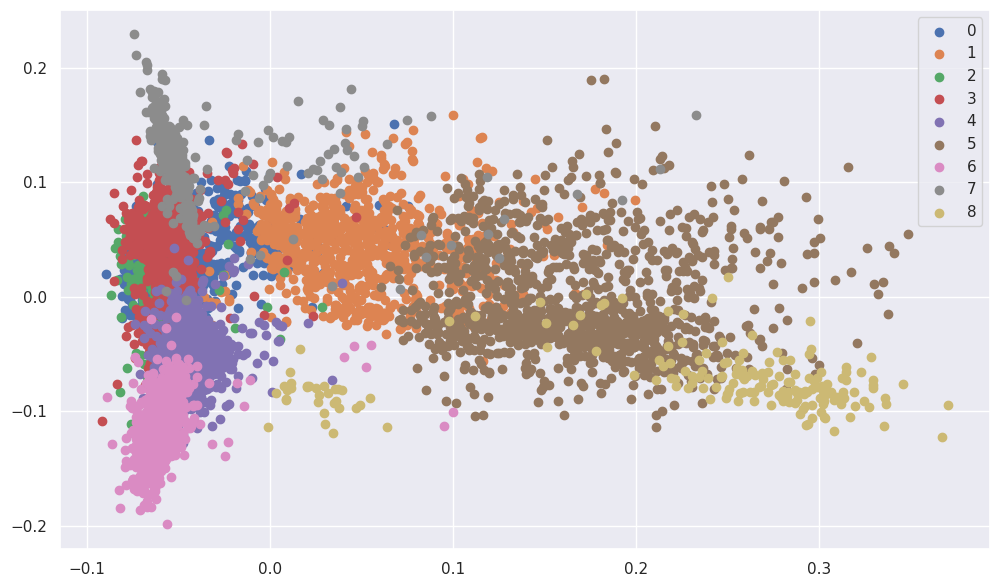

In [ ]:
#Getting unique labels
u_labels = np.unique(label)
 
#Plotting the clustered labels:
plt.figure(figsize = (12, 7))
for i in u_labels:
    plt.scatter(x_pca[label == i , 0] , x_pca[label == i , 1] , label = i)
plt.legend()
plt.show()

#### Labeling the dataset as per cluster

In [ ]:
# Adding a kmeans cluster label as feature to our dataset
nf_df_clus['kmeans_cluster'] = kmeans.labels_

In [ ]:
# Checking the head
nf_df_clus.head()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description,clustered_attributes,kmeans_cluster
0,s1,TV Show,3%,,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,"August 14, 2020",2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...,"[joao, miguel, bianca, comparato, michel, gome...",5
1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,"December 23, 2016",2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...,"[jorge, michel, grau, demian, bichir, hector, ...",4
2,s3,Movie,23:59,Gilbert Chan,"Tedd Chan, Stella Chung, Henley Hii, Lawrence ...",Singapore,"December 20, 2018",2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow...","[gilbert, chan, tedd, chan, stella, chung, hen...",4
3,s4,Movie,9,Shane Acker,"Elijah Wood, John C. Reilly, Jennifer Connelly...",United States,"November 16, 2017",2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi...","[shane, acker, elijah, wood, john, c, reilly, ...",0
4,s5,Movie,21,Robert Luketic,"Jim Sturgess, Kevin Spacey, Kate Bosworth, Aar...",United States,"January 1, 2020",2008,PG-13,123 min,Dramas,A brilliant group of students become card-coun...,"[robert, luketic, jim, sturgess, kevin, spacey...",0


#### Visualizing the number of TV Show and Movies in each cluster

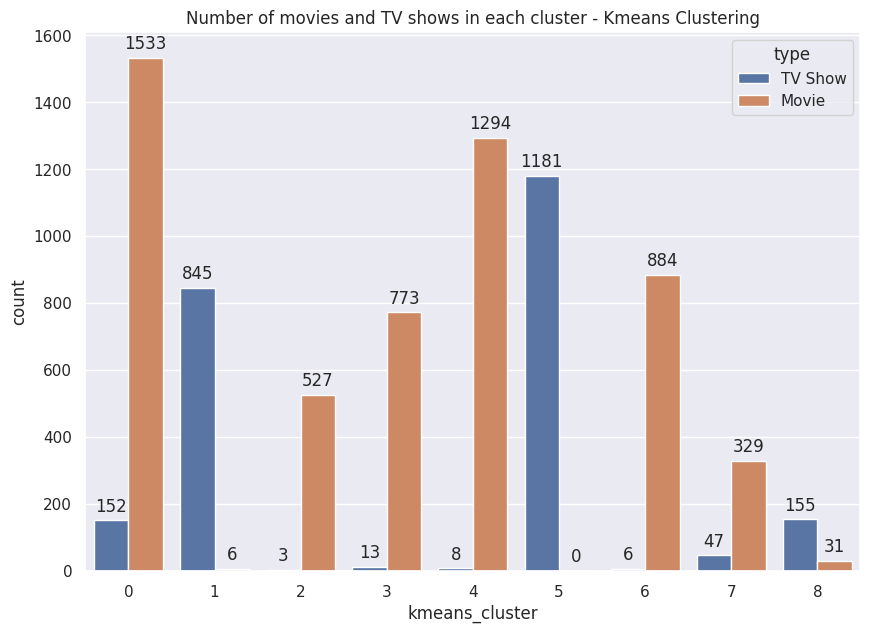

In [ ]:
#Plotting number of TV Show and Movie in each cluster
plt.figure(figsize=(10,7))
plot = sns.countplot(x='kmeans_cluster',data=nf_df_clus, hue='type')
plt.title('Number of movies and TV shows in each cluster - Kmeans Clustering')
for i in plot.patches:
  plot.annotate(format(i.get_height(), '.0f'), (i.get_x() + i.get_width() / 2., i.get_height()), ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

#### Plotting the wordcloud on description for each cluster built

Cluster - 0


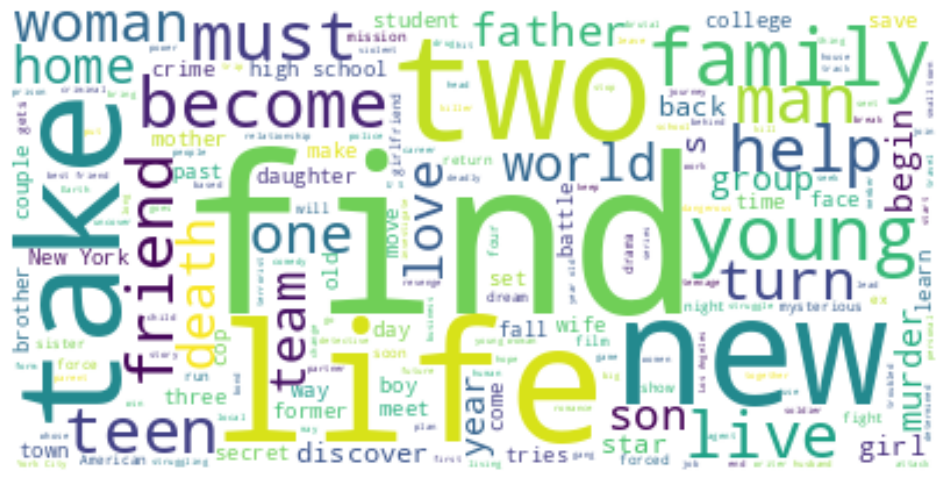



Cluster - 1


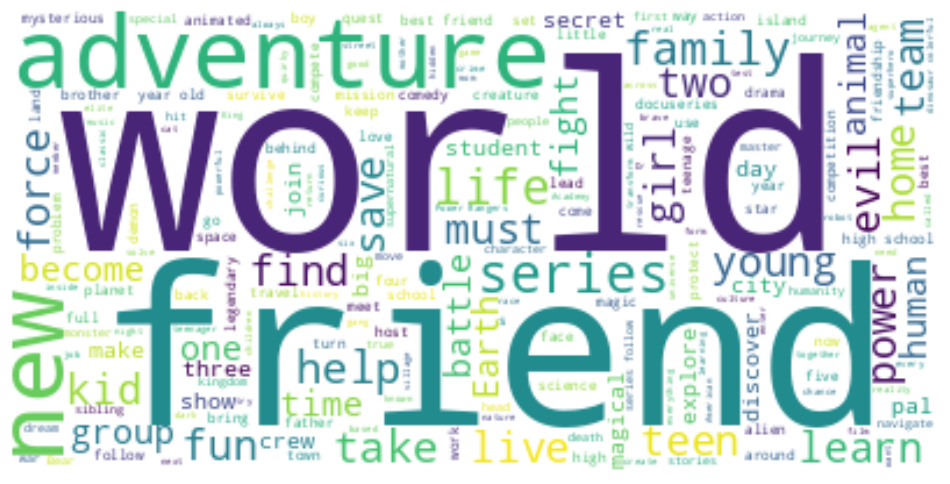



Cluster - 2


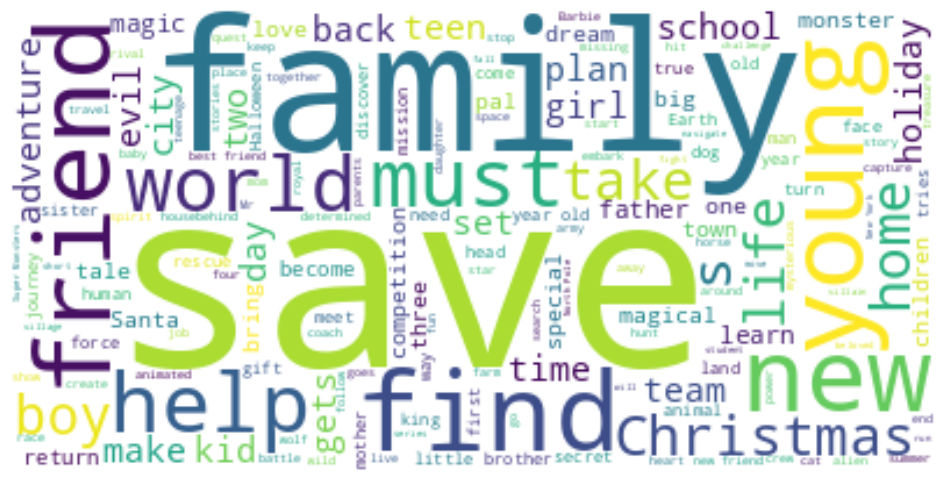



Cluster - 3


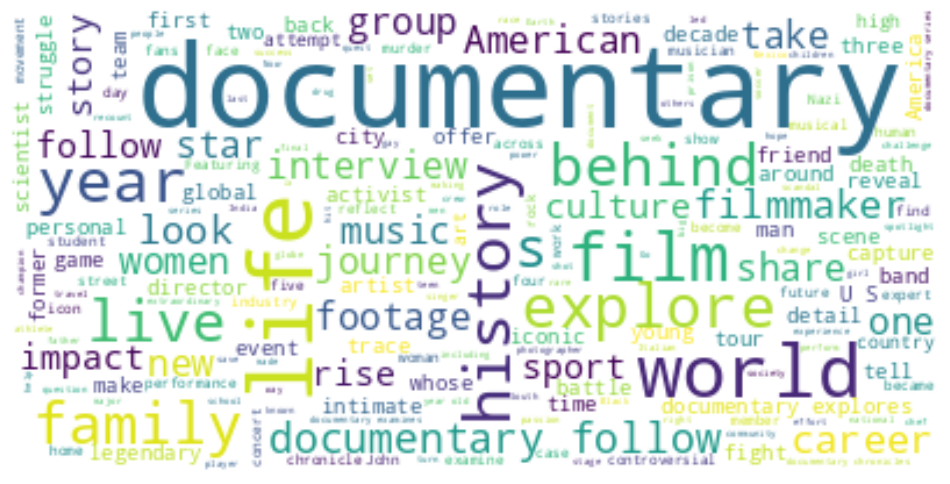



Cluster - 4


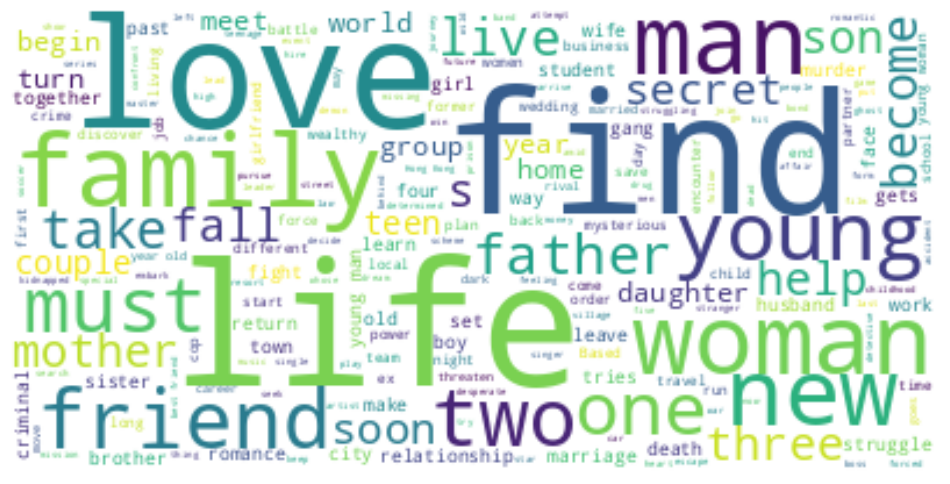



Cluster - 5


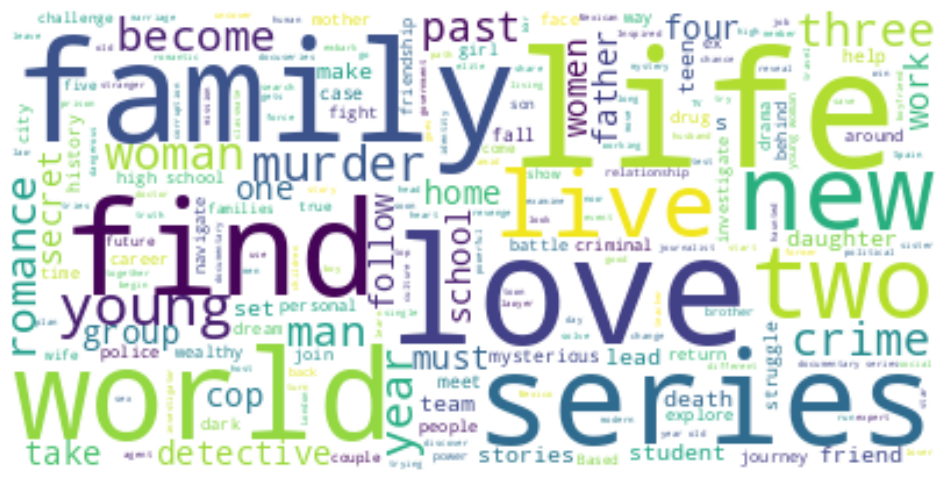



Cluster - 6


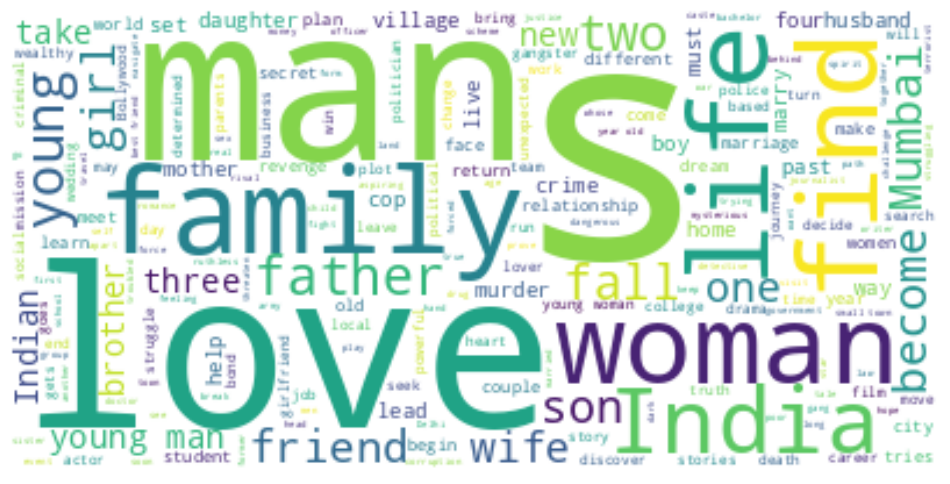



Cluster - 7


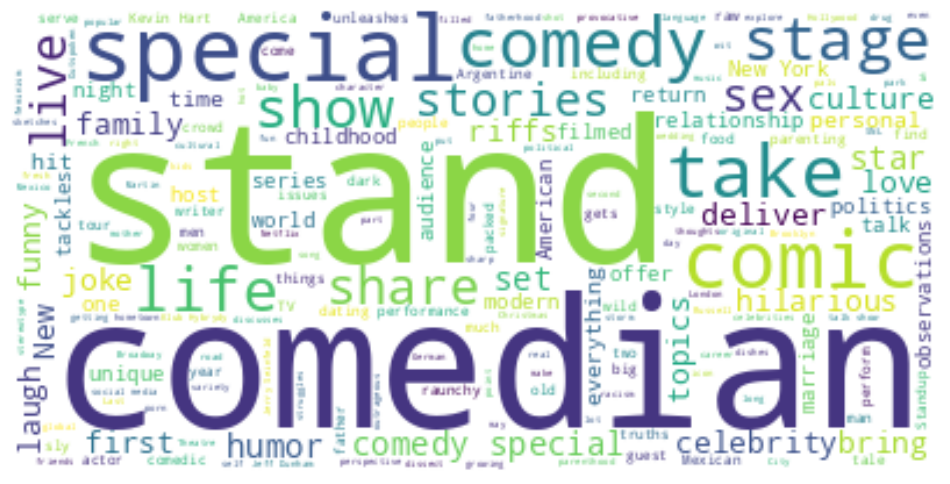



Cluster - 8


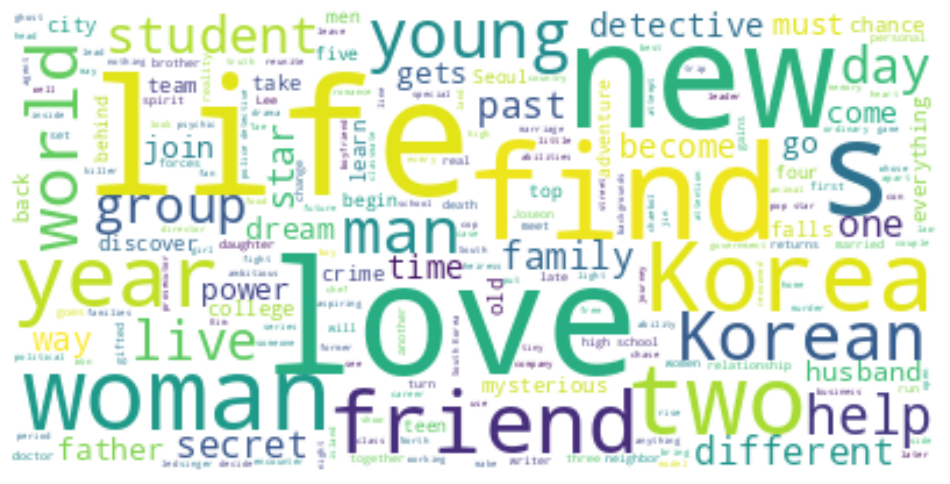

In [ ]:
for i in range(0, 9):
  print(f'Cluster - {i}')
  col_word_cloud('description', nf_df_clus[nf_df_clus['kmeans_cluster'] == i])
  print("\n")

Following are the keyword observed in each cluster - 

1. Cluster 0 - Find, take, life, new, two, woman.
2. Cluster 1 - world, adventure, friend, series.
3. Cluster 2 - find, family, save, world
4. Cluster 3 - documentary, world, life, family.
5. Cluster 4 - love, find, life, friend
6. Cluster 5 - find, family, love,world, series
7. Cluster 6 - man, love, woman, india
8. Cluster 7 - stand, special, comedian, comic.
9. Cluster 8 - life, find korea, love

#### Displaying the genre wise cluster distribution

Cluster 0 -

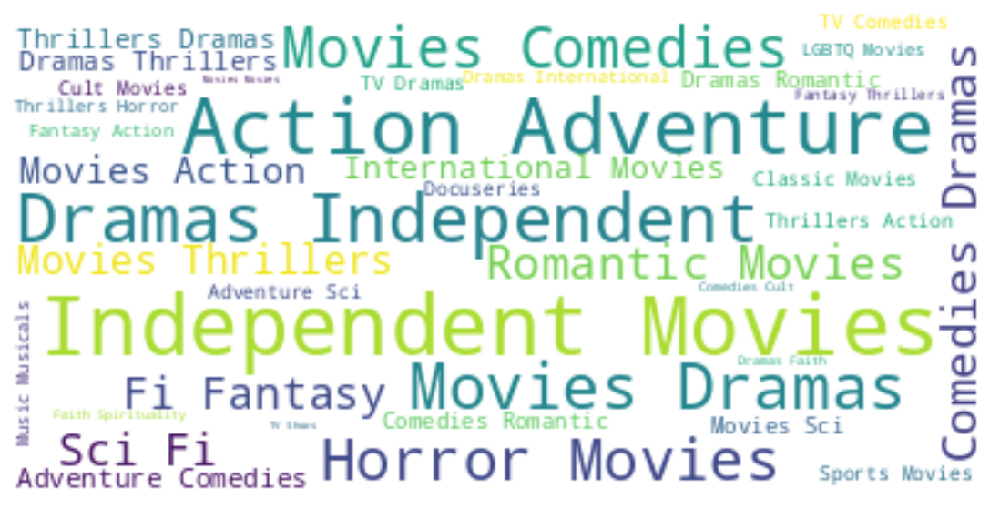

In [ ]:
# Plotting word cloud for cluster 0
col_word_cloud('listed_in', nf_df_clus[nf_df_clus['kmeans_cluster'] == 0])

***Action Adventure, Dramas Independent, Independent movies***

In [ ]:
nf_df_clus[nf_df_clus['kmeans_cluster'] == 0][['type','title','director','cast','country','rating','listed_in','description']]

,type,title,director,cast,country,rating,listed_in,description
3,Movie,9,Shane Acker,"Elijah Wood, John C. Reilly, Jennifer Connelly...",United States,PG-13,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi..."
4,Movie,21,Robert Luketic,"Jim Sturgess, Kevin Spacey, Kate Bosworth, Aar...",United States,PG-13,Dramas,A brilliant group of students become card-coun...
7,Movie,187,Kevin Reynolds,"Samuel L. Jackson, John Heard, Kelly Rowan, Cl...",United States,R,Dramas,After one of his high school students attacks ...
10,Movie,1922,Zak Hilditch,"Thomas Jane, Molly Parker, Dylan Schmid, Kaitl...",United States,TV-MA,"Dramas, Thrillers",A farmer pens a confession admitting to his wi...
14,Movie,3022,John Suits,"Omar Epps, Kate Walsh, Miranda Cosgrove, Angus...",United States,R,"Independent Movies, Sci-Fi & Fantasy, Thrillers",Stranded when the Earth is suddenly destroyed ...
...,...,...,...,...,...,...,...,...
7735,TV Show,Young & Hungry,,"Emily Osment, Kym Whitley, Rex Lee, Jonathan S...",United States,TV-14,TV Comedies,A female food blogger is hired as a personal c...
7736,Movie,Young Adult,Jason Reitman,"Charlize Theron, Patton Oswalt, Patrick Wilson...",United States,R,"Comedies, Dramas, Independent Movies",When a divorced writer gets a letter from an o...
7758,Movie,Zack and Miri Make a Porno,Kevin Smith,"Seth Rogen, Elizabeth Banks, Craig Robinson, J...",United States,R,"Comedies, Independent Movies, Romantic Movies",Zack and Miri make and star in an adult film t...
7774,Movie,Zodiac,David Fincher,"Mark Ruffalo, Jake Gyllenhaal, Robert Downey J...",United States,R,"Cult Movies, Dramas, Thrillers","A political cartoonist, a crime reporter and a..."


Cluster 1 - 

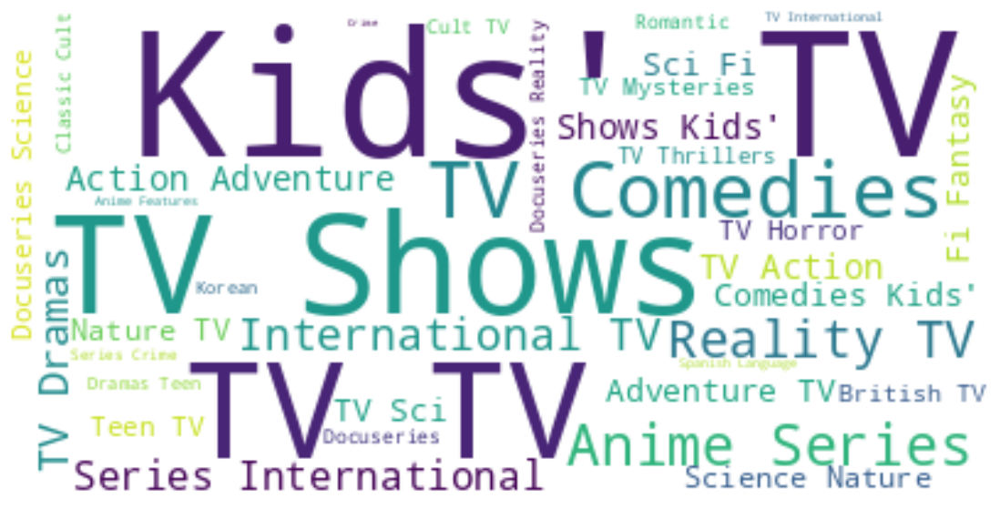

In [ ]:
# Plotting word cloud for cluster 1
col_word_cloud('listed_in', nf_df_clus[nf_df_clus['kmeans_cluster'] == 1])

***Kids TV, TV shows*** 

In [ ]:
nf_df_clus[nf_df_clus['kmeans_cluster'] == 1][['type','title','director','cast','country','rating','listed_in','description']]

,type,title,director,cast,country,rating,listed_in,description
24,TV Show,​SAINT SEIYA: Knights of the Zodiac,,"Bryson Baugus, Emily Neves, Blake Shepard, Pat...",Japan,TV-14,"Anime Series, International TV Shows",Seiya and the Knights of the Zodiac rise again...
26,TV Show,(Un)Well,,,United States,TV-MA,Reality TV,This docuseries takes a deep dive into the luc...
29,TV Show,#blackAF,,"Kenya Barris, Rashida Jones, Iman Benson, Genn...",United States,TV-MA,TV Comedies,Kenya Barris and his family navigate relations...
53,TV Show,100 Humans,,"Zainab Johnson, Sammy Obeid, Alie Ward",United States,TV-14,"Docuseries, Science & Nature TV",One hundred hardy souls from diverse backgroun...
108,TV Show,3Below: Tales of Arcadia,,"Tatiana Maslany, Diego Luna, Nick Offerman, Ni...",United States,TV-Y7,"Kids' TV, TV Action & Adventure, TV Sci-Fi & F...","After crash-landing on Earth, two royal teen a..."
...,...,...,...,...,...,...,...,...
7755,TV Show,Z Nation,,"Nat Zang, Russell Hodgkinson, Michael Welch, A...",United States,TV-MA,"TV Action & Adventure, TV Comedies, TV Horror",A team embarks on a perilous cross-country mis...
7756,TV Show,Z4,,"Apollo Costa, Gabriel Santana, Matheus Lustosa...",Brazil,TV-PG,Kids' TV,Fading music biz veteran Zé realizes he has ju...
7759,TV Show,Zak Storm,,"Michael Johnston, Jessica Gee-George, Christin...","United States, France, South Korea, Indonesia",TV-Y7,Kids' TV,Teen surfer Zak Storm is mysteriously transpor...
7766,TV Show,Zig & Sharko,,,France,TV-Y7,"Kids' TV, TV Comedies","Zig, an island-bound hyena, will do anything t..."


Cluster 2 -

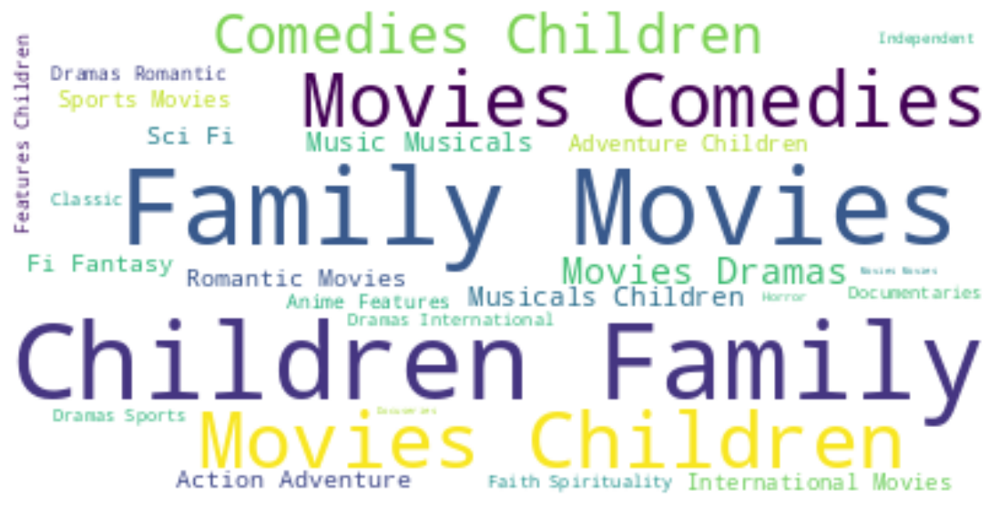

In [ ]:
# Plotting word cloud for cluster 2
col_word_cloud('listed_in', nf_df_clus[nf_df_clus['kmeans_cluster'] == 2])

***Comedies, Family Movies, Independent Movies***

In [ ]:
nf_df_clus[nf_df_clus['kmeans_cluster'] == 2][['type','title','director','cast','country','rating','listed_in','description']]

,type,title,director,cast,country,rating,listed_in,description
113,Movie,48 Christmas Wishes,"Marco Deufemia, Justin G. Dyck","Khiyla Aynne, Noah Dyer, Maya Franzoi, Clara K...",Canada,TV-G,"Children & Family Movies, Comedies",When a small town's letters to Santa accidenta...
145,Movie,A 2nd Chance,Clay Glen,"Nina Pearce, Adam Tuominen, Emily Morris, Amy ...",Australia,PG,"Children & Family Movies, Dramas, Sports Movies",A gymnast lacks the confidence she needs to re...
147,Movie,A Babysitter's Guide to Monster Hunting,Rachel Talalay,"Tamara Smart, Oona Laurence, Tom Felton, Troy ...",United States,TV-PG,Children & Family Movies,"Recruited by a secret society of babysitters, ..."
155,Movie,A Champion Heart,David de Vos,"Mandy Grace, David de Vos, Donna Rusch, Devan ...",United States,G,"Children & Family Movies, Dramas",When a grieving teen must work off her debt to...
159,Movie,A Christmas Prince,Alex Zamm,"Rose McIver, Ben Lamb, Alice Krige, Honor Knea...",United States,TV-PG,"Children & Family Movies, Dramas, Romantic Movies",Christmas comes early for an aspiring young jo...
...,...,...,...,...,...,...,...,...
7723,Movie,You Can Tutu,James Brown,"Lily O'Regan, Jeannettsy Enriquez Borges, Joel...",United Kingdom,TV-G,Children & Family Movies,A gifted young ballet dancer struggles to find...
7745,Movie,"Yours, Mine and Ours",Raja Gosnell,"Dennis Quaid, Rene Russo, Sean Faris, Katija P...",United States,PG,"Children & Family Movies, Comedies",When a father of eight and a mother of 10 prep...
7761,Movie,Zapped,Peter DeLuise,"Zendaya, Chanelle Peloso, Spencer Boldman, Emi...","Canada, United States",TV-Y,"Children & Family Movies, Comedies",A girl discovers a dog-training app that can g...
7772,Movie,Zipi & Zape y la Isla del Capitan,Oskar Santos,"Teo Planell, Toni Gómez, Elena Anaya, Iria Cas...",Spain,TV-PG,"Children & Family Movies, Comedies","At Christmas, Zip and Zap take a trip with the..."


Cluster 3 - 

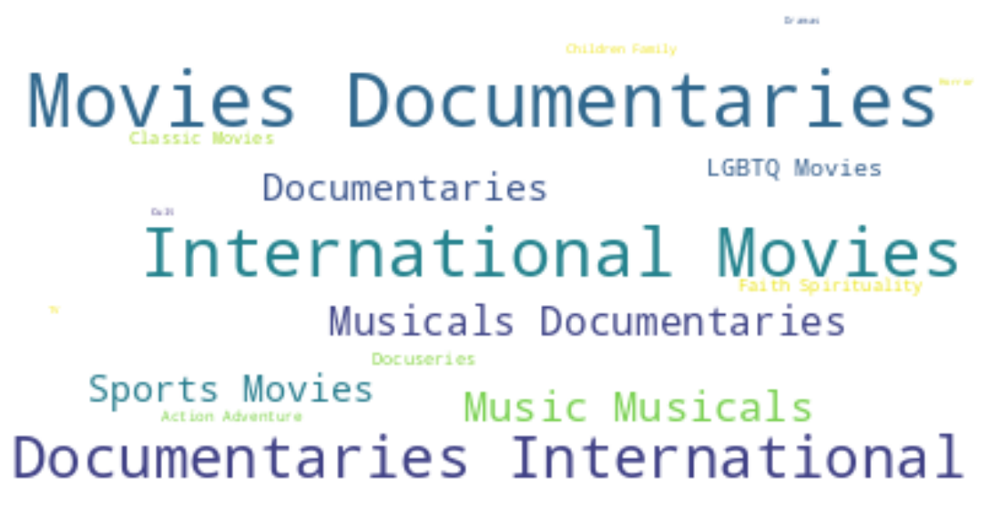

In [ ]:
# Plotting word cloud for cluster 3
col_word_cloud('listed_in', nf_df_clus[nf_df_clus['kmeans_cluster'] == 3])

***International movies, Documentaries international, Movies documentaries***

In [ ]:
nf_df_clus[nf_df_clus['kmeans_cluster'] == 3][['type','title','director','cast','country','rating','listed_in','description']]

,type,title,director,cast,country,rating,listed_in,description
13,Movie,"2,215",Nottapon Boonprakob,Artiwara Kongmalai,Thailand,TV-MA,"Documentaries, International Movies, Sports Mo...",This intimate documentary follows rock star Ar...
19,Movie,'89,,"Lee Dixon, Ian Wright, Paul Merson",United Kingdom,TV-PG,Sports Movies,"Mixing old footage with interviews, this is th..."
25,Movie,(T)ERROR,"Lyric R. Cabral, David Felix Sutcliffe",,United States,NR,Documentaries,This real-life look at FBI counterterrorism op...
28,Movie,#AnneFrank - Parallel Stories,"Sabina Fedeli, Anna Migotto","Helen Mirren, Gengher Gatti",Italy,TV-14,"Documentaries, International Movies","Through her diary, Anne Frank's story is retol..."
30,Movie,#cats_the_mewvie,Michael Margolis,,Canada,TV-14,"Documentaries, International Movies",This pawesome documentary explores how our fel...
...,...,...,...,...,...,...,...,...
7692,Movie,Ya no estoy aquí: Una conversación entre Guill...,,"Guillermo del Toro, Alfonso Cuarón",,TV-PG,Documentaries,Guillermo del Toro and Alfonso Cuarón discuss ...
7771,Movie,Zion,Floyd Russ,Zion Clark,United States,TV-PG,"Documentaries, Sports Movies",Born without legs and stuck in foster care for...
7773,Movie,Zoé: Panoramas,"Rodrigo Guardiola, Gabriel Cruz Rivas","Sergio Acosta, Jesús Báez, Ángel Mosqueda, Rod...",Mexico,TV-MA,"Documentaries, International Movies, Music & M...",This introspective rockumentary follows the ca...
7784,Movie,Zulu Man in Japan,,Nasty C,,TV-MA,"Documentaries, International Movies, Music & M...","In this documentary, South African rapper Nast..."


Cluster 4 - 

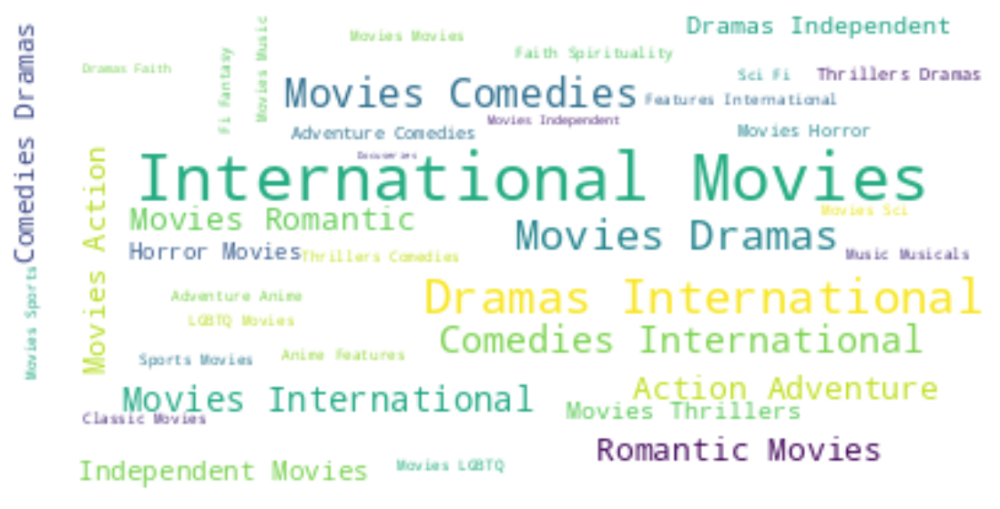

In [ ]:
# Plotting word cloud for cluster 4
col_word_cloud('listed_in', nf_df_clus[nf_df_clus['kmeans_cluster'] == 4])

***International movies, Romantic movies***

In [ ]:
nf_df_clus[nf_df_clus['kmeans_cluster'] == 4][['type','title','director','cast','country','rating','listed_in','description']]

,type,title,director,cast,country,rating,listed_in,description
1,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,TV-MA,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...
2,Movie,23:59,Gilbert Chan,"Tedd Chan, Stella Chung, Henley Hii, Lawrence ...",Singapore,R,"Horror Movies, International Movies","When an army recruit is found dead, his fellow..."
6,Movie,122,Yasir Al Yasiri,"Amina Khalil, Ahmed Dawood, Tarek Lotfy, Ahmed...",Egypt,TV-MA,"Horror Movies, International Movies","After an awful accident, a couple admitted to ..."
15,Movie,Oct-01,Kunle Afolayan,"Sadiq Daba, David Bailie, Kayode Olaiya, Kehin...",Nigeria,TV-14,"Dramas, International Movies, Thrillers",Against the backdrop of Nigeria's looming inde...
27,Movie,#Alive,Cho Il,"Yoo Ah-in, Park Shin-hye",South Korea,TV-MA,"Horror Movies, International Movies, Thrillers","As a grisly virus rampages a city, a lone man ..."
...,...,...,...,...,...,...,...,...
7751,Movie,Yucatán,Daniel Monzón,"Luis Tosar, Rodrigo de la Serna, Joan Pera, St...",Spain,TV-MA,"Comedies, International Movies",Competing con artists attempt to creatively an...
7760,Movie,Zaki Chan,Wael Ihsan,"Ahmed Helmy, Yasmin Abdulaziz, Hassan Hosny, H...",Egypt,TV-PG,"Comedies, International Movies, Romantic Movies",An unqualified young man has his work cut out ...
7765,Movie,Zero Hour,Robert O. Peters,"Richard Mofe-Damijo, Alex Ekubo, Ali Nuhu, Rah...",,TV-MA,"International Movies, Thrillers","After his father passes, the heir to a retail ..."
7770,Movie,Zinzana,Majid Al Ansari,"Ali Suliman, Saleh Bakri, Yasa, Ali Al-Jabri, ...","United Arab Emirates, Jordan",TV-MA,"Dramas, International Movies, Thrillers",Recovering alcoholic Talal wakes up inside a s...


Cluster 5 -

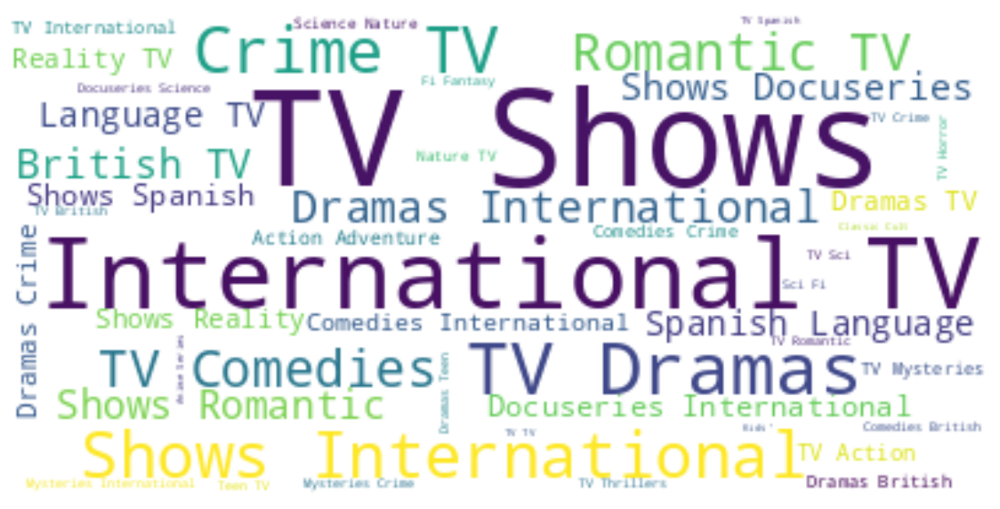

In [ ]:
# Plotting word cloud for cluster 5
col_word_cloud('listed_in', nf_df_clus[nf_df_clus['kmeans_cluster'] == 5])

***TV Shows and International TV***

In [ ]:
nf_df_clus[nf_df_clus['kmeans_cluster'] == 5][['type','title','director','cast','country','rating','listed_in','description']]

Cluster 6 -

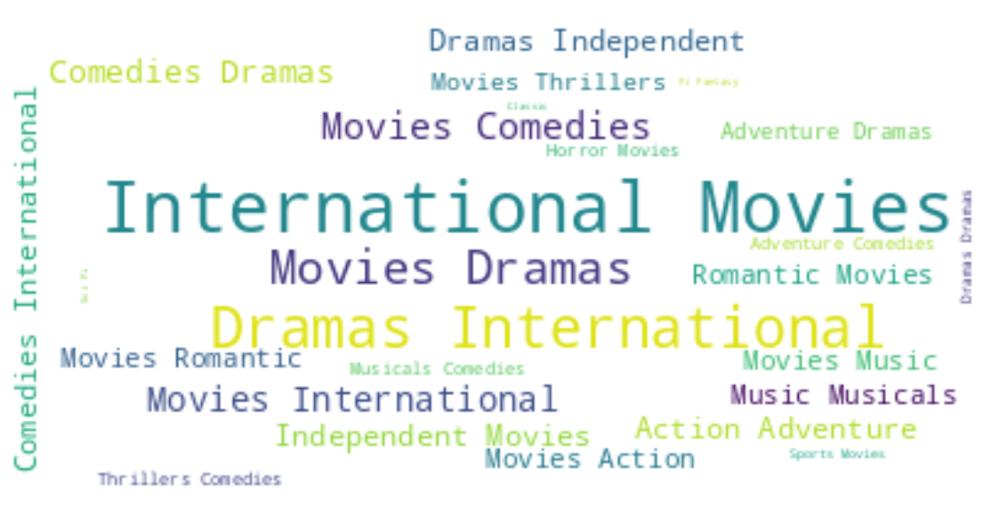

In [ ]:
# Plotting word cloud for cluster 6
col_word_cloud('listed_in', nf_df_clus[nf_df_clus['kmeans_cluster'] == 6])

***International Movies, Dramas international***

In [ ]:
nf_df_clus[nf_df_clus['kmeans_cluster'] == 6][['type','title','director','cast','country','rating','listed_in','description']]

,type,title,director,cast,country,rating,listed_in,description
8,Movie,706,Shravan Kumar,"Divya Dutta, Atul Kulkarni, Mohan Agashe, Anup...",India,TV-14,"Horror Movies, International Movies","When a doctor goes missing, his psychiatrist w..."
9,Movie,1920,Vikram Bhatt,"Rajneesh Duggal, Adah Sharma, Indraneil Sengup...",India,TV-MA,"Horror Movies, International Movies, Thrillers",An architect and his wife move into a castle t...
18,Movie,15-Aug,Swapnaneel Jayakar,"Rahul Pethe, Mrunmayee Deshpande, Adinath Koth...",India,TV-14,"Comedies, Dramas, Independent Movies","On India's Independence Day, a zany mishap in ..."
20,Movie,​​Kuch Bheege Alfaaz,Onir,"Geetanjali Thapa, Zain Khan Durrani, Shray Rai...",India,TV-14,"Dramas, Independent Movies, International Movies",After accidentally connecting over the Interne...
21,Movie,​Goli Soda 2,Vijay Milton,"Samuthirakani, Bharath Seeni, Vinoth, Esakki B...",India,TV-14,"Action & Adventure, Dramas, International Movies","A taxi driver, a gangster and an athlete strug..."
...,...,...,...,...,...,...,...,...
7768,Movie,Zindagi Kitni Haseen Hay,Anjum Shahzad,"Feroze Khan, Sajal Ali, Jibrayl Ahmed Rajput, ...",Pakistan,TV-14,"Dramas, International Movies, Romantic Movies",Two young parents struggle to keep their marri...
7769,Movie,Zindagi Na Milegi Dobara,Zoya Akhtar,"Hrithik Roshan, Abhay Deol, Farhan Akhtar, Kat...",India,TV-14,"Comedies, Dramas, International Movies",Three friends on an adventurous road trip/bach...
7776,Movie,Zokkomon,Satyajit Bhatkal,"Darsheel Safary, Anupam Kher, Manjari Fadnis, ...",India,PG,"Children & Family Movies, Dramas","When his cruel uncle abandons him, a young orp..."
7780,Movie,Zoo,Shlok Sharma,"Shashank Arora, Shweta Tripathi, Rahul Kumar, ...",India,TV-MA,"Dramas, Independent Movies, International Movies",A drug dealer starts having doubts about his t...


Cluster 7 -

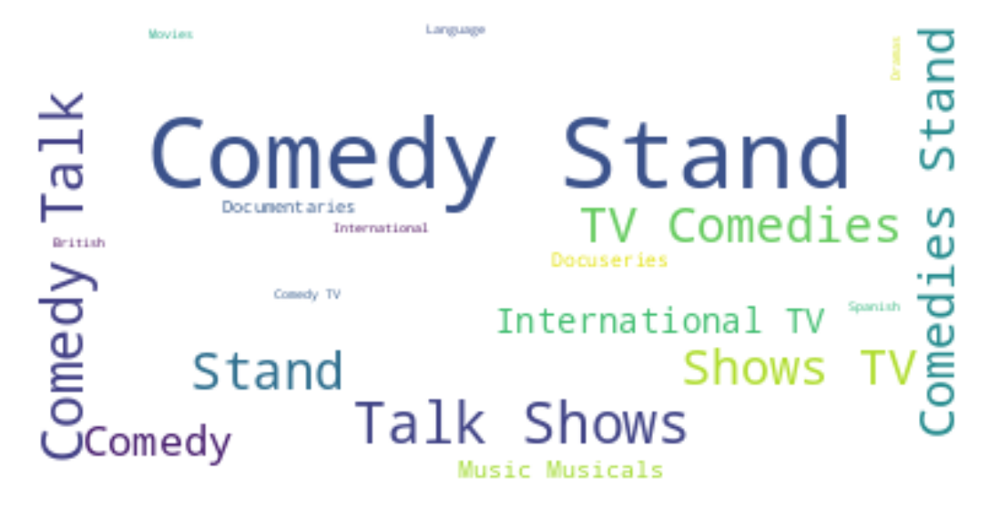

In [ ]:
# Plotting word cloud for cluster 7
col_word_cloud('listed_in', nf_df_clus[nf_df_clus['kmeans_cluster'] == 7])

***Comedy and TV comedy and talk shows***

In [ ]:
nf_df_clus[nf_df_clus['kmeans_cluster'] == 7][['type','title','director','cast','country','rating','listed_in','description']]

,type,title,director,cast,country,rating,listed_in,description
197,TV Show,A Little Help with Carol Burnett,,"Carol Burnett, Russell Peters, Mark Cuban, Tar...",United States,TV-G,"Stand-Up Comedy & Talk Shows, TV Comedies",Comedy icon Carol Burnett returns to TV with a...
220,Movie,A Russell Peters Christmas,Henry Sarwer-Foner,"Russell Peters, Pamela Anderson, Michael Bublé...",Canada,NR,Stand-Up Comedy,"Inspired by the variety shows of the 1970s, ""A..."
305,Movie,Adam Devine: Best Time of Our Lives,Jay Karas,Adam Devine,United States,TV-MA,Stand-Up Comedy,Frenetic comic Adam Devine talks teen awkwardn...
307,Movie,ADAM SANDLER 100% FRESH,Steve Brill,Adam Sandler,United States,TV-MA,Stand-Up Comedy,"From ""Heroes"" to ""Ice Cream Ladies"" – Adam San..."
310,Movie,Adel Karam: Live from Beirut,,Adel Karam,United States,TV-MA,Stand-Up Comedy,"From Casino du Liban, Lebanese actor and comed..."
...,...,...,...,...,...,...,...,...
7718,Movie,Yoo Byung Jae: Discomfort Zone,Y. Joon Chung,Yoo Byung Jae,South Korea,TV-MA,Stand-Up Comedy,Daring comedian Yoo Byung-jae connects critici...
7719,Movie,Yoo Byung Jae: Too Much Information,Yoo Byung-jae,Yoo Byung-jae,,TV-MA,Stand-Up Comedy,"""Saturday Night Live Korea"" writer-turned-come..."
7744,Movie,"Yours Sincerely, Kanan Gill",Neville Shah,Kanan Gill,India,TV-MA,Stand-Up Comedy,Revisiting life goals set in a letter written ...
7757,Movie,Zach Galifianakis: Live at the Purple Onion,Michael Blieden,"Zach Galifianakis, Brian Unger",United States,TV-MA,Stand-Up Comedy,"The unorthodox, piano-playing stand-up star Za..."


Cluster 8 -

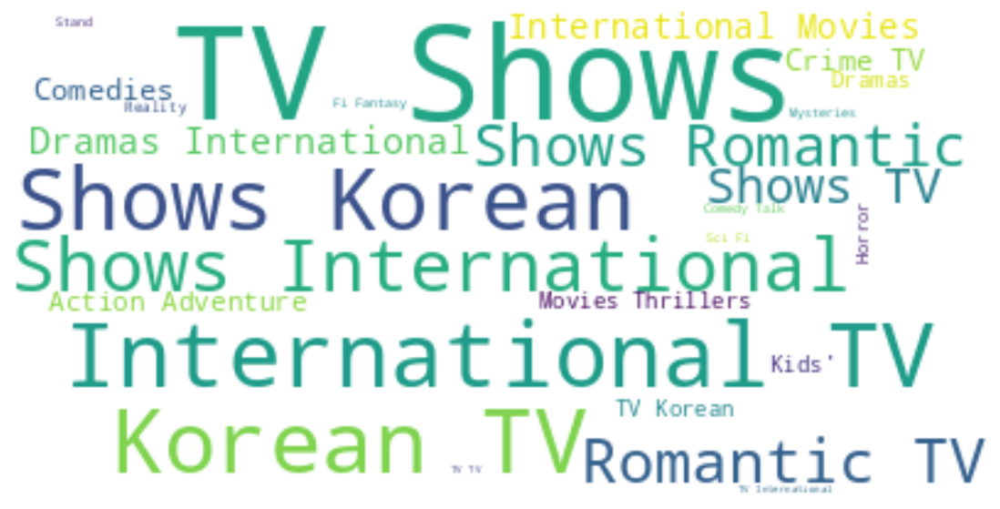

In [ ]:
# Plotting word cloud for cluster 8
col_word_cloud('listed_in', nf_df_clus[nf_df_clus['kmeans_cluster'] == 8])

***Korean shows and movies***

In [ ]:
nf_df_clus[nf_df_clus['kmeans_cluster'] == 8][['type','title','director','cast','country','rating','listed_in','description']]

,type,title,director,cast,country,rating,listed_in,description
51,TV Show,100 Days My Prince,,"Doh Kyung-soo, Nam Ji-hyun, Cho Seong-ha, Cho ...",South Korea,TV-14,"International TV Shows, Romantic TV Shows, TV ...","Upon losing his memory, a crown prince encount..."
61,TV Show,12 Years Promise,,"So-yeon Lee, Namkoong Min, Tae-im Lee, So-hui ...",South Korea,TV-14,"International TV Shows, Korean TV Shows, Roman...",A pregnant teen is forced by her family to lea...
91,Movie,26 Years,Geun-hyun Cho,"Goo Jin, Hye-jin Han, Soo-bin Bae, Seul-ong Im...",South Korea,TV-MA,"Dramas, International Movies, Thrillers",Twenty-six years after the 1980 massacre at Gw...
95,TV Show,28 Moons,,"Jin-sung Yang, Kyu-jong Kim, Tae-hwan Kang, Ge...",South Korea,TV-PG,"International TV Shows, Korean TV Shows, Roman...",When her fiancé acts strangely upon receiving ...
191,TV Show,A Korean Odyssey,,"Lee Seung-gi, Cha Seung-won, Oh Yeon-seo, Lee ...",South Korea,TV-MA,"International TV Shows, Korean TV Shows, Roman...",A self-serving mythical creature's bid for inv...
...,...,...,...,...,...,...,...,...
7551,Movie,What Happened to Mr. Cha?,Kim Dong-kyu,"Cha In-pyo, Cho Dal-hwan, Song Jae-ryong",South Korea,TV-MA,"Comedies, International Movies","With the peak of his career long behind him, a..."
7555,TV Show,What in the World Happened?,,"Eun-mi Go, Jaehyo, Eun-Hyung Jo, Ha-yeon Kim, ...",South Korea,TV-14,"International TV Shows, Korean TV Shows, Roman...",A happy secret romance between a 40-year-old w...
7583,TV Show,When the Camellia Blooms,,"Kong Hyo-jin, Kang Ha-neul, Kim Ji-seok, Oh Ju...",South Korea,TV-14,"International TV Shows, Korean TV Shows, Roman...",Dongbaek is a single mother. When a potential ...
7601,TV Show,White Nights,,"Yo-Won Lee, Goo Jin, U-ie, Hae-in Jung, Gook-h...",South Korea,TV-14,"International TV Shows, Korean TV Shows, TV Dr...","A coldhearted heiress, a man from her past and..."


So, below are the genres in each clusters - 

cluster 0 - Action Adventure, Dramas Independent, Independent movies

cluster 1 - Kids TV, Anime Series

cluster 2 - Comedies, Family Movies, Independent Movies

cluster 3 - International movies, Documentaries international, Movies documentaries

cluster 4 - International movies, Romantic movies

cluster 5 - TV Shows and International TV

cluster 6 - International Movies, Dramas international

cluster 7 - Comedy and TV comedy

cluster 8 - Korean shows and movies

### 2. Hierarchical Clustering

#### Visualizing the dendrogram to decide on the optimal number of clusters for the agglomerative (hierarchical) clustering algorithm:

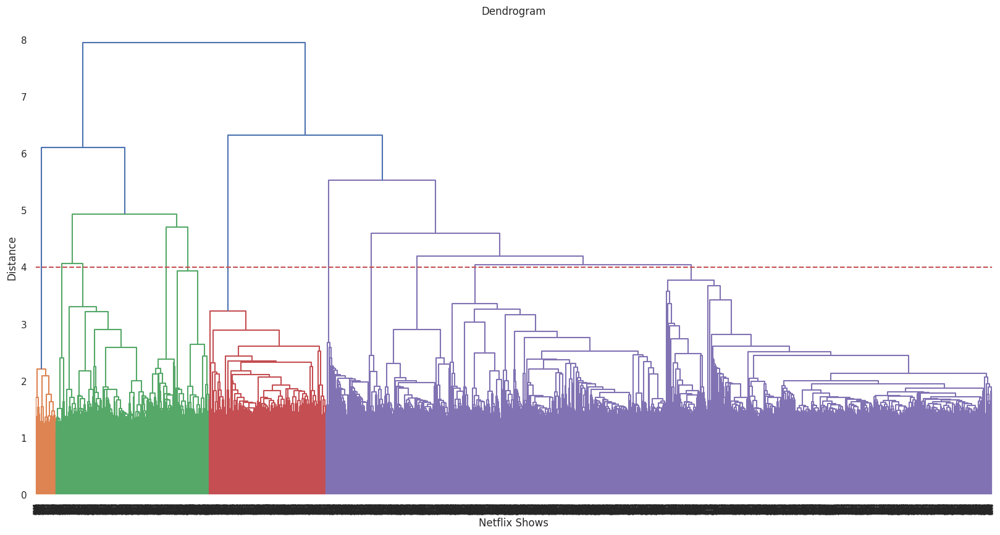

In [ ]:
# Plotting dendogram to decide on the number of clusters
plt.figure(figsize=(20, 10))  
dend = shc.dendrogram(shc.linkage(x_pca, method='ward'))
plt.title('Dendrogram')
plt.xlabel('Netflix Shows')
plt.ylabel('Distance')
plt.axhline(y= 4, color='r', linestyle='--')
plt.show()

At a distance of 4 units, 11 clusters can be built using the agglomerative clustering algorithm.

#### Fitting the model & Visualizing the fit

In [ ]:
# Fitting the hierarchical clustering model
hierarchical = AgglomerativeClustering(n_clusters=11, affinity='euclidean', linkage='ward')  
hierarchical.fit_predict(x_pca)

/usr/local/lib/python3.9/dist-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning:

Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead



array([4, 4, 0, ..., 3, 2, 3])

In [ ]:
#Predicting the labels for clusters.
label_h = hierarchical.fit_predict(x_pca)

/usr/local/lib/python3.9/dist-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning:

Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead



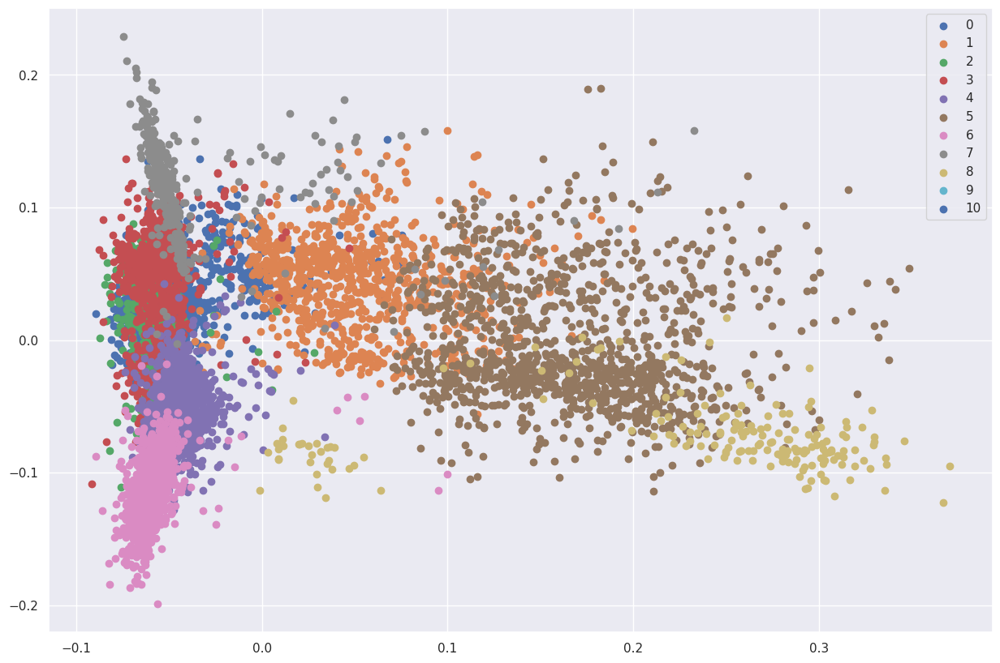

In [ ]:
#Getting unique labels
u_labels_h = np.unique(label_h)
 
#Plotting the clustered labels:
plt.figure(figsize = (15, 10))
for i in u_labels_h:
    plt.scatter(x_pca[label == i , 0] , x_pca[label == i , 1] , label = i)
plt.legend()
plt.show()

We have successfully made 11 clusters through Hierarchical Clustering technique.

In [ ]:
# Adding hierarchical cluster number attribute
nf_df_clus['hierarchical_cluster'] = hierarchical.labels_

In [ ]:
# Checking the head
nf_df_clus.head()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description,clustered_attributes,kmeans_cluster,hierarchical_cluster
0,s1,TV Show,3%,,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,"August 14, 2020",2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...,"[joao, miguel, bianca, comparato, michel, gome...",5,4
1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,"December 23, 2016",2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...,"[jorge, michel, grau, demian, bichir, hector, ...",4,4
2,s3,Movie,23:59,Gilbert Chan,"Tedd Chan, Stella Chung, Henley Hii, Lawrence ...",Singapore,"December 20, 2018",2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow...","[gilbert, chan, tedd, chan, stella, chung, hen...",4,0
3,s4,Movie,9,Shane Acker,"Elijah Wood, John C. Reilly, Jennifer Connelly...",United States,"November 16, 2017",2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi...","[shane, acker, elijah, wood, john, c, reilly, ...",0,1
4,s5,Movie,21,Robert Luketic,"Jim Sturgess, Kevin Spacey, Kate Bosworth, Aar...",United States,"January 1, 2020",2008,PG-13,123 min,Dramas,A brilliant group of students become card-coun...,"[robert, luketic, jim, sturgess, kevin, spacey...",0,1


#### Visualizing the number of TV Show and Movies in each cluster

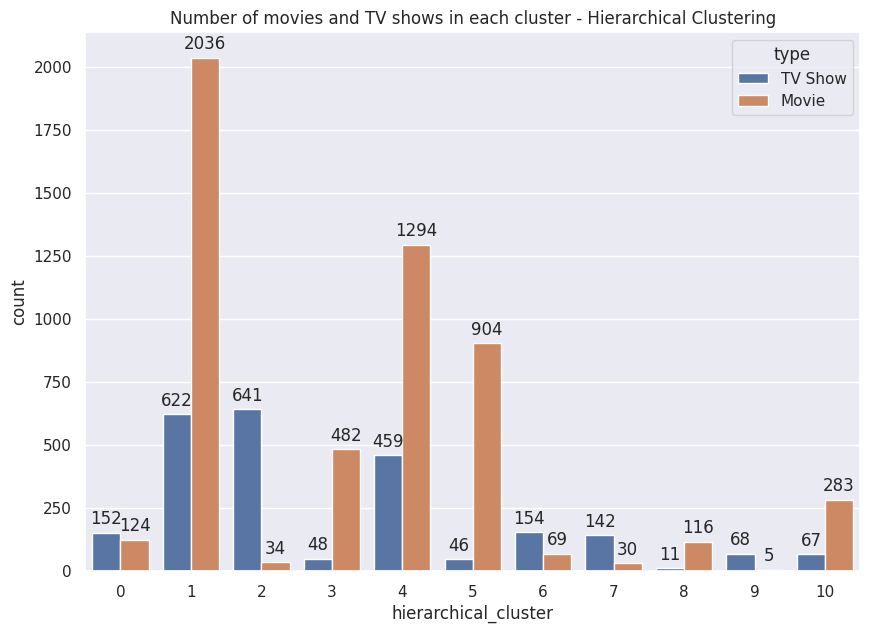

In [ ]:
#Plotting number of TV Show and Movie in each cluster
plt.figure(figsize=(10,7))
plot = sns.countplot(x='hierarchical_cluster',data=nf_df_clus, hue='type')
plt.title('Number of movies and TV shows in each cluster - Hierarchical Clustering')
for i in plot.patches:
  plot.annotate(format(i.get_height(), '.0f'), (i.get_x() + i.get_width() / 2., i.get_height()), ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

#### Plotting the wordcloud for description for each cluster built through hierarchical cluster

Cluster - 0


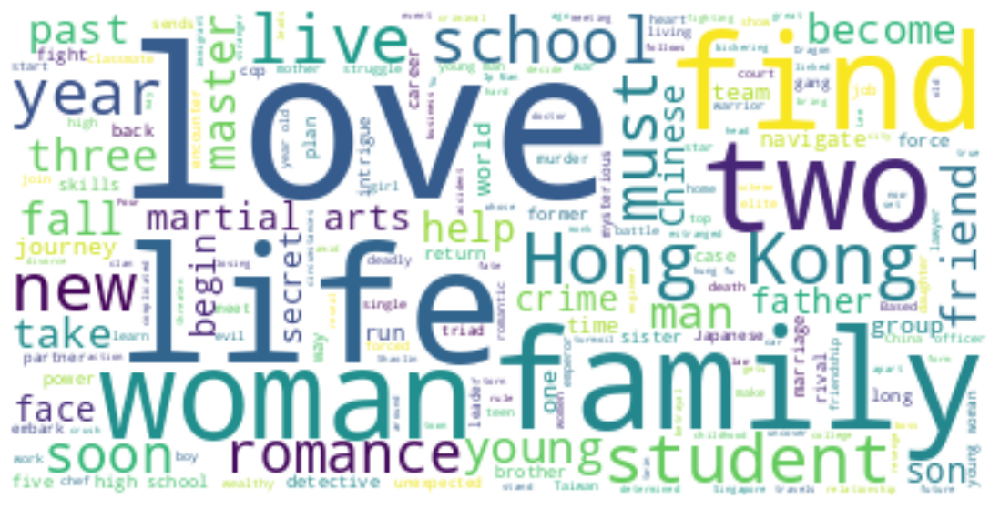



Cluster - 1


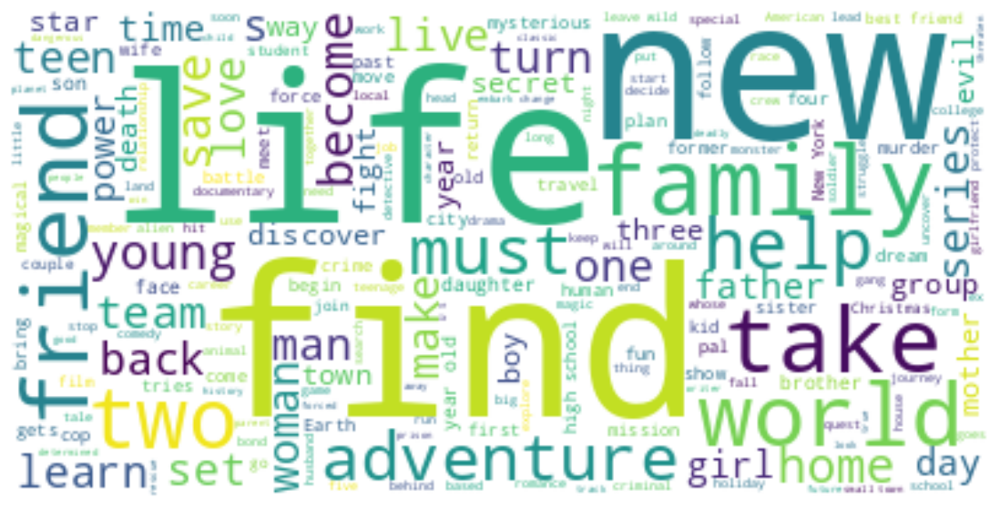



Cluster - 2


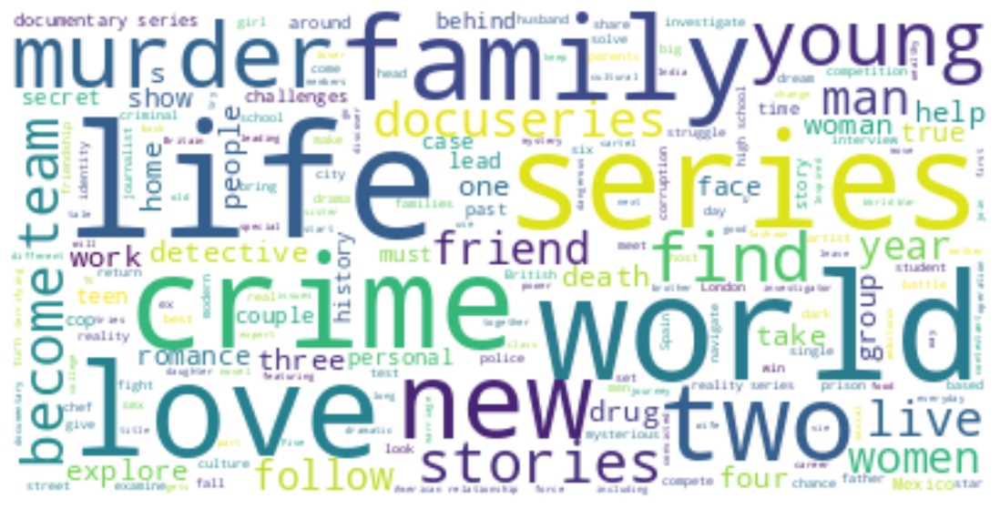



Cluster - 3


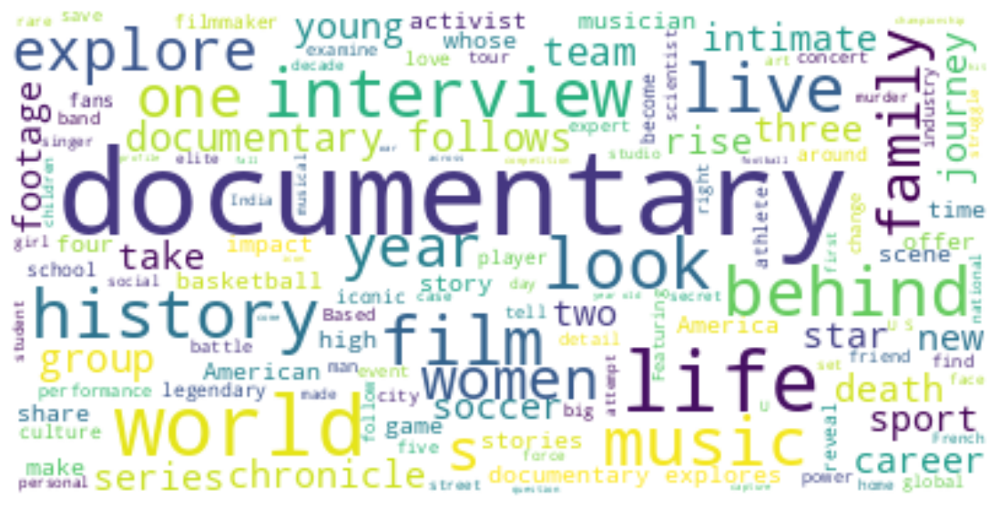



Cluster - 4


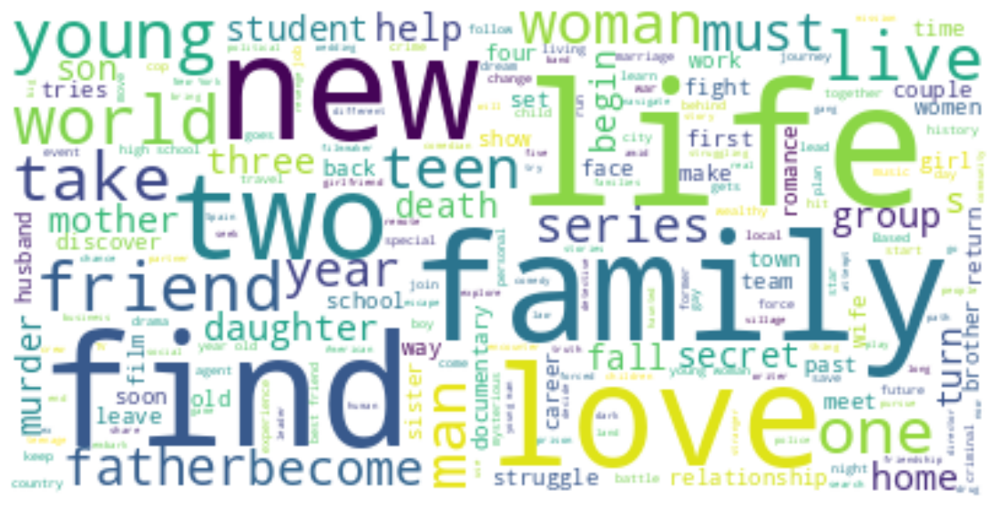



Cluster - 5


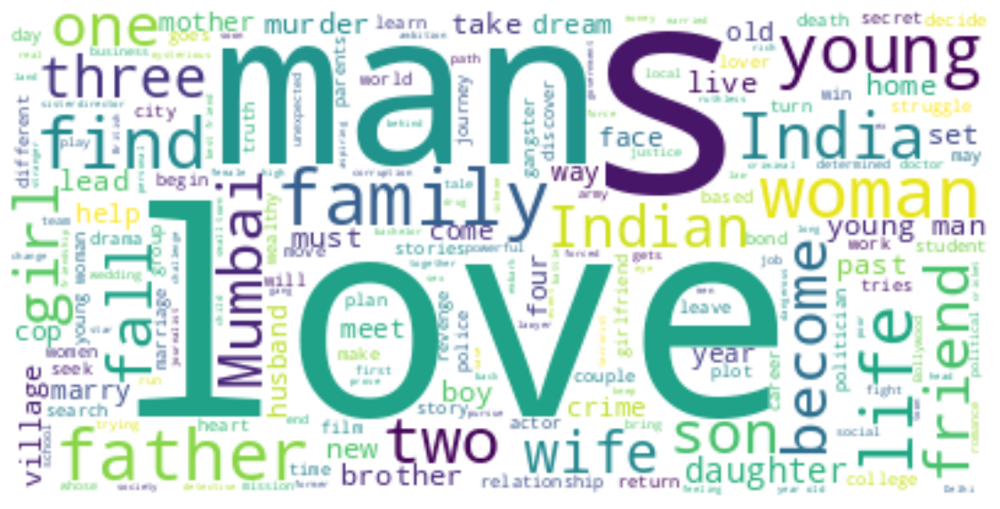



Cluster - 6


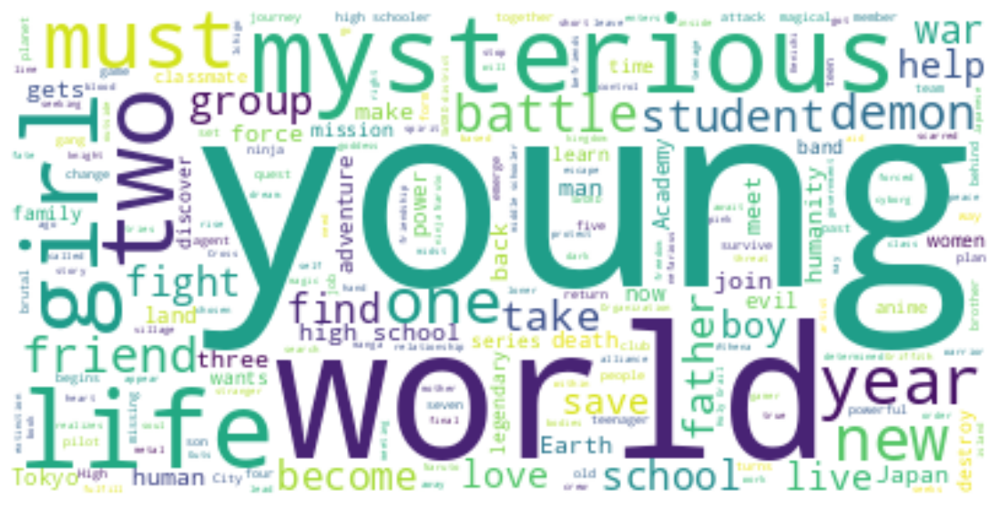



Cluster - 7


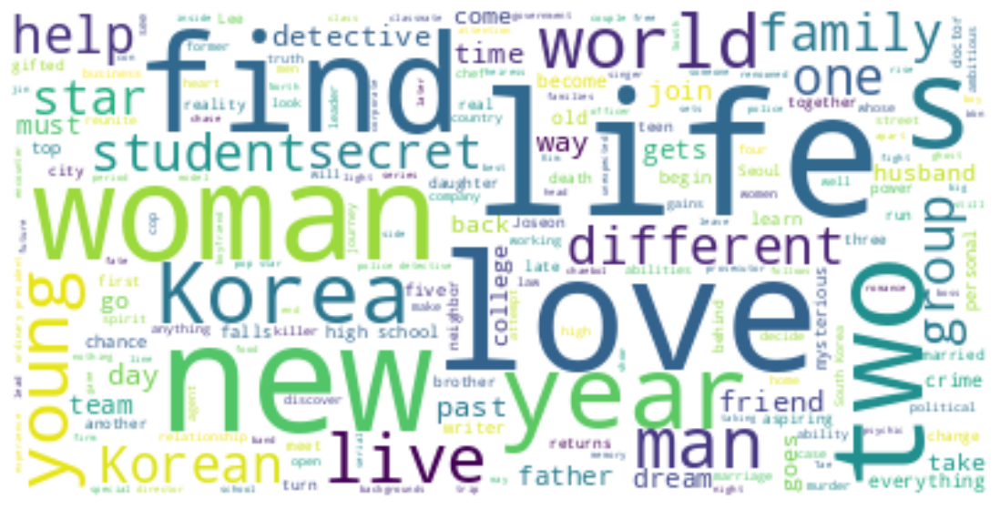



Cluster - 8


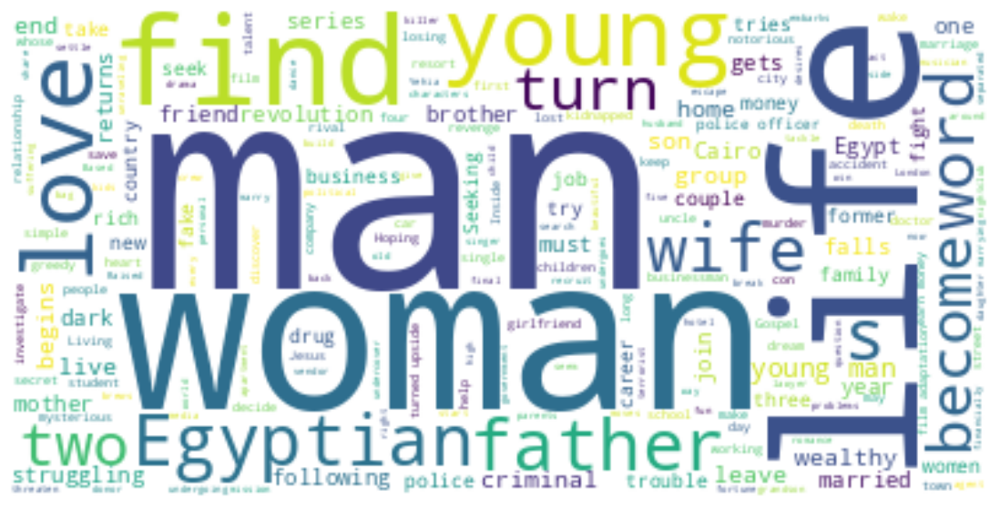



Cluster - 9


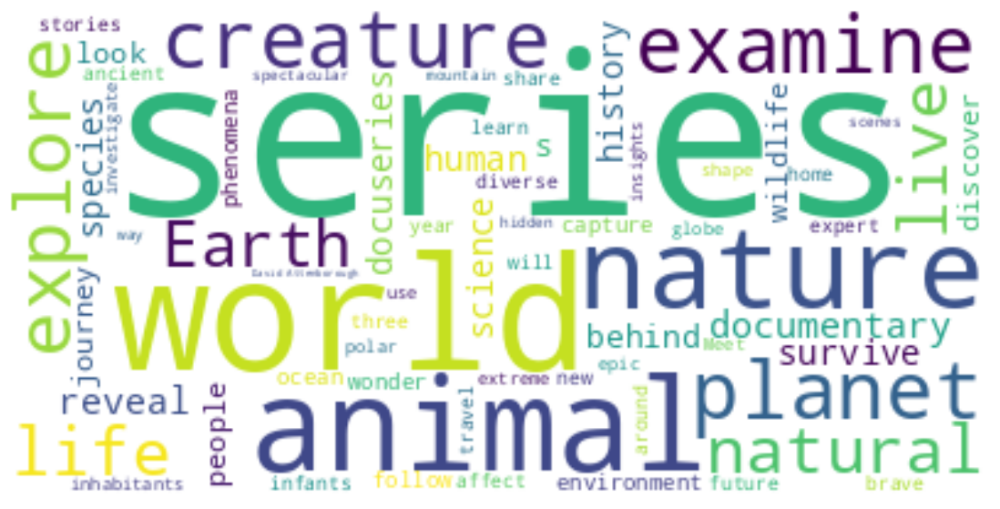



Cluster - 10


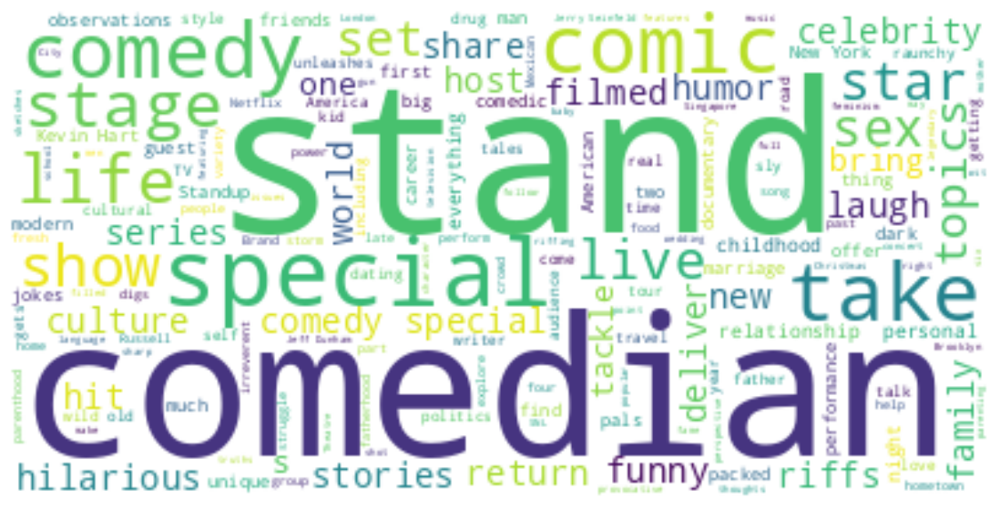

In [ ]:
#Plotting wordclouds for description
for i in range(0, 11):
  print(f'Cluster - {i}')
  col_word_cloud('description', nf_df_clus[nf_df_clus['hierarchical_cluster'] == i])
  print("\n")

Following texts from description are appreaing the most for each clusters -

Cluster 0 - Love, Life

Cluster 1 - Life, find, new

Cluster 2 - crime, series, world, love

Cluster 3 - Documentary

Cluster 4 - family, find, love

Cluster 5 - love, man, family

Cluster 6 - young, mysterious, world

Cluster 7 - life, love, new, women, life

Cluster 8 - Man, woman, egyptian, father

Cluster 9 - series, world, animal, planet

Cluster 10 - comedian, stand

#### Plotting the wordcloud for listed_in/genre for each cluster built through hierarchical cluster

Cluster - 0


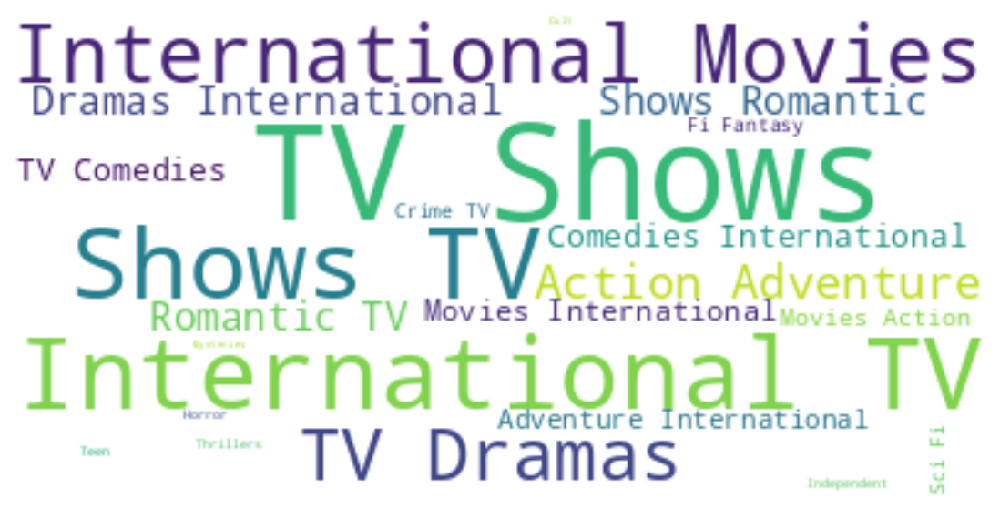



Cluster - 1


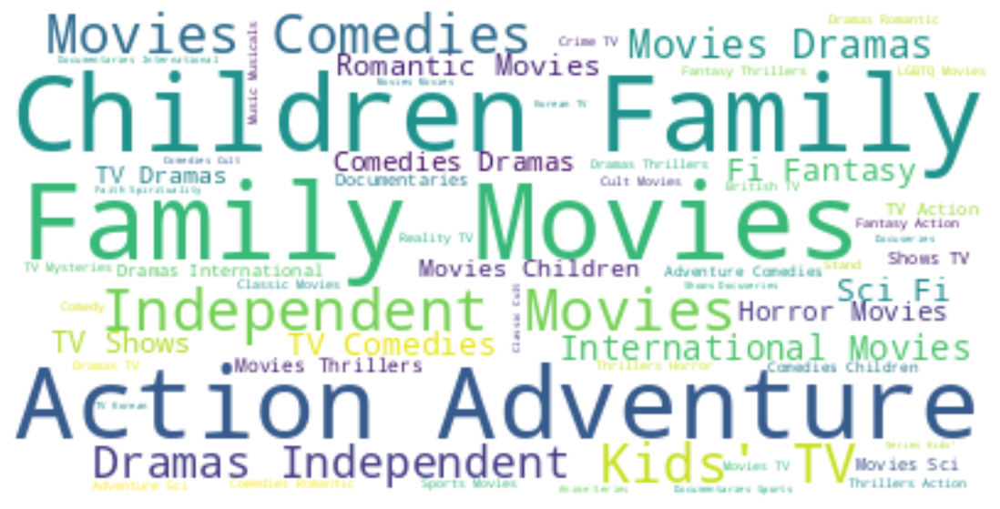



Cluster - 2


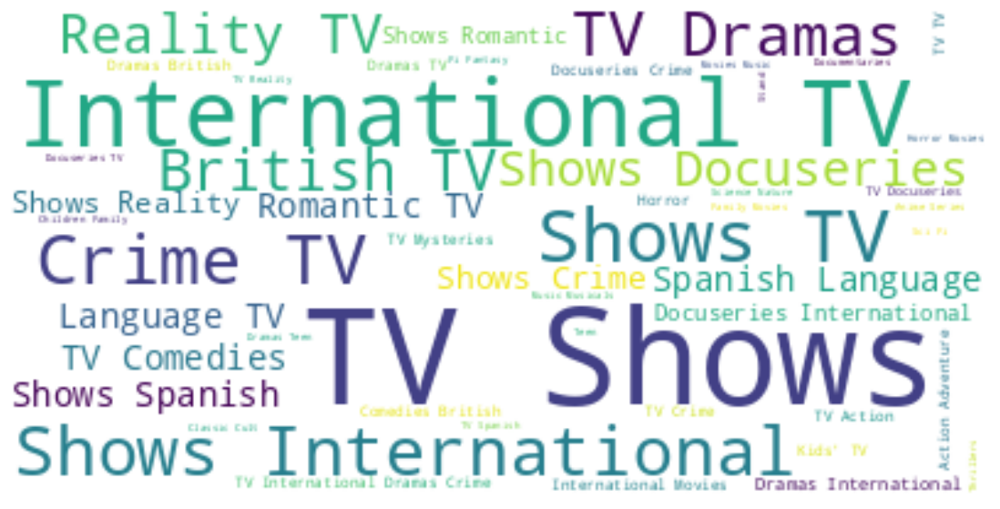



Cluster - 3


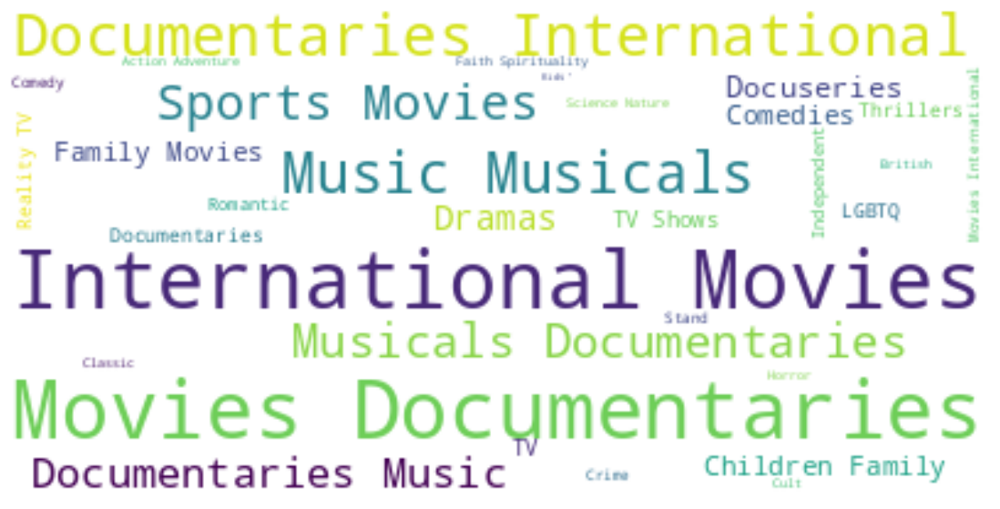



Cluster - 4


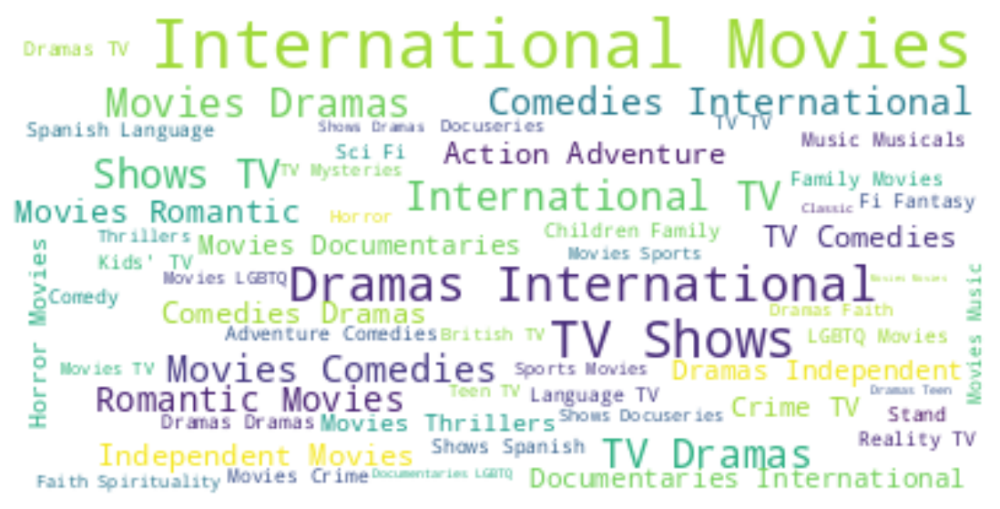



Cluster - 5


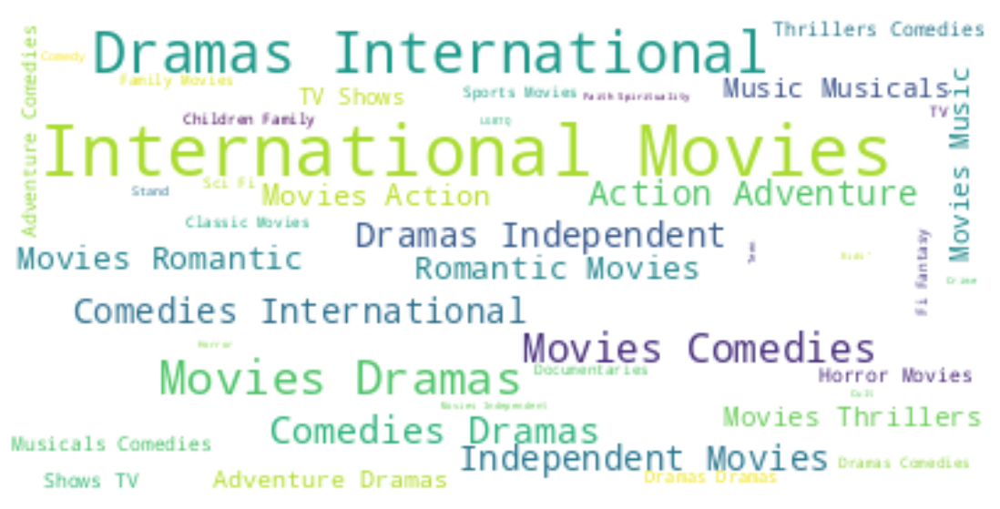



Cluster - 6


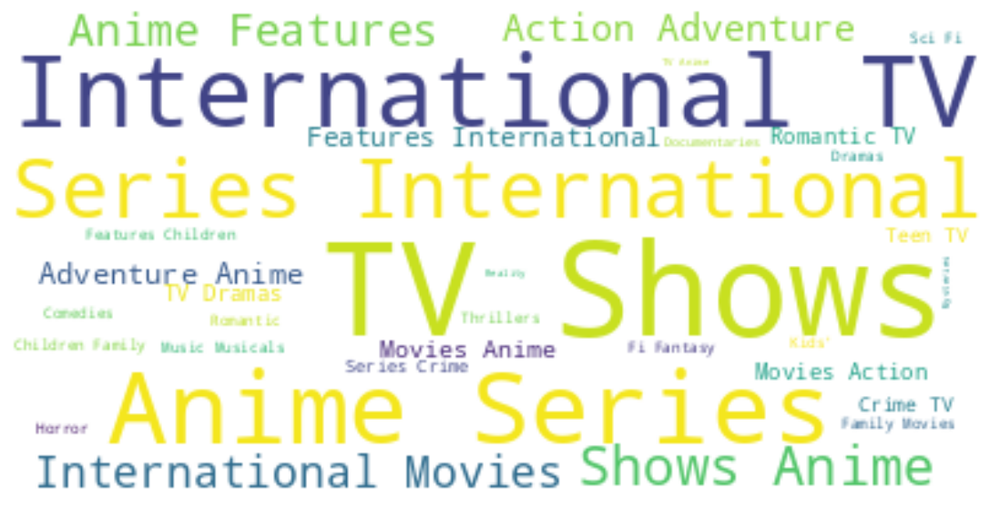



Cluster - 7


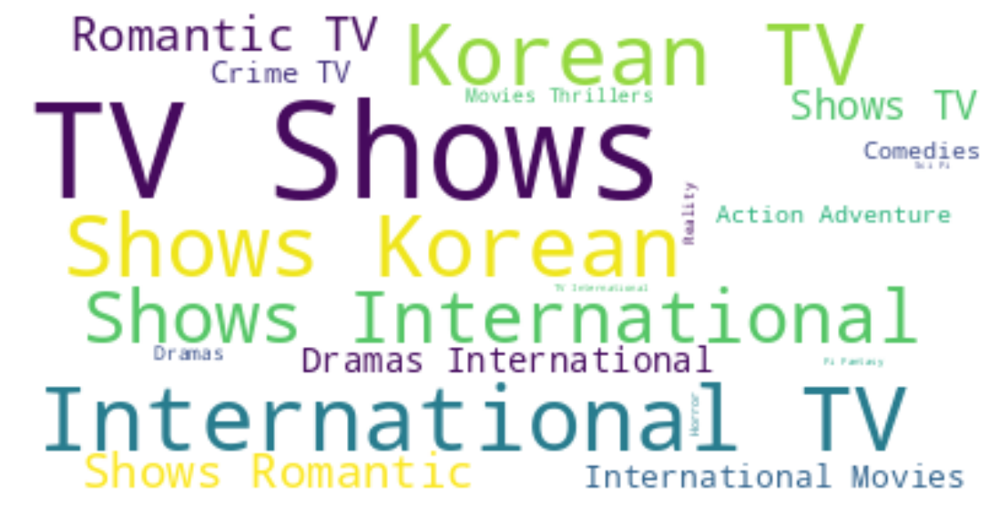



Cluster - 8


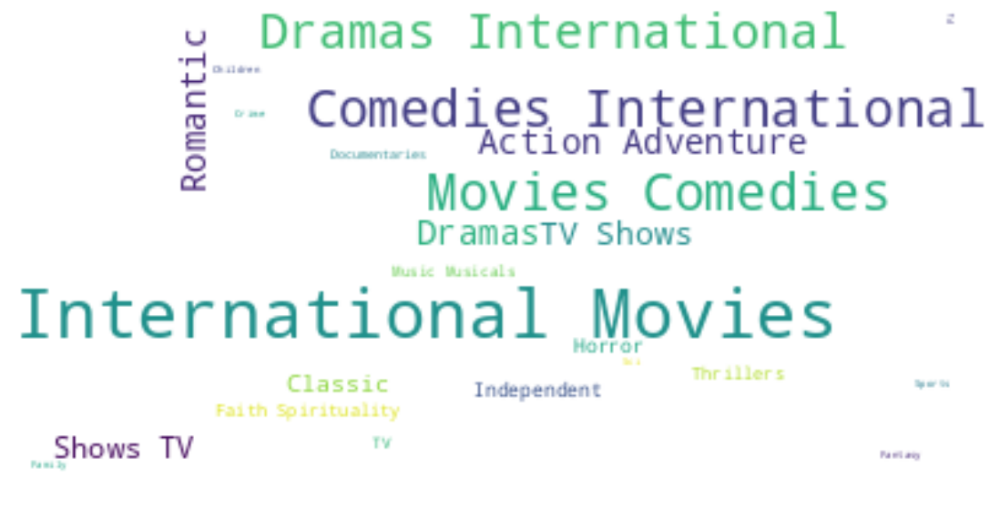



Cluster - 9


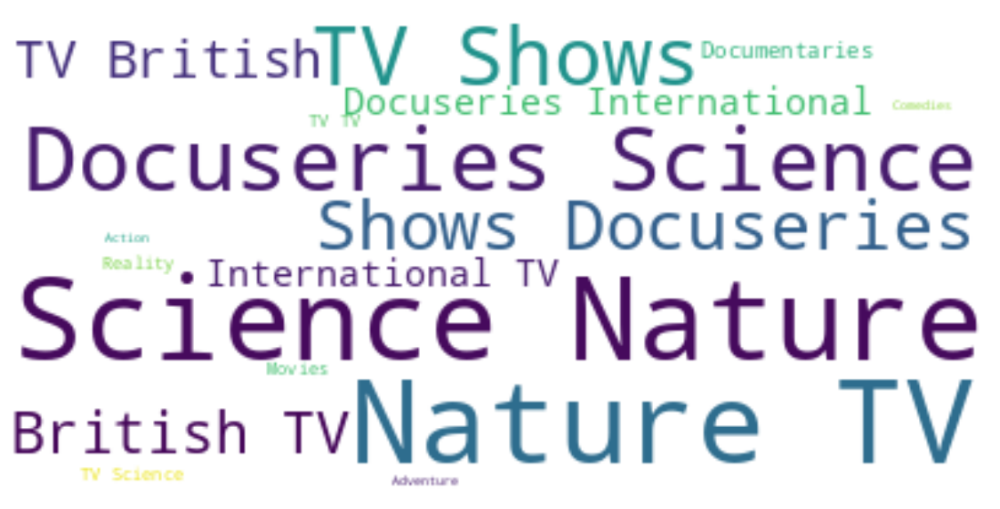



Cluster - 10


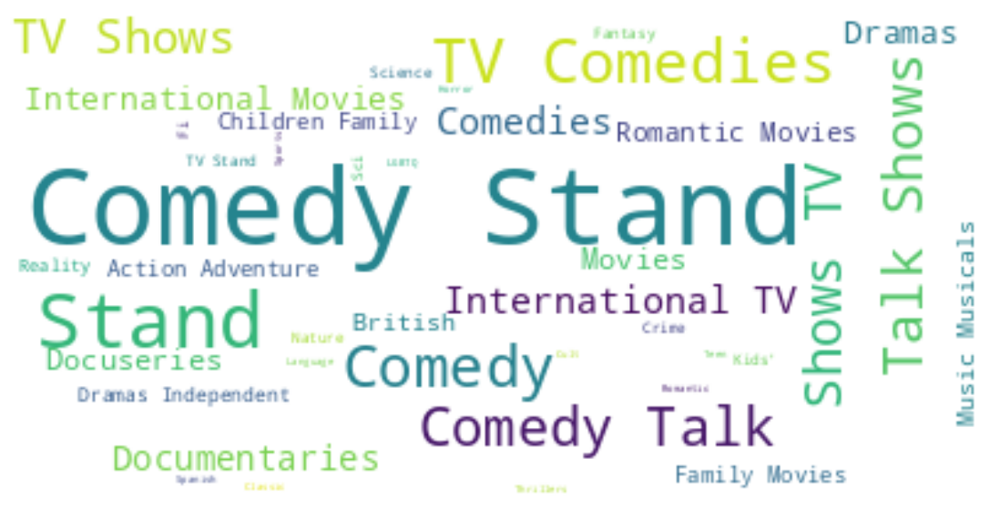

In [ ]:
#Plotting wordclouds for genre
for i in range(0, 11):
  print(f'Cluster - {i}')
  col_word_cloud('listed_in', nf_df_clus[nf_df_clus['hierarchical_cluster'] == i])
  print("\n")

Following texts from listed_in/genre are appreaing the most for each clusters -

Cluster 0 - TV Shows, International TV

Cluster 1 - Children & Family Movies, Action & Adventure

Cluster 2 - TV Shows, International TV

Cluster 3 - Movies documentaries

Cluster 4 - International Movies, Romantic movies

Cluster 5 - International Movies, Dramas International

Cluster 6 - International TV shows, Anime series

Cluster 7 - Korean TV Shows, International TV Shows

Cluster 8 - International Movies, Comedies

Cluster 9 - nature, science, docuseries science

Cluster 10 - Standup-Comedy, Talk shows

## ***7.*** ***Content Based Recommender System***

* We can build a simple content based recommender system based on similarity of the shows.
* If a person has watched a show on Netflix, the recommender system must be able to recommend a list of similar shows that he/she likes.
* To get the similarity score of the shows, we can use cosine similarity.
* The similarity between two vectors (A and B) is calculated by taking the dot product of the two vectors and dividing it by the magnitude value as shown in the equation below. We can simply say that the CS score of two vectors increases as the angle between them decreases.

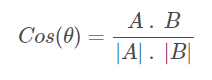

In [ ]:
#Creating a new dfDataFrame for building a recommender system
nf_df_recommendation = nf_df_clus.copy()

In [ ]:
#Removing s from the show id
nf_df_recommendation['show_id'] = nf_df_recommendation['show_id'].str.replace("s","")
nf_df_recommendation['show_id'] = nf_df_recommendation['show_id'].astype(str).astype(int)

In [ ]:
#Converting tokens to string
def join_words(words_list):
  return ' '.join(words_list)

nf_df_recommendation['clustered_attributes'] = nf_df_recommendation['clustered_attributes'].apply(lambda x: join_words(x))

In [ ]:
#Setting title of movies/Tv shows as index
nf_df_recommendation.set_index('title',inplace=True)

In [ ]:
#Count vectorizer
CV = CountVectorizer()
converted_matrix = CV.fit_transform(nf_df_recommendation['clustered_attributes'])

In [ ]:
#Cosine similarity
cosine_similarity = cosine_similarity(converted_matrix)

In [ ]:
# Developing a function to get 10 recommendations for a show
indices = pd.Series(nf_df_recommendation.index)

def recommend_10(title, cosine_sim = cosine_similarity):
  try:
    recommend_content = []   
    idex = indices[indices == title].index[0]
    series = pd.Series(cosine_sim[idex]).sort_values(ascending = False)
    top10 = list(series.iloc[1:11].index)
    # list with the titles of the best 10 matching movies
    for i in top10:
      recommend_content.append(list(nf_df_recommendation.index)[i])
    print(f"Since you liked {title}, you will also like:\n")
    return recommend_content

  except:
    return (f'Please enter correct title. Title {title} is not present on Netflix')

In [ ]:
#Recommendation for "Zulu Man in Japan"
recommend_10("Zulu Man in Japan")

Since you liked Zulu Man in Japan, you will also like:



['Roots',
 'We Are One',
 'Emicida: AmarElo - It’s All For Yesterday',
 'Numero Zero. The Roots of Italian Rap',
 'Wandering Stars',
 'Tokyo Idols',
 'Amandla! A Revolution in Four Part Harmony',
 'Highly Strung',
 'Hope: One in a Billion',
 'Palio']

In [ ]:
#Recommendation for "13 Sins"
recommend_10("13 Sins")

Since you liked 13 Sins, you will also like:



['Awake: The Million Dollar Game',
 'Carriers',
 'Creep 2',
 'The Titan',
 'Creep',
 "He's Out There",
 'Harry and Snowman',
 'I Am the Pretty Thing That Lives in the House',
 'Would You Rather',
 'Paranormal Investigation']

In [ ]:
#Recommendation for "3 Idiots"
recommend_10("3 Idiots")

Since you liked 3 Idiots, you will also like:



['PK',
 'Ek Main Aur Ekk Tu',
 'Rang De Basanti',
 'Dil Chahta Hai',
 'No Entry',
 'War Chhod Na Yaar',
 'Dil Dhadakne Do',
 'Kacche Dhaagey',
 'Sanju',
 'Kai Po Che!']

In [ ]:
#Recommendation for "Stranger Things"
recommend_10("Stranger Things")

Since you liked Stranger Things, you will also like:



['Beyond Stranger Things',
 'Prank Encounters',
 'The Umbrella Academy',
 'Haunted',
 'Scream',
 'Warrior Nun',
 'The Sinner',
 'Kiss Me First',
 'Nightflyers',
 'Zombie Dumb']

In [ ]:
#Recommendation for "Naruto"
recommend_10("Naruto")

Since you liked Naruto, you will also like:



['Naruto Shippuden : Blood Prison',
 'Naruto Shippûden the Movie: Bonds',
 'Naruto Shippuden: The Movie',
 'Naruto the Movie 2: Legend of the Stone of Gelel',
 'Saint Seiya: The Lost Canvas',
 'Naruto Shippûden the Movie: The Will of Fire',
 'Naruto the Movie 3: Guardians of the Crescent Moon Kingdom',
 'Pop Team Epic',
 "Dragon's Dogma",
 'Beyblade: Metal Fusion']

# **Conclusion**

* We have successfully implemented Unsupervised Machine learning algorithm where we have clustered the data on Netflix dataset. We have divided the dataset into several clusters.
* There are 7787 rows and 12 columns in the dataset.
* We performed data cleaning and EDA. From EDA we have following observations -
    * In the dataset around 69% of Movie is present and 31% of TV Show is present.
    * Christmas, World, Love, Man are some of the most words in the title.
    * US, India & UK are having the most production.
    * The majority of the shows on Netflix are for adults and for children above age 14.
    * International movies are having the highest count in the dataset.
    * Description of TV Shows contains more words like world, life, family, new, find, love etc. 
    * Description of Movie also contains more words like life, find, family, love etc similar to TV Shows.
* We found that over the years, Netflix has consistently focused on adding more shows in its platform. There is a decrease in number of movies added in the year 2020 as compared to year 2019 whereas the number of TV Shows have increased from 656 to 697 from year 2019 to year 2020.
* Number of TV Shows have increased more than 3 times also number of movies are increasing on year basis.
* We clustered the data based on the features - director, cast, country, genre, and description. The values in these attributes were tokenized, preprocessed, and then vectorized using TFIDF vectorizer.
* Through TFIDF Vectorization, we created a total of 20000 attributes.
* We used Principal Component Analysis (PCA) to handle the curse of dimensionality. 4000 components were able to capture more than 80% of variance, and hence, the number of components were restricted to 4000. 
* We have first used K-Means clustering for clustering the data. We used elbow method & Silhouette method to get the optimal value of k. With the optimal k as 9 from Silhouette score we have clusterred the data into 9 clusters.
* Then we have made the clusters using Agglomerative Hierarchical method where we have divided the dataset into 11 clusters after visualizing the dendogram.
* In the last a content based recommender system was built using cosine similarity. This system will recommend 10 shows/movies based on your current liking.